# Reinforcement Learning Programming - CSCN8020
# Tessa Ayvazoglu
# 21/07/2024
# ============================================================================================

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objects as go
import matplotlib.pyplot as plt

import os

In [3]:
# Load dataframe
nvda_df1 = pd.read_csv(r'C:\Users\Admin\Documents\MLAI\CSCN8020RL\reinforcement_learning\FinalProject\NVDA_data.csv')

# Convert 'Date' column to datetime
nvda_df1['Date'] = pd.to_datetime(nvda_df1['Date'])

# Set 'Date' as index
nvda_df1 = nvda_df1.set_index('Date')

# Filter for July and August 2024
nvda_df = nvda_df1.loc['2024-07-01':'2024-08-31']

# Print or save the filtered dataframe to check
print(nvda_df.head())
nvda_df.to_csv('NVDA_data_filtered_July_August_2024.csv')

                  Open        High         Low       Close   Adj Close   
Date                                                                     
2024-07-01  123.470001  124.839996  118.830002  124.300003  124.300003  \
2024-07-02  121.129997  123.410004  121.029999  122.669998  122.669998   
2024-07-03  121.660004  128.279999  121.360001  128.279999  128.279999   
2024-07-05  127.379997  128.850006  125.680000  125.830002  125.830002   
2024-07-08  127.489998  130.770004  127.040001  128.199997  128.199997   

               Volume  
Date                   
2024-07-01  284885500  
2024-07-02  218374000  
2024-07-03  215749000  
2024-07-05  214176700  
2024-07-08  237677300  


In [4]:
# Show head of the dataframe
nvda_df.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2024-07-01,123.470001,124.839996,118.830002,124.300003,124.300003,284885500
2024-07-02,121.129997,123.410004,121.029999,122.669998,122.669998,218374000
2024-07-03,121.660004,128.279999,121.360001,128.279999,128.279999,215749000
2024-07-05,127.379997,128.850006,125.680000,125.830002,125.830002,214176700
2024-07-08,127.489998,130.770004,127.040001,128.199997,128.199997,237677300


In [5]:
#imports
import datetime

#Agent Class
class RL_Agent:
    
    def __init__(self, data, sarsa = False, state_size = None, window_size = 5, alpha = 0.8, gamma = 0.1, epsilon = 0.3, beta = 0.4, assets = 100_000, policy = "greedy", seed = 24):
#         assert window_size >= 50, 'window_size should be at least of size 50' # This line can be commented if you don't need to vizualize the stocks
        assert policy in ["greedy", "egreedy", "softmax"], "policy is invalid, please give the following input rl = RL_agent(...,policy=\"greedy OR egreedy OR softmax\")"
        np.random.seed(seed)
        self.actions = ["buy", "sell", "hold"]
        self.window_size = window_size
        self.sarsa = sarsa
        self.assets = assets
        self.base_assets = assets 
        self.previous_assets = assets
        self.policy = policy
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma
        self.epsilon = epsilon
        if(policy == "greedy"):
            self.epsilon = 0
        self.data = data
        self.curr_date = self.data.first_valid_index()
        self.previous_inventory = {}
        self.inventory = {}
        self.q_table = np.zeros(shape=(self.window_size,3,2)) # [State, action, increasing_trend]
        self.skipped_days = 0 # This variable is needed for the indexing and should be resetted for every simulation/experiment
        self.punish = False
        self.actions = np.asarray(["buy", "sell", "hold"], dtype=str)
        
    
    def reset(self):
        """
        Reset the following class variables:
        * self.inventory
        * self.previous inventory
        * self.skipped_days
        * self.assets
        * self.previous_assets
        """
        self.inventory = {}
        self.previous_inventory = {}
        self.skipped_days = 0
        self.curr_date = self.data.first_valid_index()
        self.assets = self.base_assets
        self.previous_assets = self.base_assets
        
        
    
    def check_date_validity(self):
        """
        Check whether the current date exists in the stock market data
        """
        return self.curr_date in self.data.index
    
    def stock_history_idx(self):
        """
        Get the date as an index 
        """
        return (self.curr_date-self.data.first_valid_index()).days-self.skipped_days
    
    
    def visualize_data(self):
        """
        Visualize the stock market as a japenese candlestick chart 
        """
        x = self.data.index
        stock_chart = {
            'x': x[:self.window_size],
            'open': self.data.Open,
            'close': self.data.Close,
            'high': self.data.High,
            'low': self.data.Low,
            'type': 'candlestick',
            'name': 'AMZN',
            'showlegend': True
        }
        # Calculate and define moving average of 50 periods
        avg_30 = self.data.Close.rolling(window=30, min_periods=1).mean()

        # Calculate and define moving average of 100 periods
        avg_50 = self.data.Close.rolling(window=50, min_periods=1).mean()

        average_30_days = {
            'x': x[:self.window_size],
            'y': avg_30,
            'type': 'scatter',
            'mode': 'lines',
            'line': {
                'width': 1,
                'color': 'blue'
                    },
            'name': 'Moving Average of 30 periods'
        }

        average_50_days = {
            'x': x[:self.window_size],
            'y': avg_50,
            'type': 'scatter',
            'mode': 'lines',
            'line': {
                'width': 1,
                'color': 'red'
            },
            'name': 'Moving Average of 100 periods'
        }

        data = [stock_chart, average_30_days, average_50_days]
        # Config graph layout
        layout = go.Layout({
            'title': {
                'text': 'Apple(NVDA) Moving Averages',
                'font': {
                    'size': 15
                }
            }
        })

        fig = go.Figure(data=data, layout=layout)
        iplot(data, filename='nvda_stock_chart')
        
        
    def print_inventory(self):
        """
        Display the current contents of the inventory
        """
        if self.inventory:
            print(self.inventory)
        else:
            print('The inventory is empty, please buy a stock before calling this function.')
    
    
    def value_of_inventory(self, inventory):
        """
        Calculate the net worth of the inventory
        """
        if 'AMZN' not in self.inventory:
            return 0
        else:
            return self.inventory['NVDA'] * self.get_stock_price()
        
        
    def liquidity_value(self):
        """
        Calculate the liqudity value of the agent, which is:
        assets + inventory net worth
        """
        if 'AMZN' in self.inventory:
            return self.value_of_inventory(self.inventory) + self.assets
        else:
            return self.assets
    
    
    def previous_liquidity_value(self):
        """
        Calculate previous liquidity value
        """
        return self.value_of_inventory(self.previous_inventory) + self.previous_assets
        
    
    def add_to_inventory(self, amount):
        """
        Given some amount add that amount of stocks to the inventory
        """
        if not self.inventory:
            self.inventory['NVDA'] = 0
        self.inventory['NVDA'] += amount
        
        
    def remove_from_inventory(self, amount):
        """
        Given some amount remove that amount of stocks from the inventory
        """
        assert self.inventory, "The inventory is empty, please buy a stock before calling this function."
        self.inventory['NVDA'] -= amount
        
    
    def get_stock_price(self):
        """
        Get the stock price of NVDA given self.current_date
        """
        select_row = self.data.loc[self.data.index == self.curr_date]
        price = np.round(float(select_row.Close[0]),2)
        return price
    
    
    def increasing_trend(self, last_stock_price):
        """
        If the stock price of today is higher than the stock price than yesterday return true
        """
        return self.get_stock_price() > last_stock_price
    
    
    def buy(self):
        """
        Performs the buy operations:
        * Calculate how much stocks you can buy
        * Remove money from assets
        * Add stocks to inventory
        """
        amount = int(self.assets/self.get_stock_price())
        self.assets -= self.get_stock_price()*amount
        self.add_to_inventory(amount)

    
    def sell(self):
        """
        Performs sell operations:
        * Calculate how much stocks you can sell
        * Add money to assets
        * Remove stocks from inventory
        """
        amount = self.inventory['NVDA']
        self.assets += self.get_stock_price()*amount
        self.remove_from_inventory(amount)
    
    
    def hold(self):
        """
        Do nothing.(Placeholder function)
        """
        pass 
        
    
    def get_reward(self, increasing_trend):
        """
        Calculate reward
        If self self.punish:
            Reward = 1
        Else:
            Calculate reward based on how long the agent holds the stock.
            Holding without selling for too long can be risky, thus the reward decreases overtime from holding.
        """
        trend_factor = 0.95
        if not increasing_trend:
            trend_factor = 1
        if self.punish:
            return -1
        return (self.liquidity_value()-self.previous_liquidity_value())/self.previous_liquidity_value() * trend_factor
    
    
    def step(self, action):
        """
        Transition function which takes an action as input and return the next state
        """
        self.previous_inventory = self.inventory
        if action == "buy":
            self.buy()
        elif action == "sell" and self.inventory and self.inventory['NVDA'] > 0:
            self.sell()
        else:
            self.hold()
        while True:
            self.curr_date += pd.Timedelta(days=1)
            if(self.check_date_validity()):
                break
            else:
                self.skipped_days += 1
    
    
    def run_policy(self, previous_stock_price):
        """
        Policy function for the 3 different policies:
        * e-greedy
        * greedy
        * soft-max
        """
        action = "hold"
        self.punish = False
        if self.policy == "greedy" or self.policy == "egreedy":
                    if np.random.random() < self.epsilon:
                        action = np.random.choice(self.actions, size = 1)[0]
                    else:
                        choices = np.array(self.q_table[self.stock_history_idx(),:,int(self.increasing_trend(previous_stock_price))] == np.max(self.q_table[self.stock_history_idx(),:, int(self.increasing_trend(previous_stock_price))]))
                        action = str(np.random.choice(self.actions[choices.flatten()]))
        elif self.policy == 'softmax':
            pvals = np.exp(self.beta*self.q_table[self.stock_history_idx(),:, int(self.increasing_trend(previous_stock_price))])/np.sum(np.exp(self.beta*self.q_table[self.stock_history_idx(),:, int(self.increasing_trend(previous_stock_price))]))
            action = np.random.choice(self.actions,size = 1, p = pvals.flatten())         
                
        if (action == "sell" and (not self.inventory or self.inventory['NVDA'] == 0)) or (action == "buy" and self.assets < self.get_stock_price()):
            # Agent must learn that trying to sell stocks that don't exist or buying stocks is bad practice and should therefore be severely punished
            self.punish = True
        return action
            
    def simulate(self):
        """
        Main function of this class, which performs a policy until max sessions has been reached.
        Returns: sum of rewards, slope, intercept, gains
        Also plots a graph of the performance
        """
        
        gains = []
        rewards = []
        i = 0
        prev_action_idx = 2
        max_sessions = 200
        previous_stock_price = self.get_stock_price()
        previous_increase_trend = False
        
        while i < max_sessions:
            reward_sum = 0
            i += 1
            while(self.stock_history_idx() < self.window_size - 1):
                trend_increase = self.increasing_trend(previous_stock_price)
                inventory = self.inventory
                assets = self.assets
                action = self.run_policy(previous_stock_price)
                next_state = self.step(action)    
                reward = self.get_reward(trend_increase)
                action_idx = int(np.where(self.actions == action)[0])
                reward_sum += reward
        
                if self.sarsa:
                    self.q_table[self.stock_history_idx() - 1, prev_action_idx, int(previous_increase_trend)] = self.q_table[self.stock_history_idx()-1, prev_action_idx, int(previous_increase_trend)] + self.alpha * (reward + self.gamma * self.q_table[self.stock_history_idx(),action_idx, int(self.increasing_trend(previous_stock_price))] - self.q_table[self.stock_history_idx() - 1, prev_action_idx, int(previous_increase_trend)])
                else:
                    self.q_table[self.stock_history_idx() - 1, prev_action_idx, int(previous_increase_trend)] = self.q_table[self.stock_history_idx()-1, prev_action_idx, int(previous_increase_trend)] + self.alpha * (reward + self.gamma * np.max(self.q_table[self.stock_history_idx(),:, int(self.increasing_trend(previous_stock_price))]) - self.q_table[self.stock_history_idx() - 1, prev_action_idx, int(previous_increase_trend)])
                
                previous_increase_trend = self.increasing_trend(previous_stock_price)
                previous_stock_price = self.get_stock_price()
                prev_action_idx = action_idx
            gains.append(self.liquidity_value() - self.base_assets)
            rewards.append(reward_sum)
            self.reset()
        plt.figure(figsize=(15,10))
        x = np.asarray([i for i in range(len(gains))],dtype=int)
        y = gains
        m, b = np.polyfit(x, y, 1)
        rl_method = "Q_learning"
        if self.sarsa:
            rl_method = "SARSA"
        plt.title(f"{rl_method}: Results from simulating {max_sessions} sessions using {self.policy} as policy, \n with window_size = {self.window_size}, alpha = {self.alpha}, beta = {self.beta}, gamma = {self.gamma}, epsilon = {self.epsilon}", fontsize=16)
        plt.xlabel("Episodes", fontsize=14)
        plt.ylabel("Money gained in dollars", fontsize=14)
        plt.plot(x, y, 'o', label="True gain")
        plt.plot(x, m*x + b, label="Regression fit / Expected gain")
        plt.legend(title=f'Regression slope = {np.round(m,5)}')
        plt.show()
        return rewards, gains, m, b

In [6]:
# data_window, the amount of days the agent is able to trade
data_window = nvda_df['2023-08-01':]


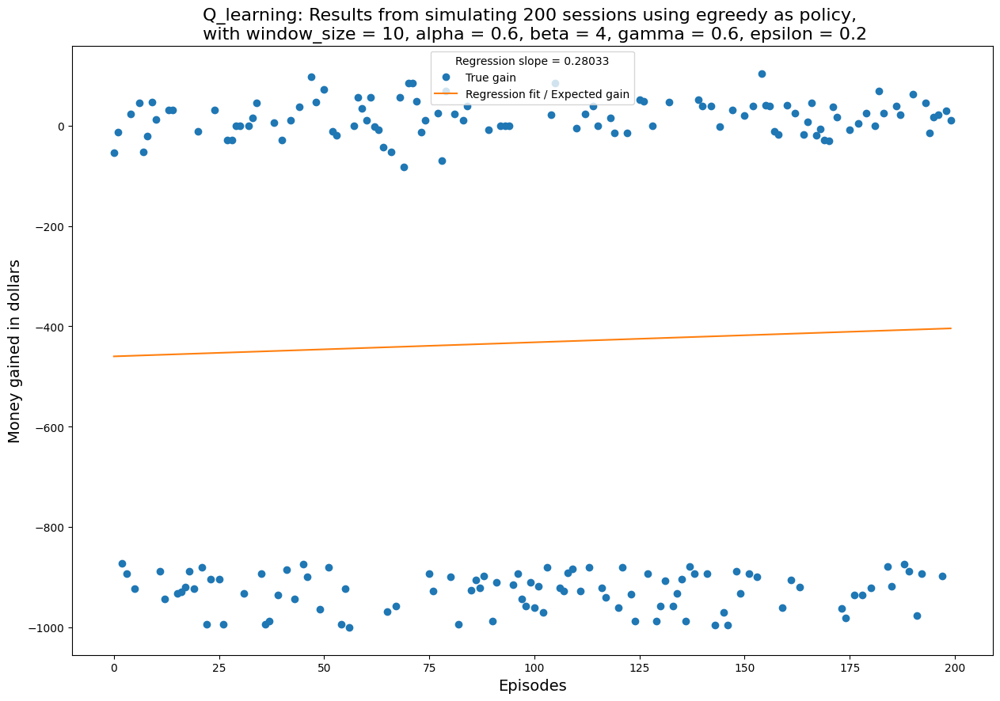

In [7]:
# Create RL_AGENT
rl_agent = RL_Agent(alpha = 0.6, gamma = 0.6, epsilon = 0.2, beta=4, sarsa=False, data=data_window, assets=1000 , policy="egreedy", window_size = 10)
# The line below can be used to peform a simulation
rewards, gains, m, b = rl_agent.simulate()


## Evaluation of Q-Learning


### Softmax policy

#### Beta parameter


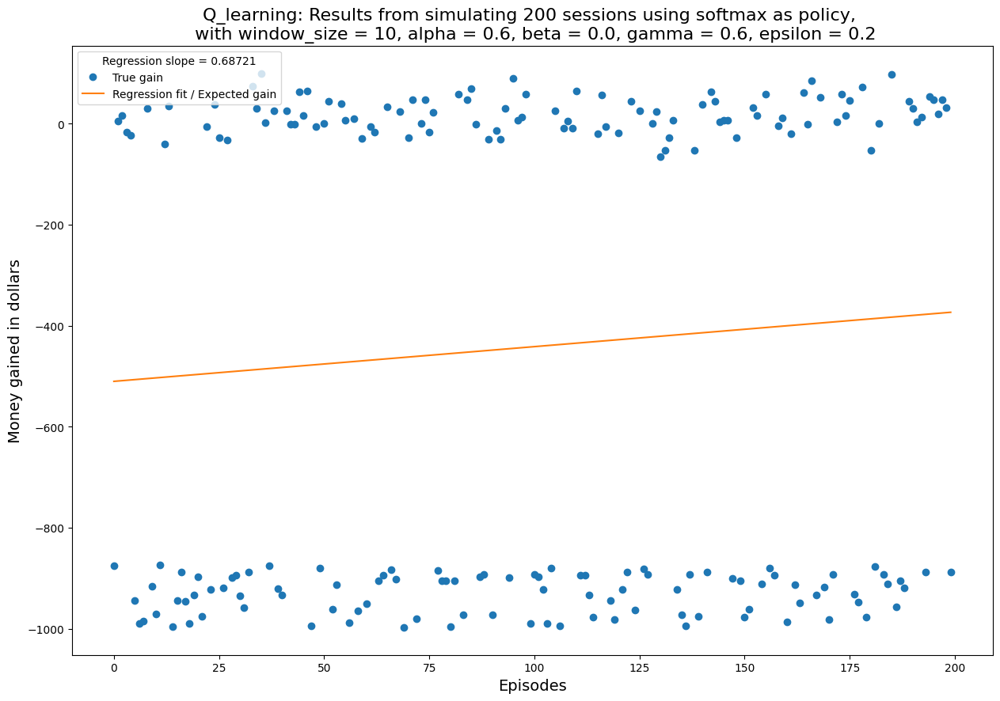

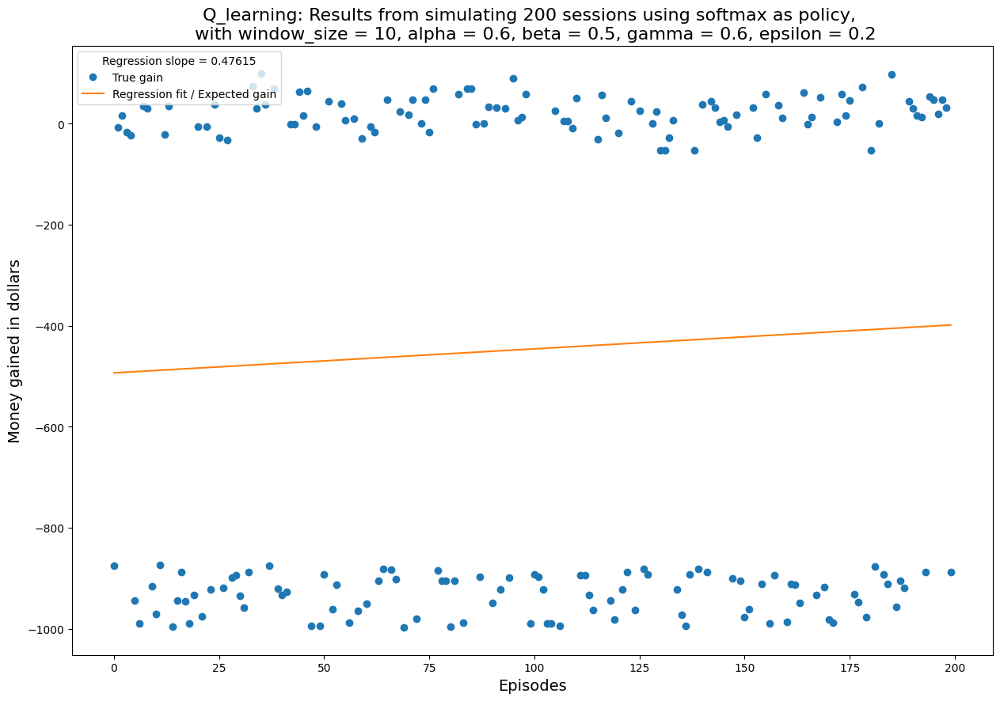

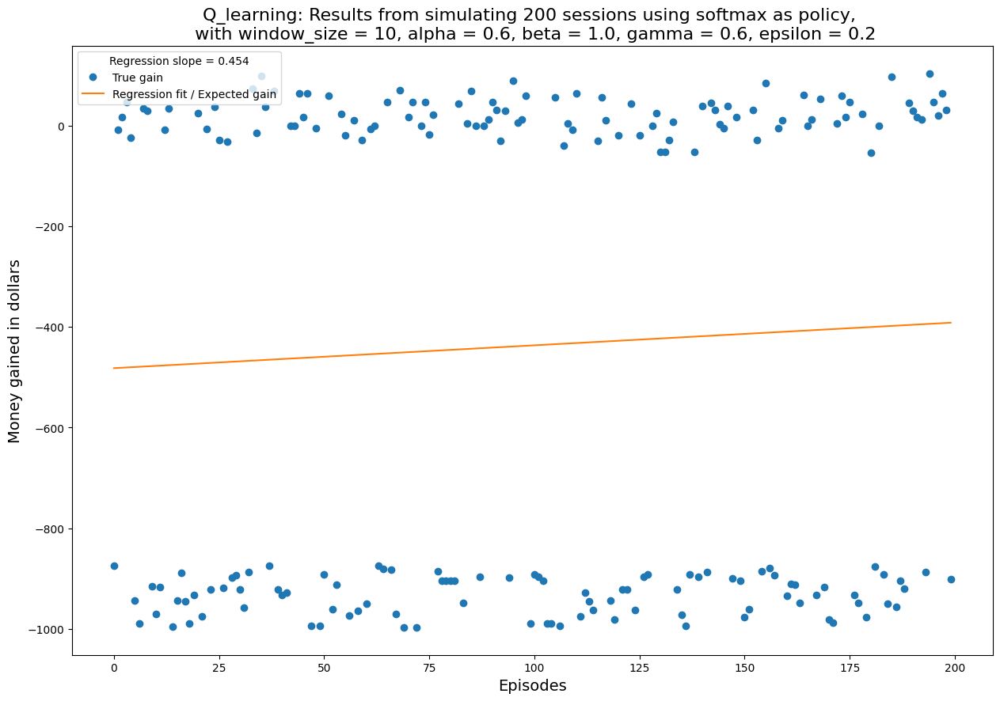

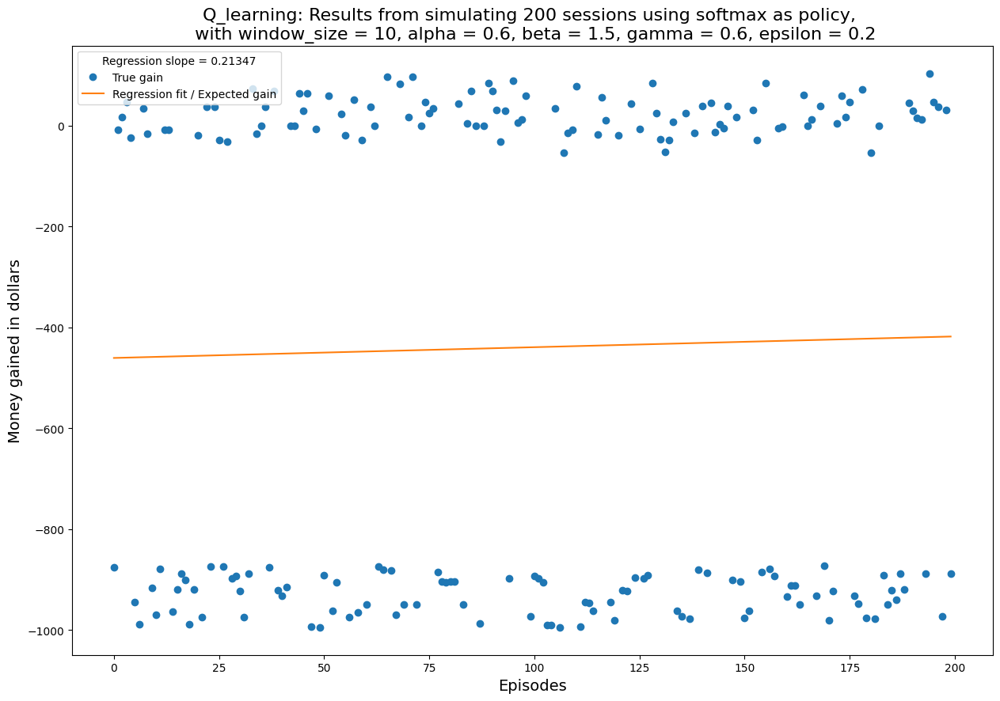

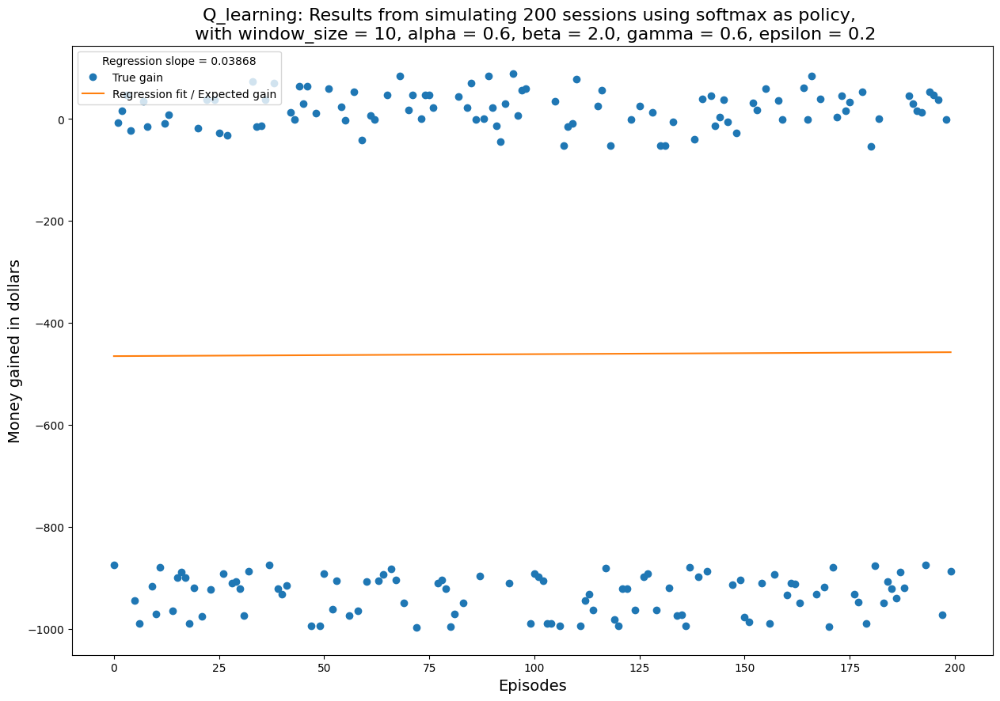

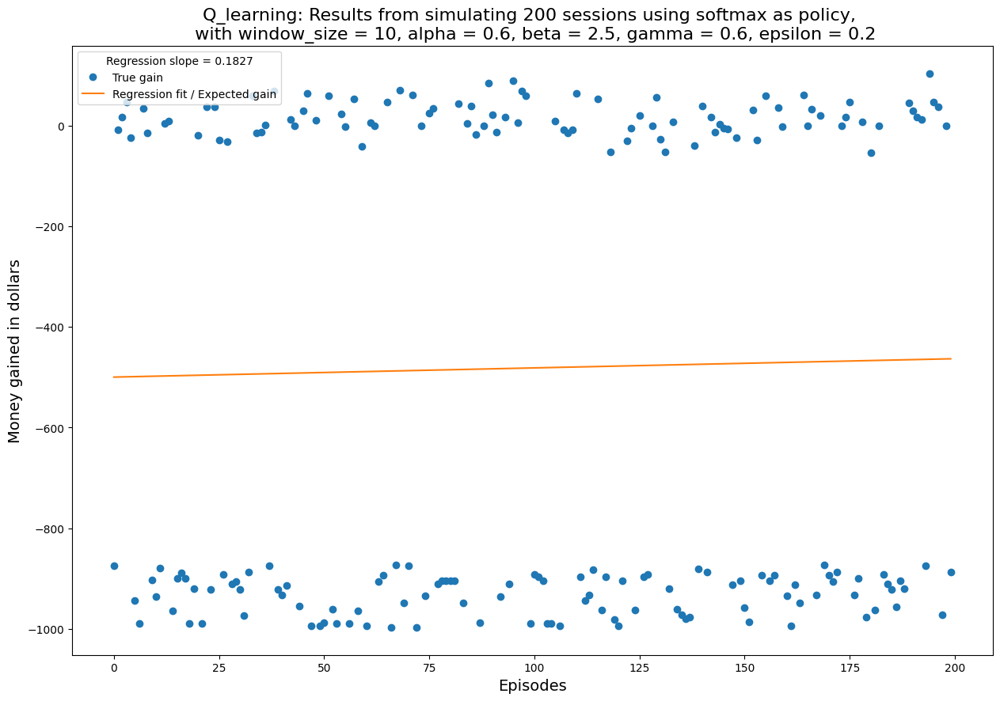

[]

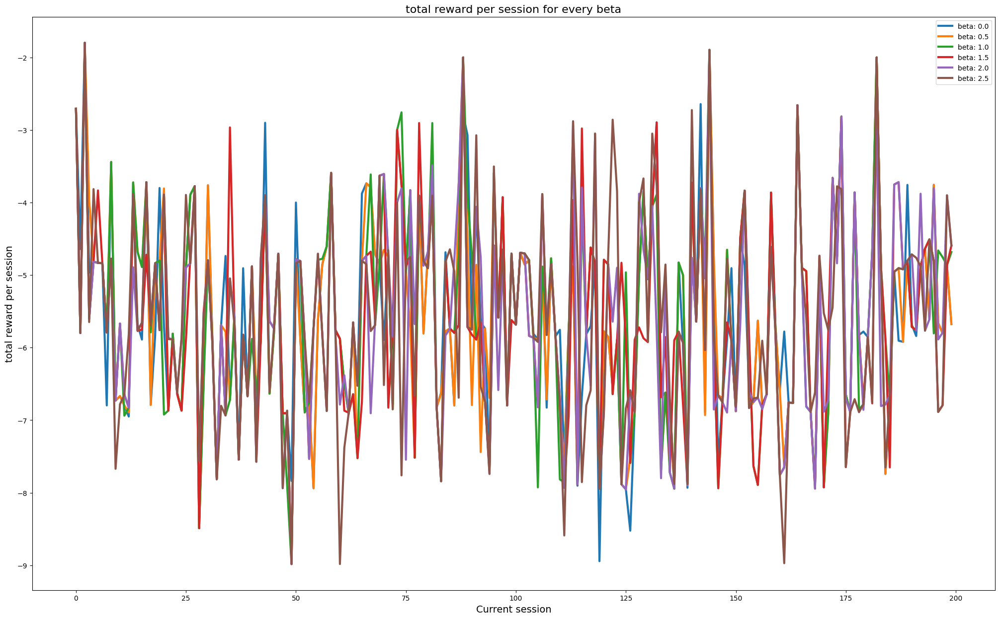

In [8]:
rewards_list = []
betas = []

for i in range(0, 6):
    beta = i*0.5
    betas.append(f"beta: {beta}")
    rl_agent = RL_Agent(alpha = 0.6, gamma = 0.6, epsilon = 0.2, beta=beta, data=data_window, assets=1000 , policy="softmax", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(betas)
ax1.plot()

#### Alpha parameter


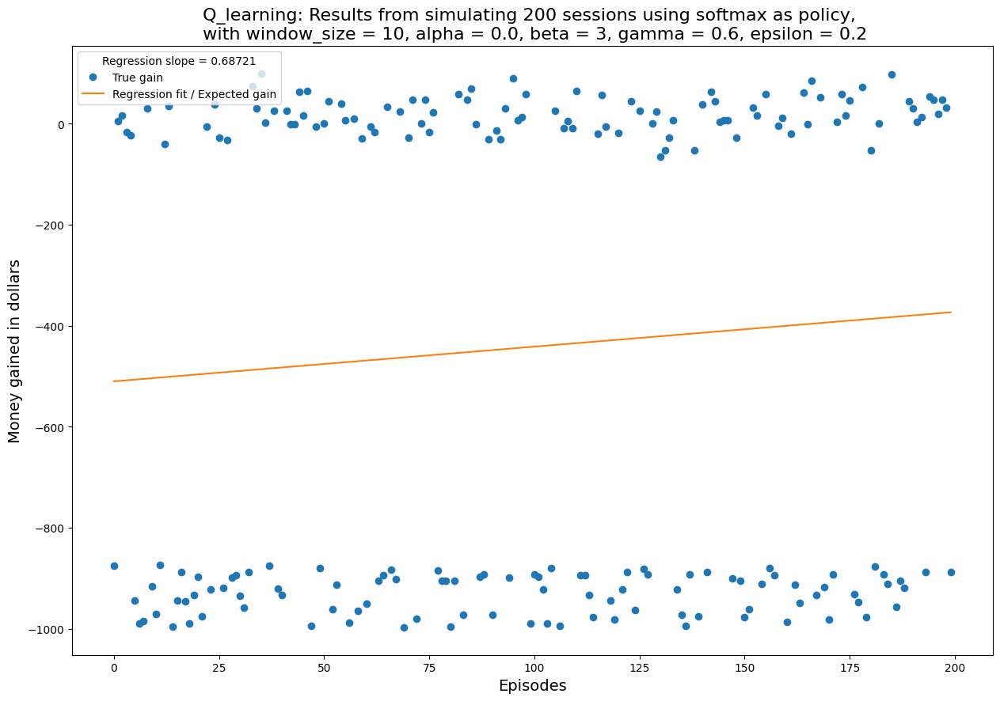

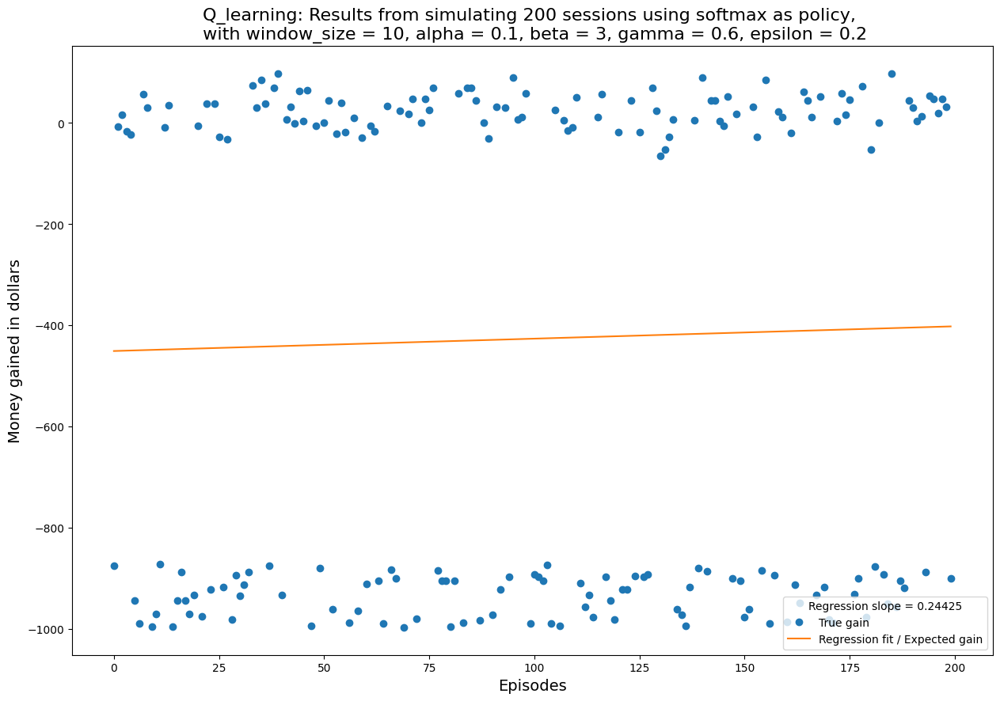

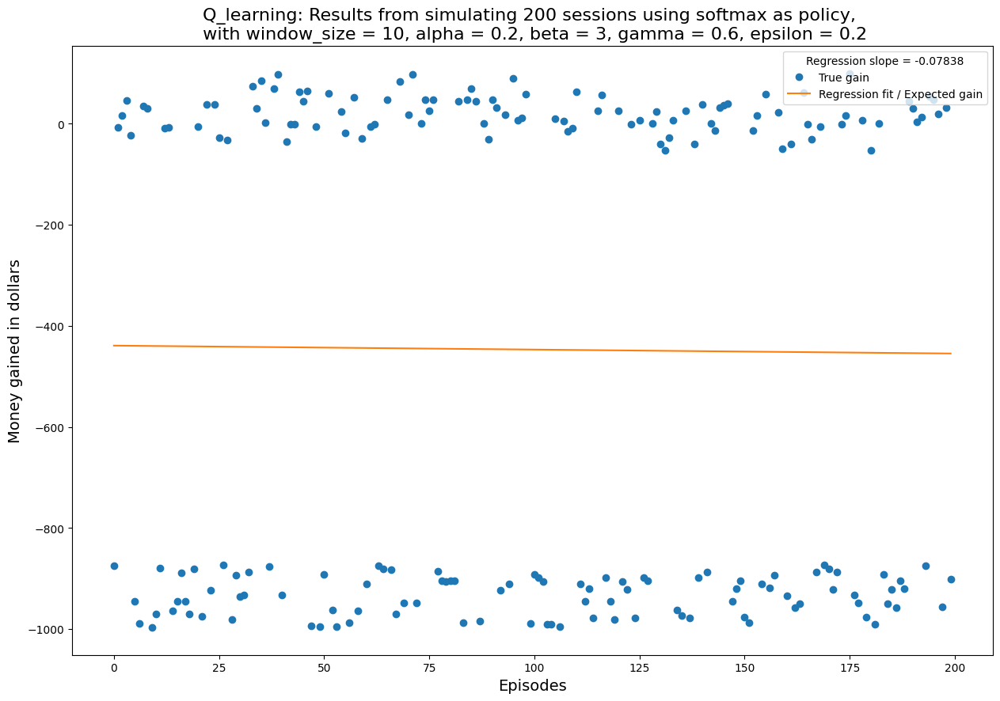

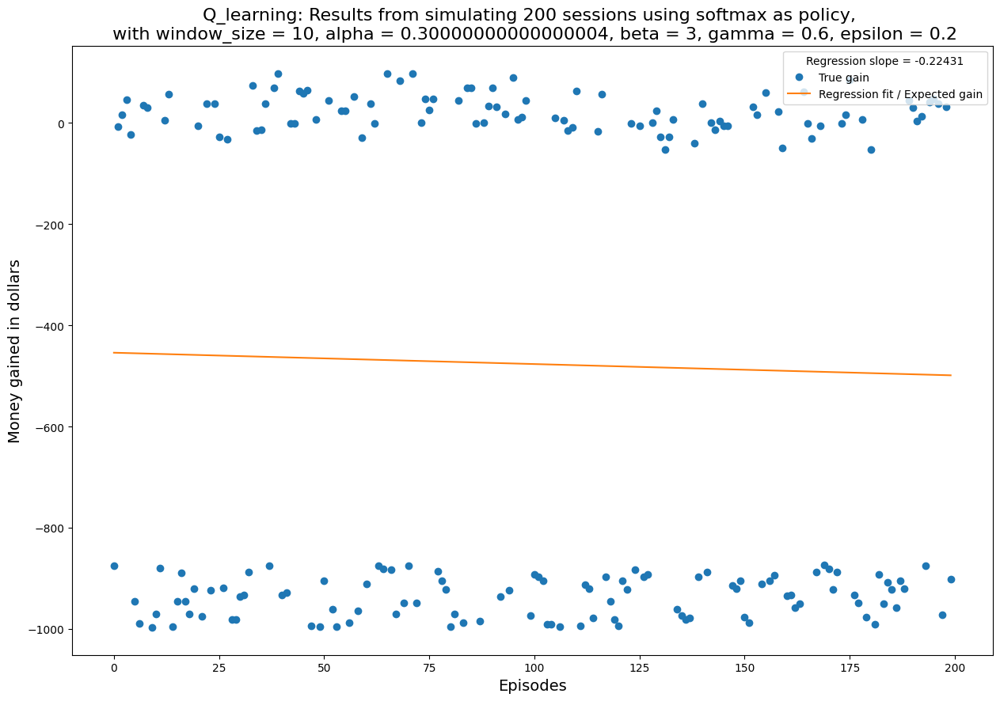

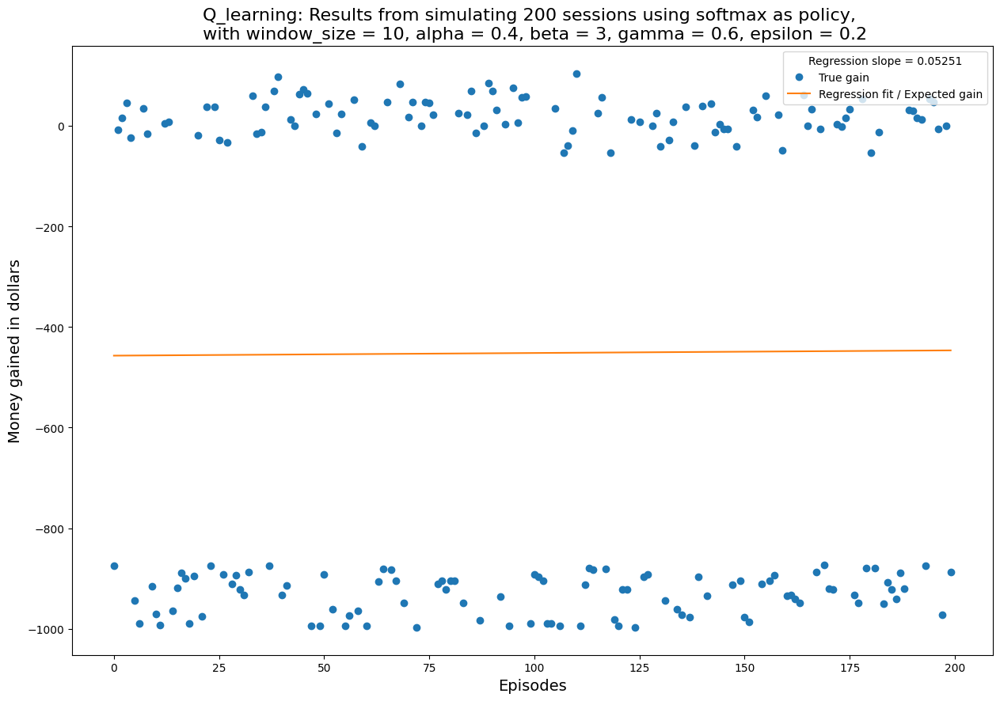

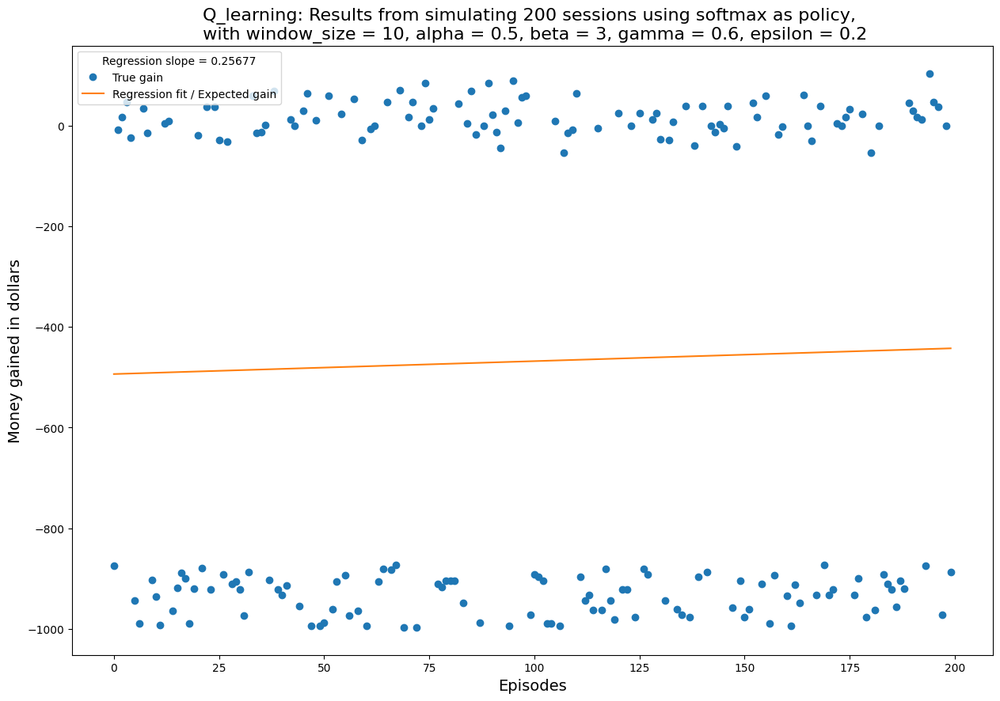

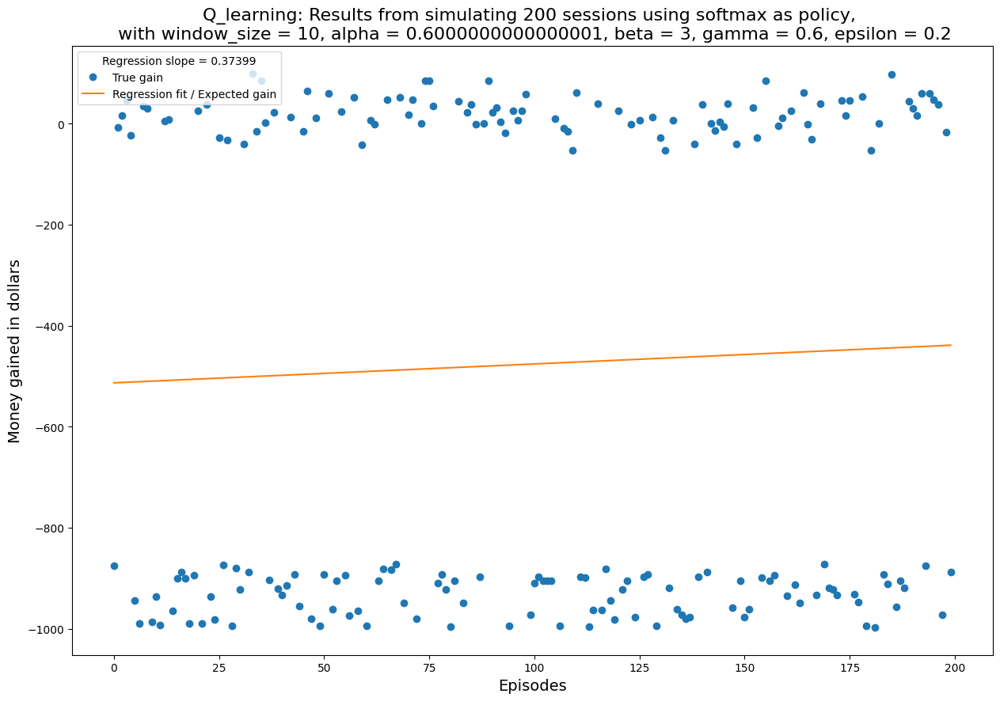

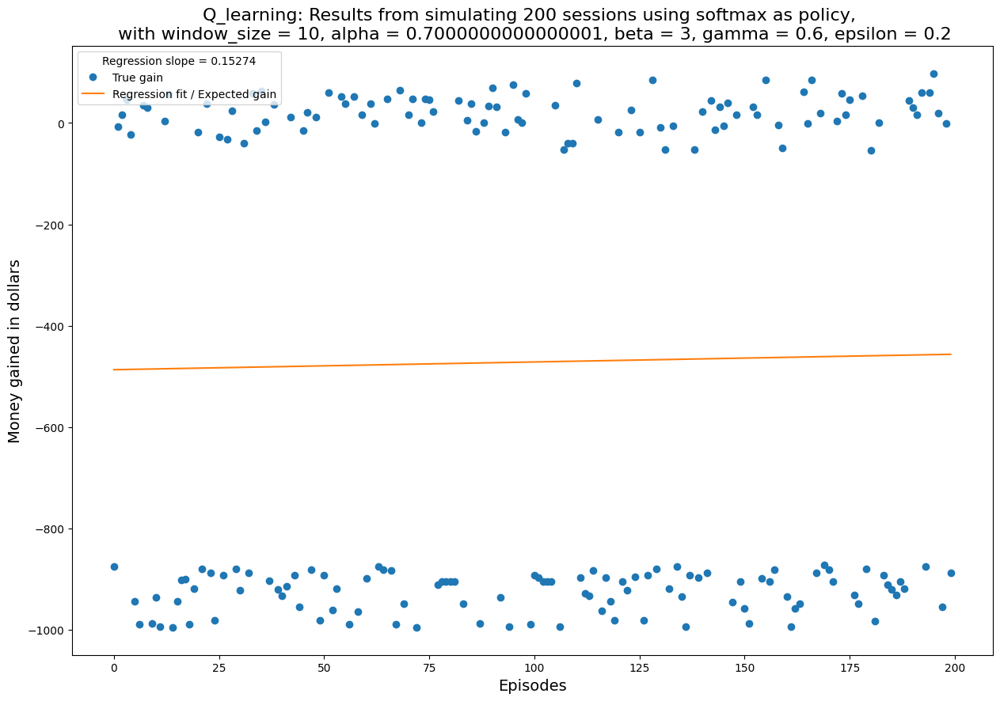

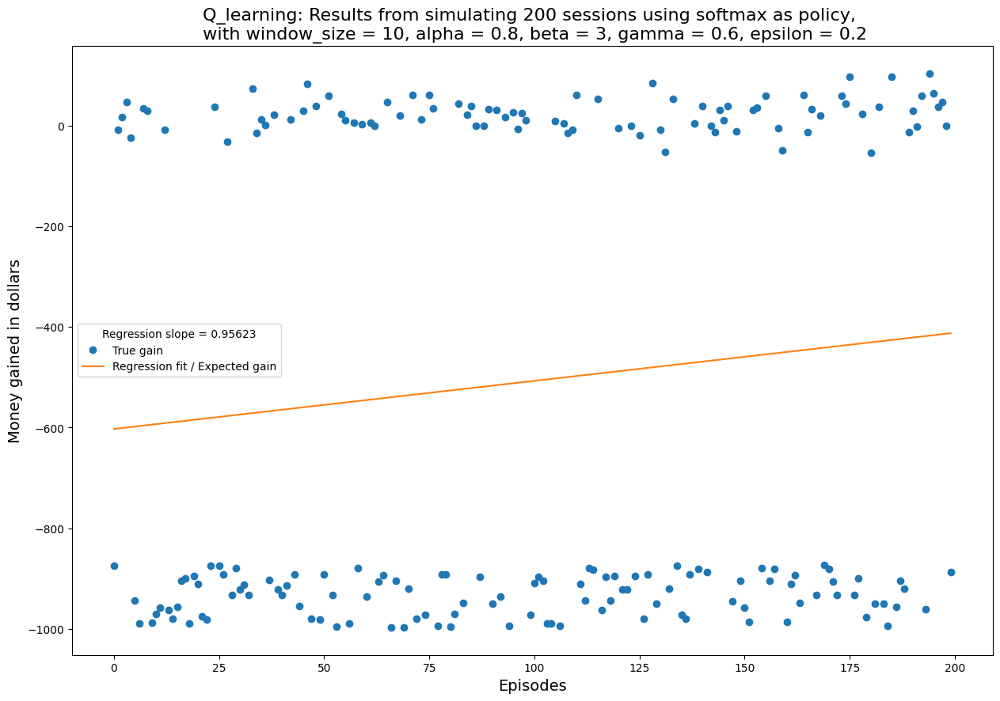

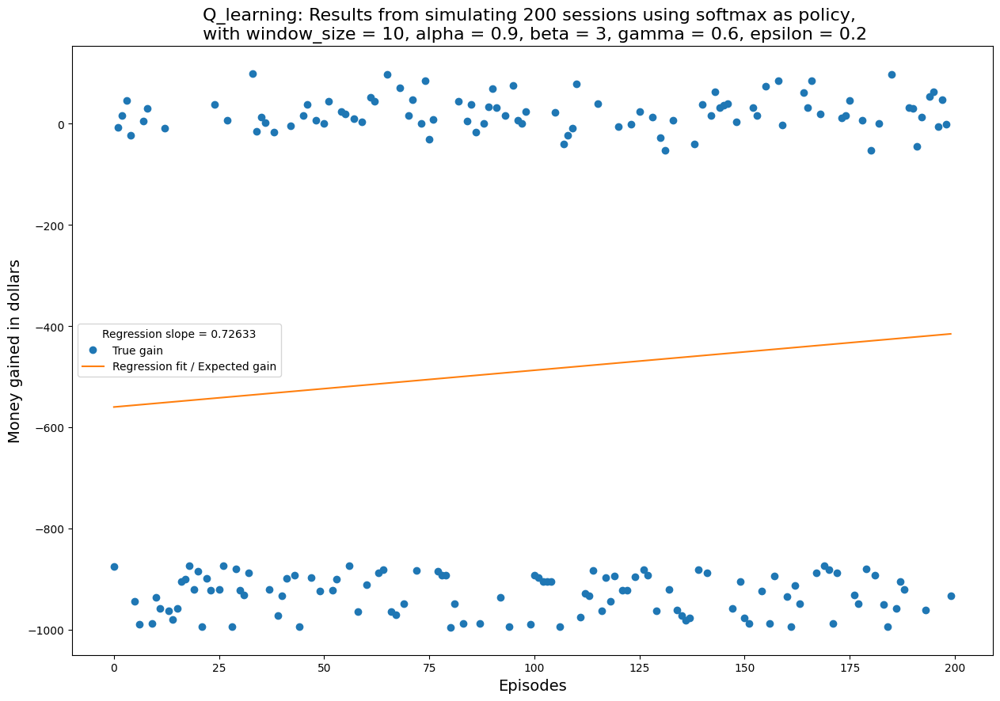

[]

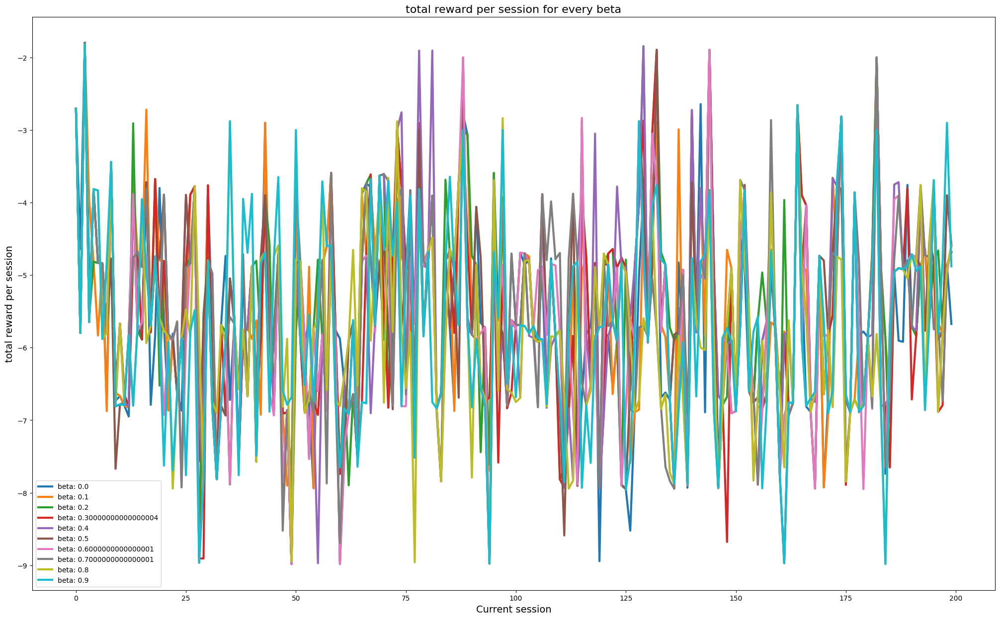

In [9]:
rewards_list = []
alphas = []

for i in range(0, 10):
    alpha = i*0.1
    alphas.append(f"beta: {alpha}")
    rl_agent = RL_Agent(alpha = alpha, gamma = 0.6, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="softmax", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(alphas)
ax1.plot()

#### Gamma parameter
Let's now compare the various discount factors.

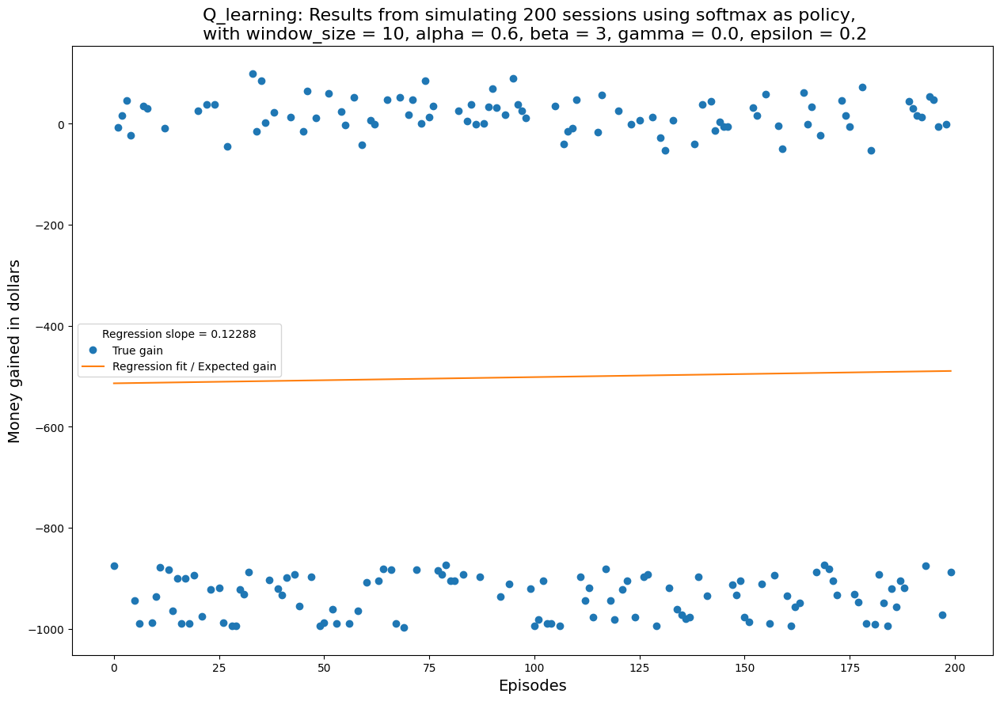

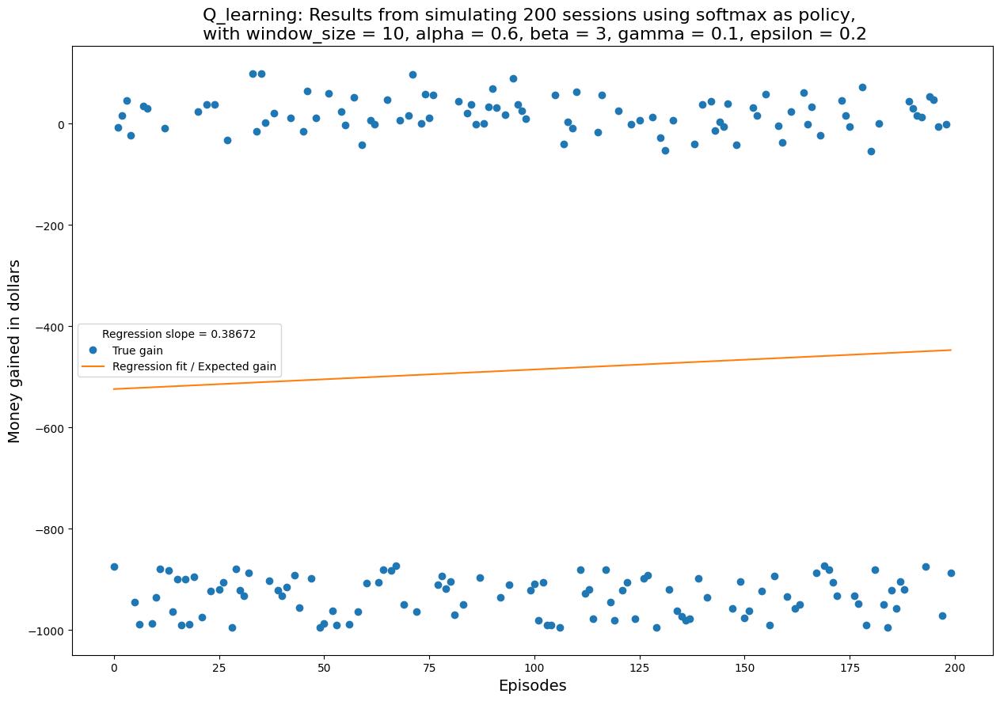

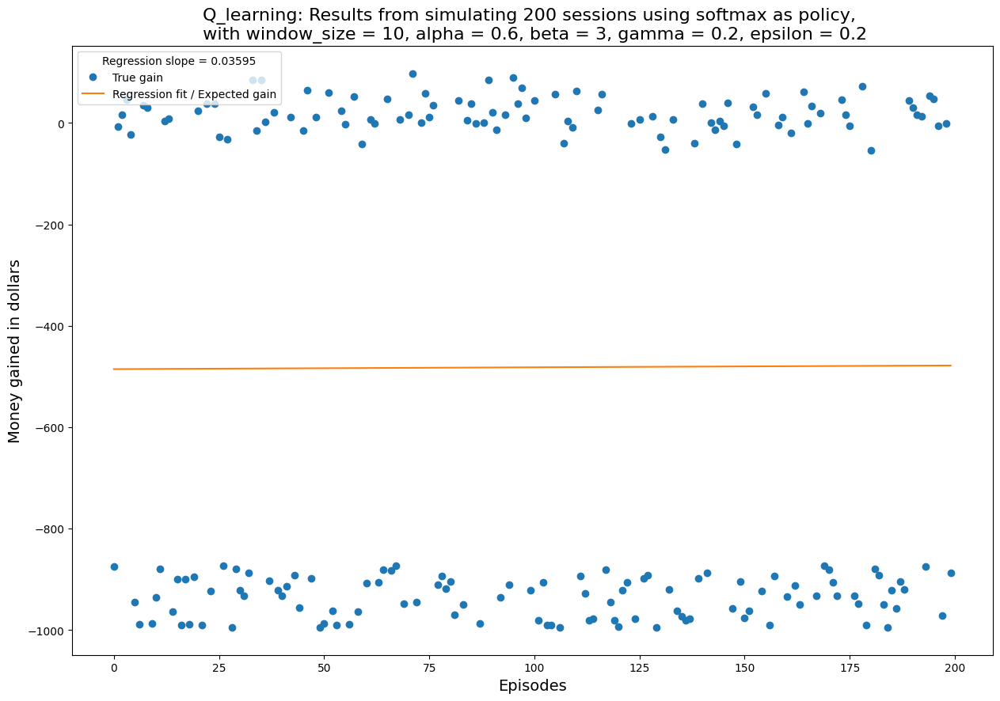

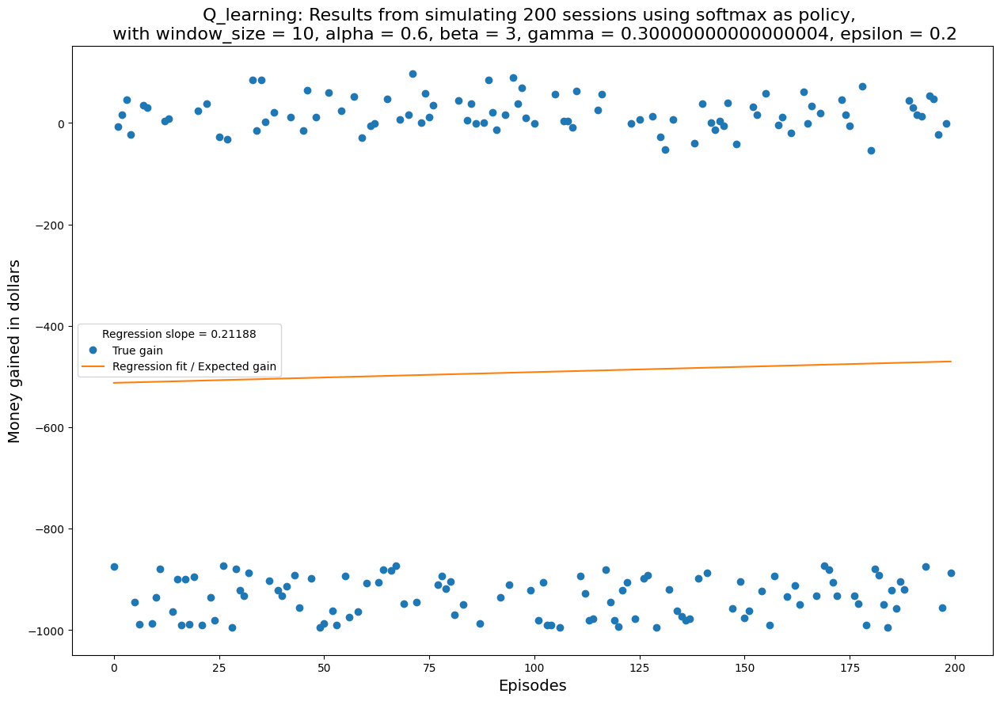

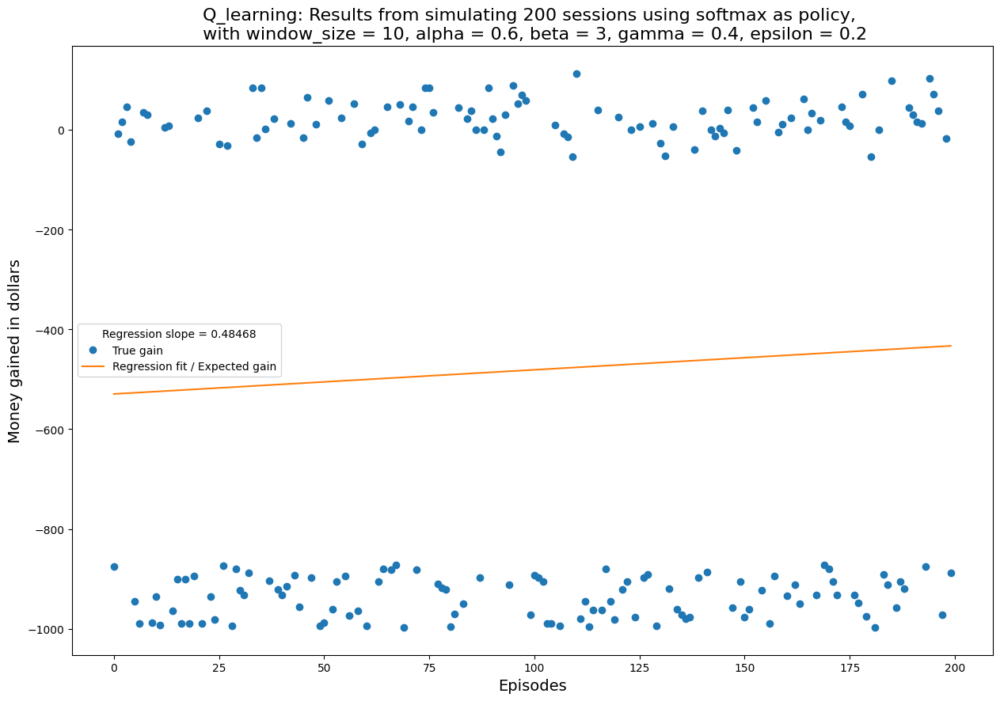

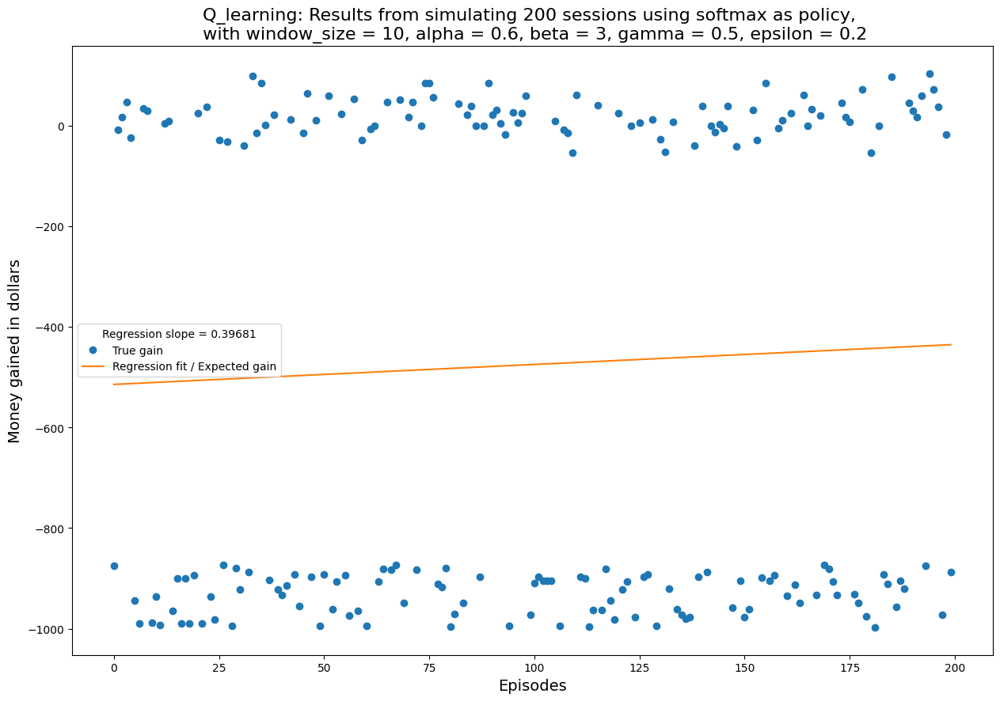

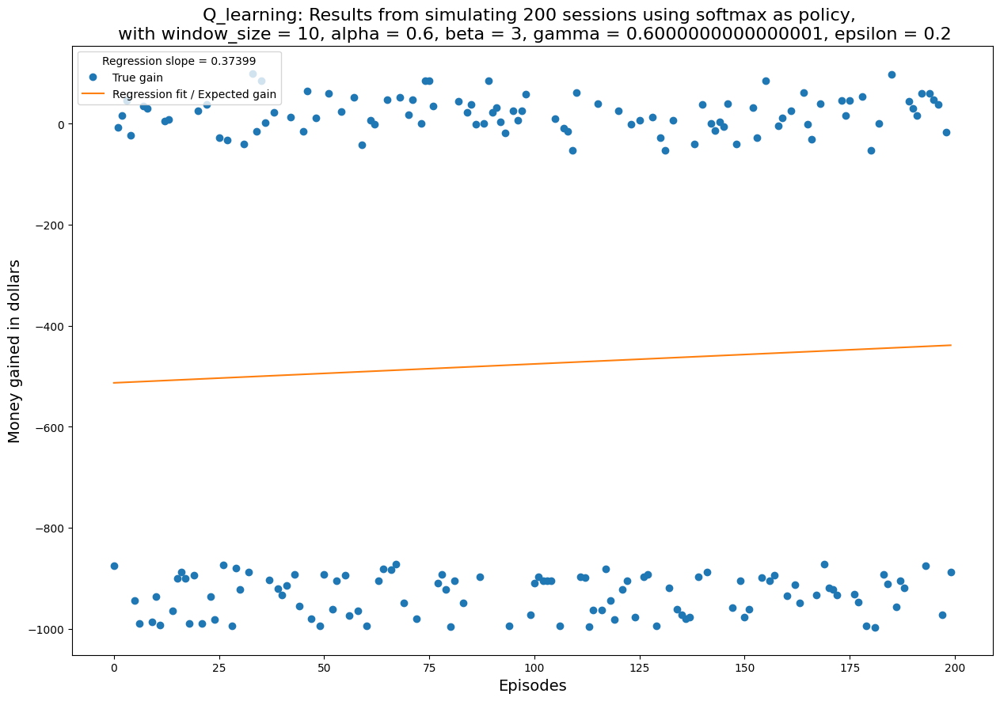

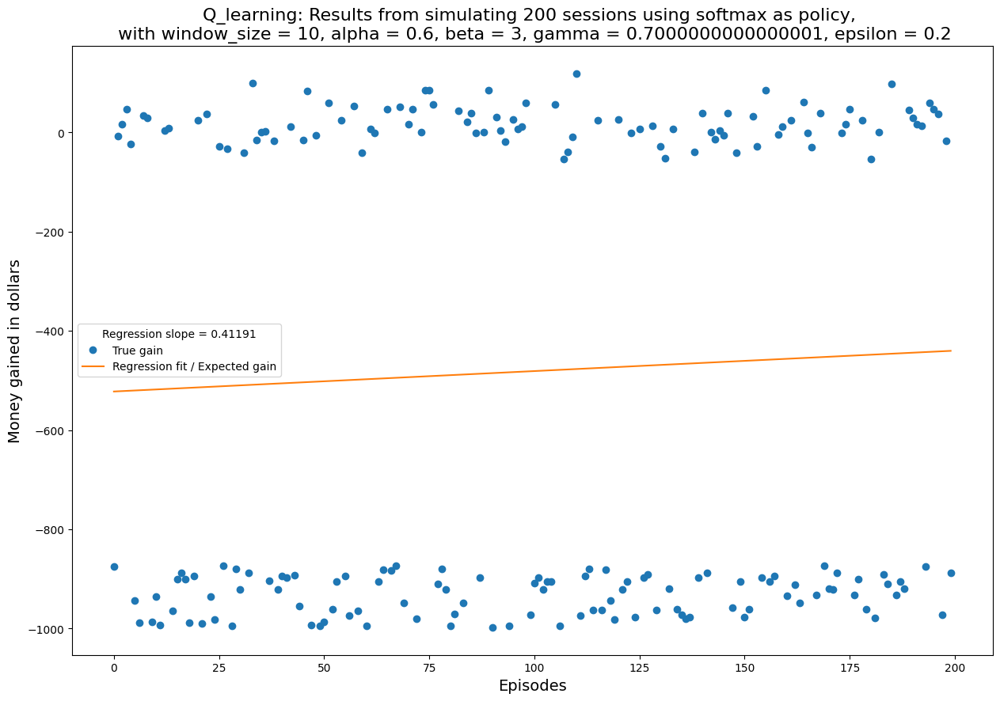

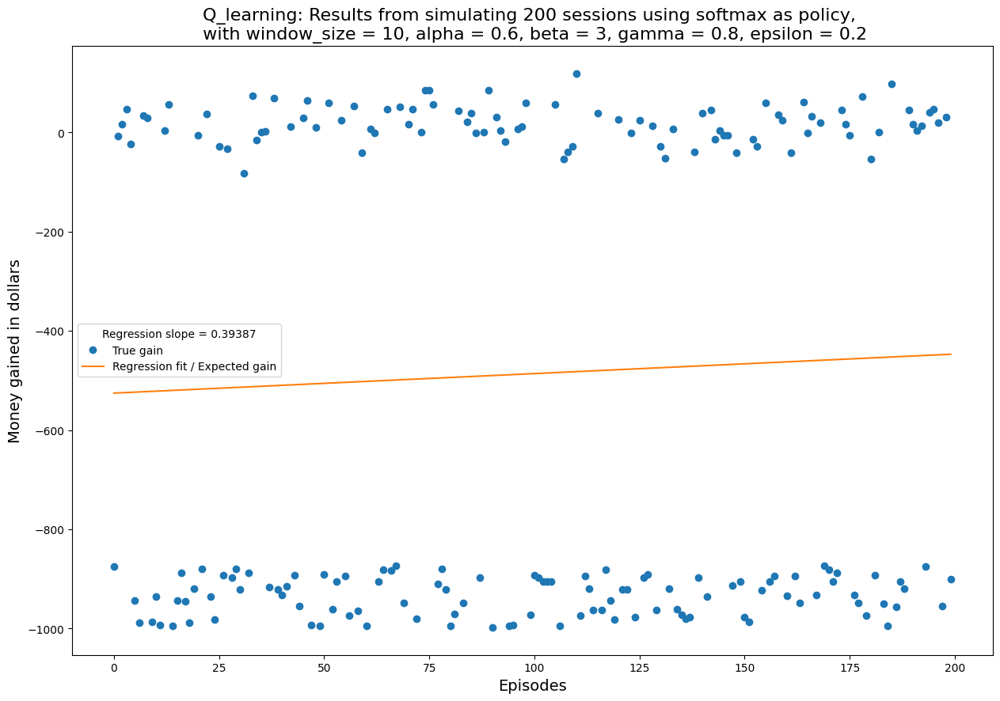

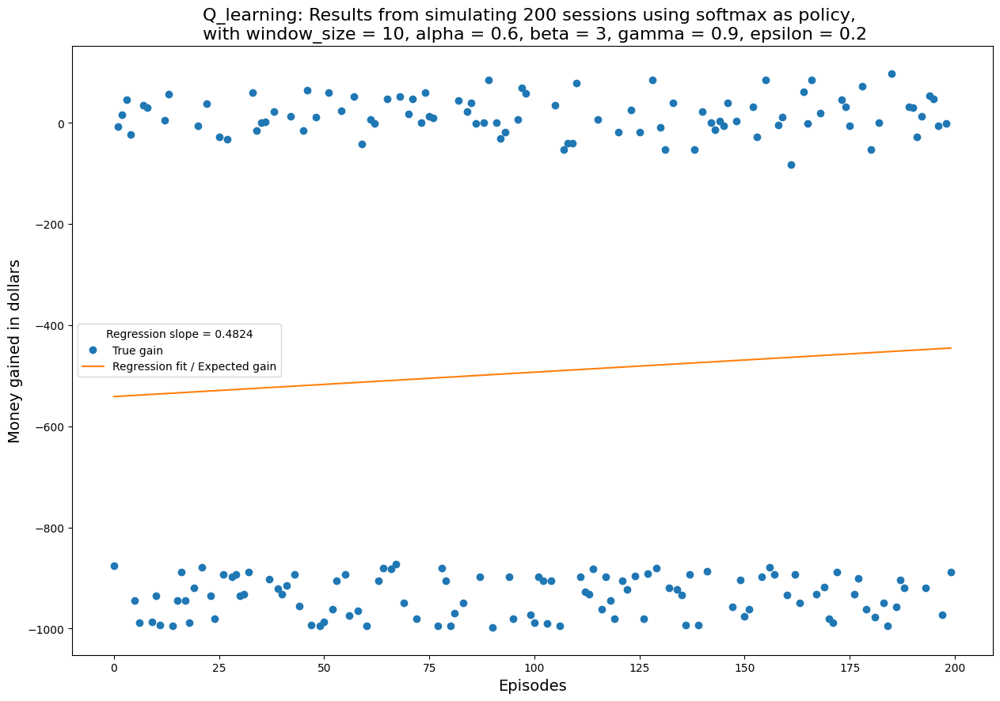

[]

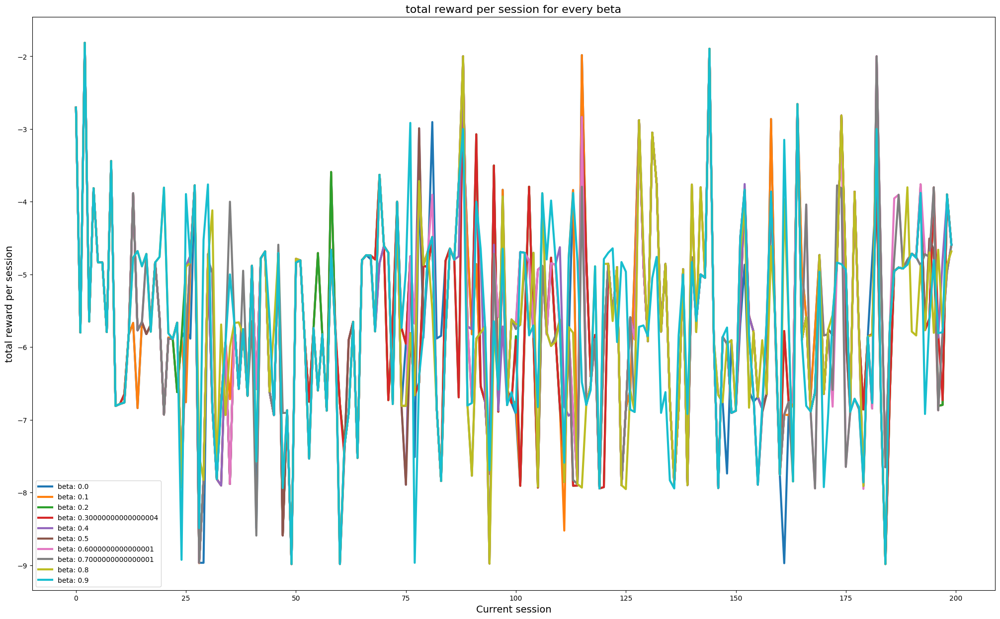

In [10]:
rewards_list = []
gammas = []

for i in range(0, 10):
    gamma = i*0.1
    gammas.append(f"beta: {gamma}")
    rl_agent = RL_Agent(alpha = 0.6, gamma = gamma, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="softmax", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(gammas)
ax1.plot()

### Epsilon-greedy policy
#### Epsilon parameter
Now let's compare the different epsilons, it should be noted that when $\epsilon$ = 0 the policy is greedy

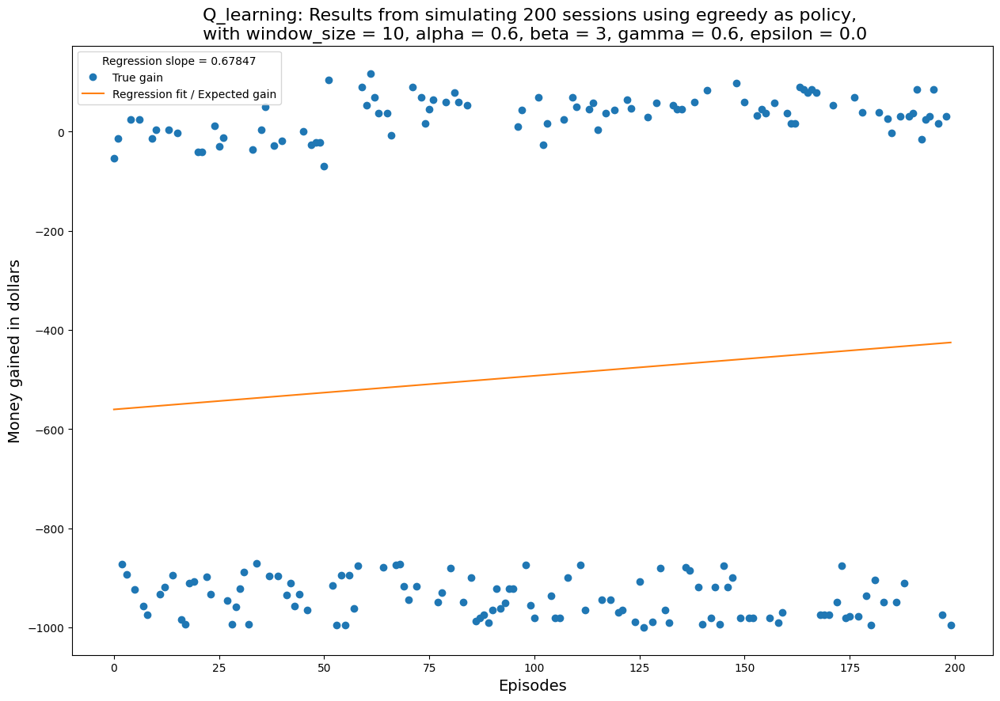

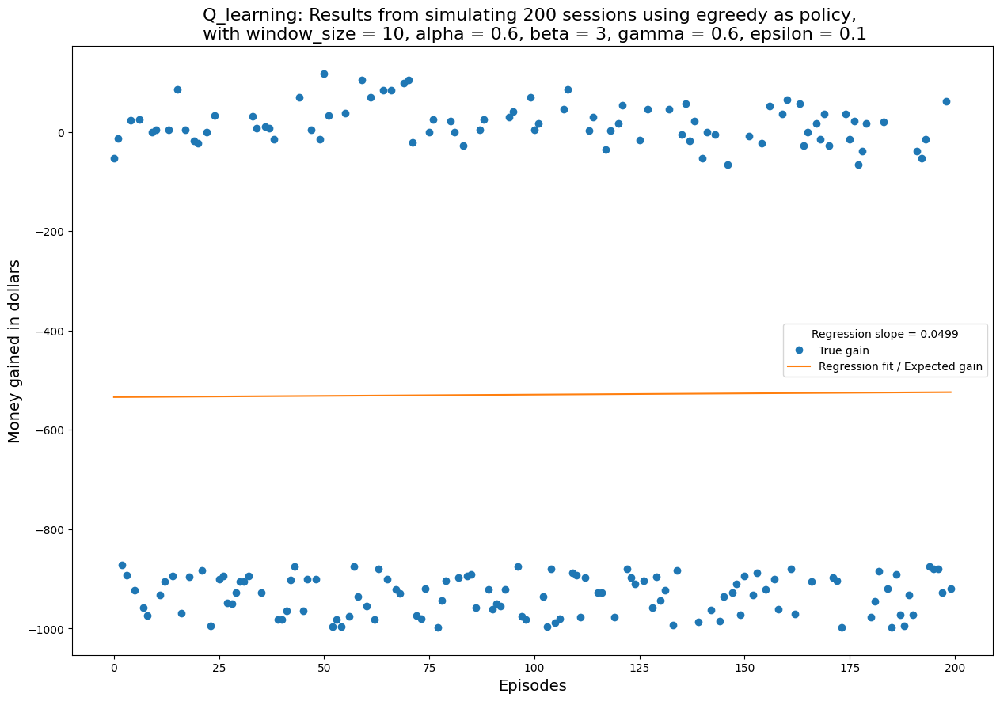

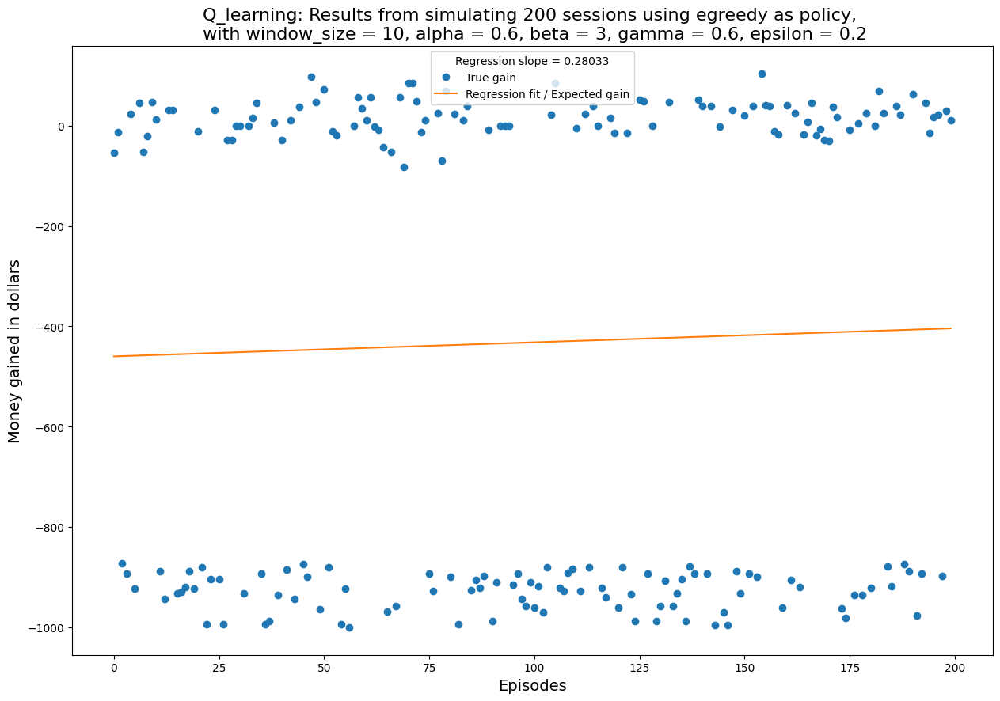

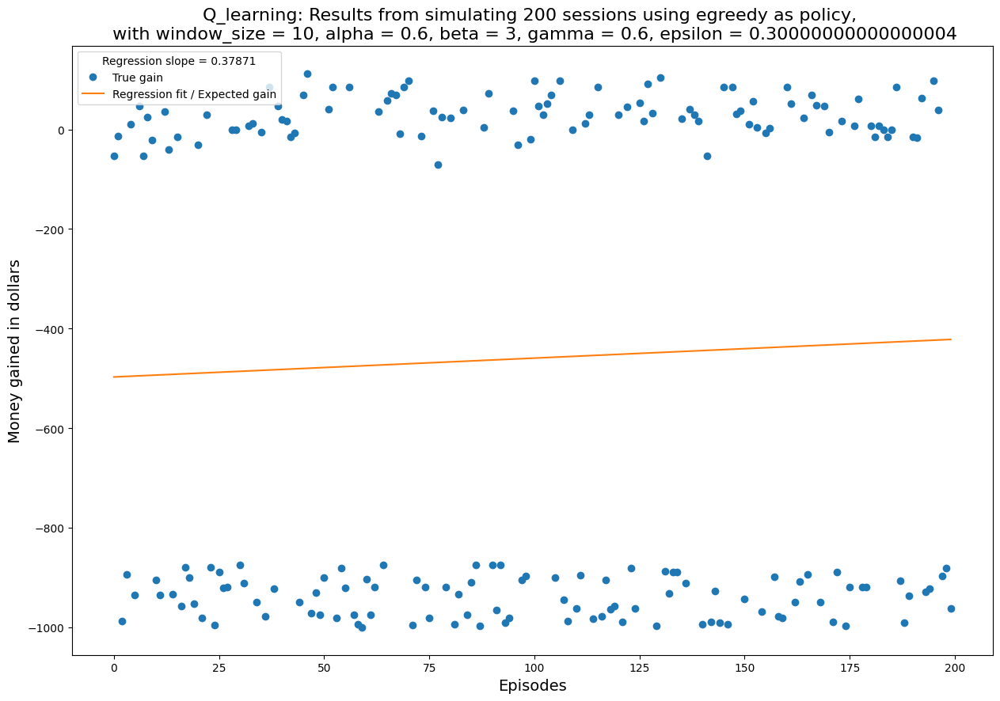

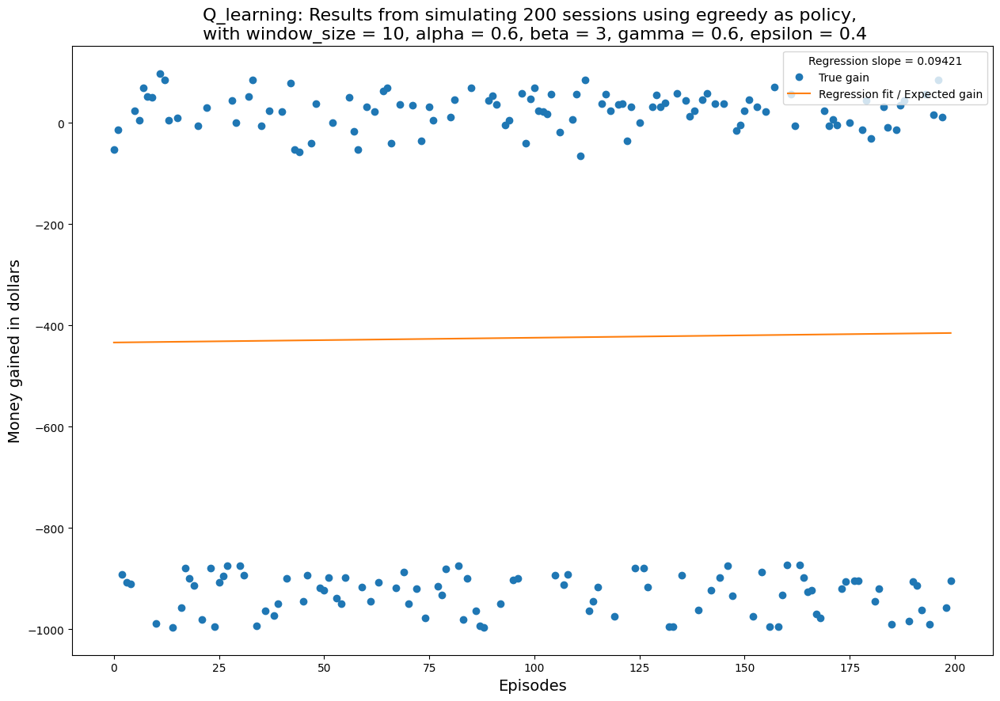

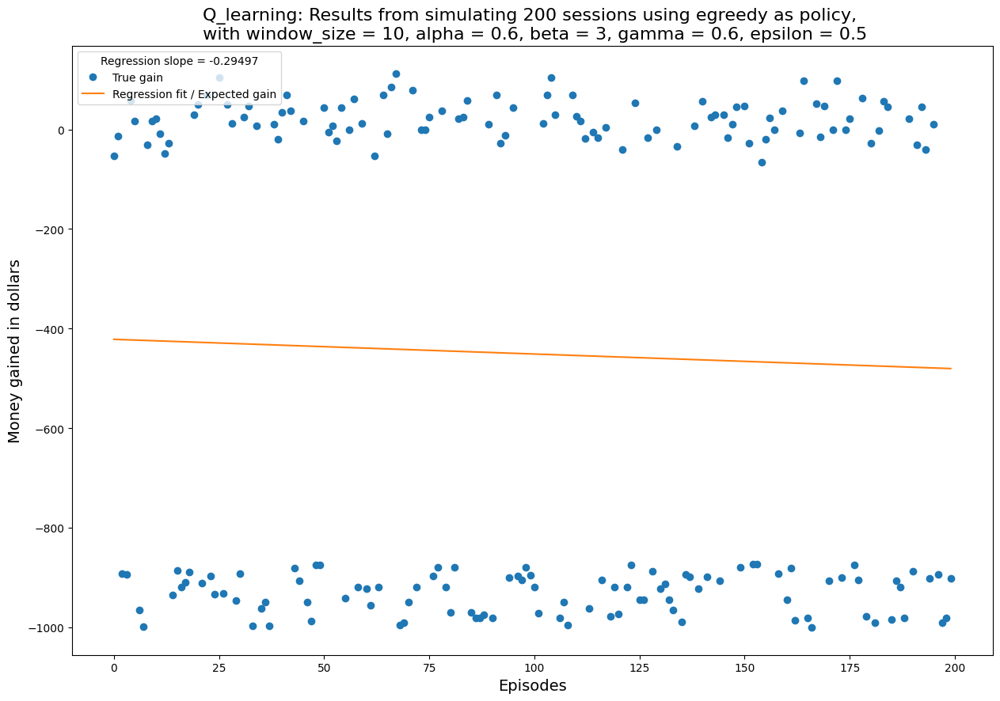

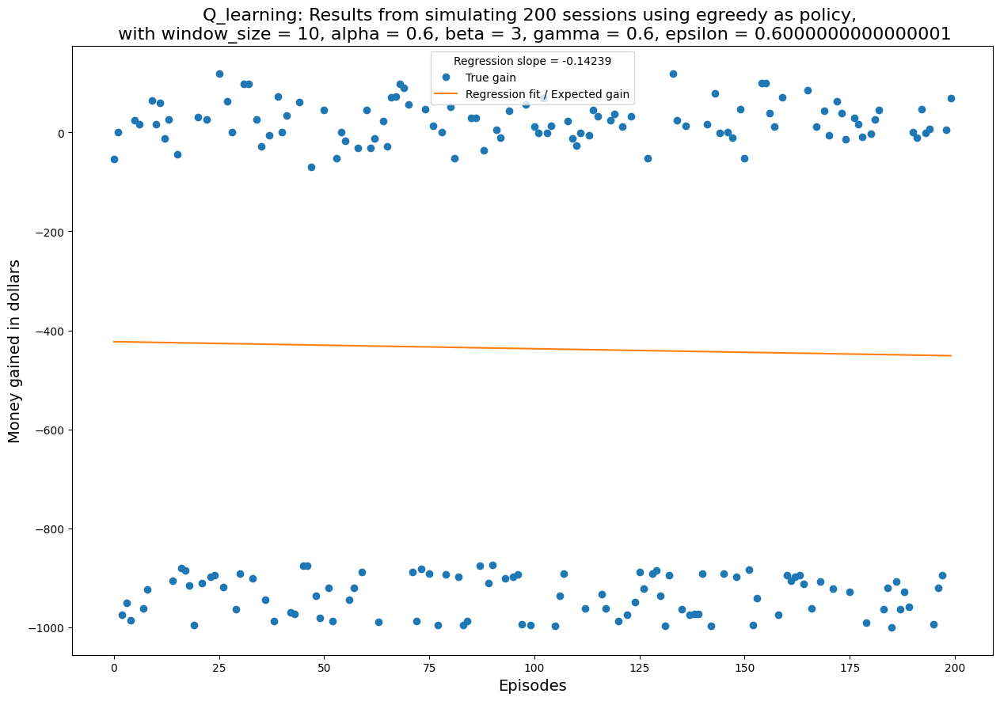

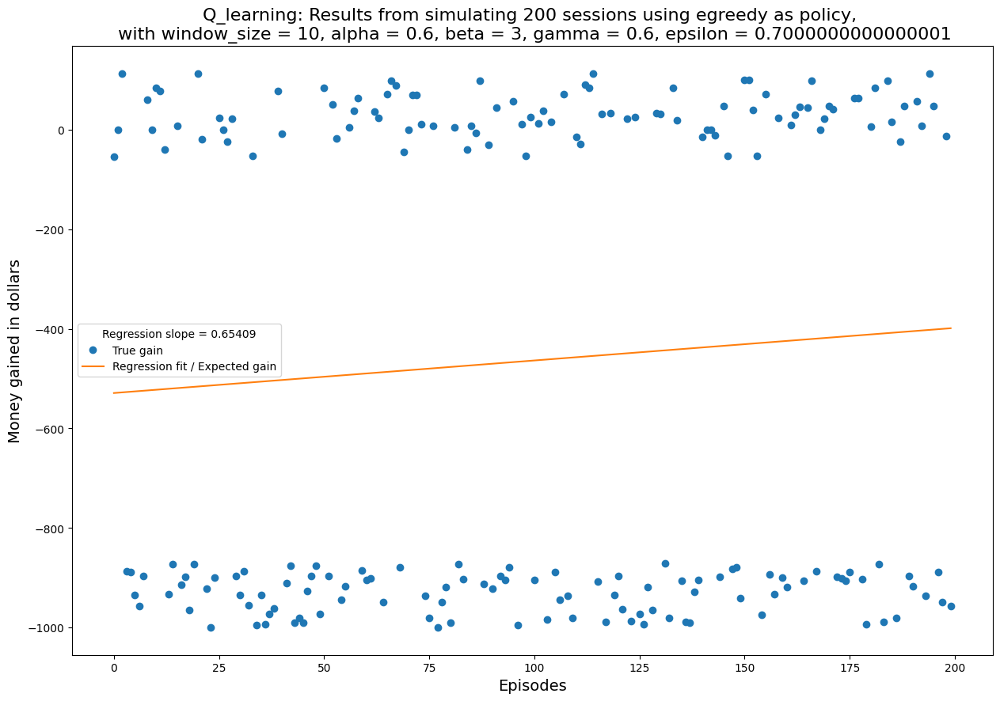

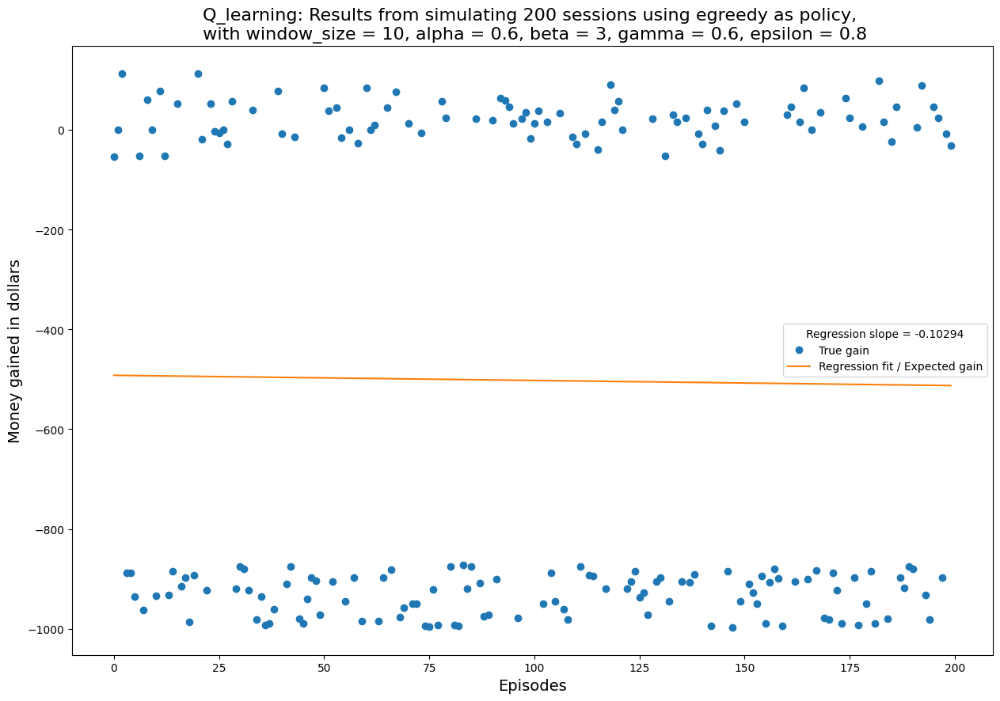

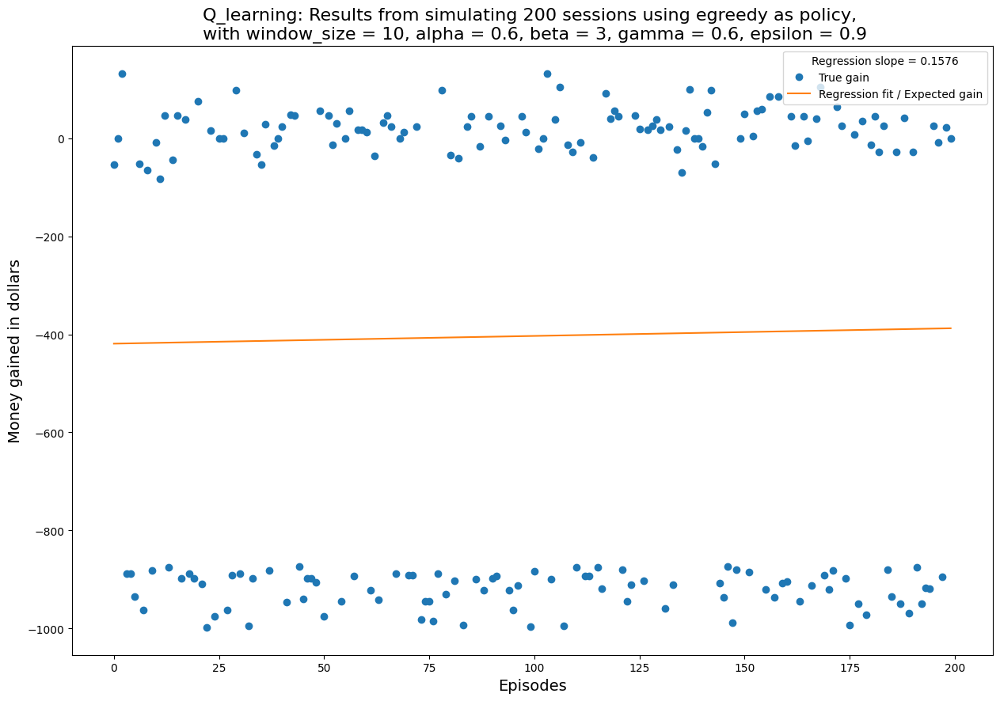

[]

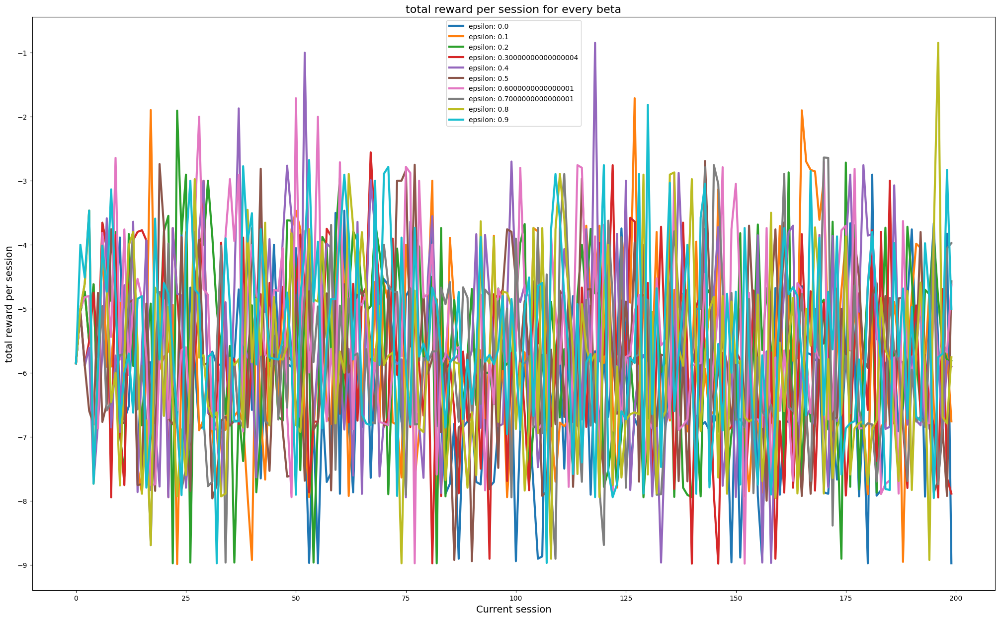

In [11]:
rewards_list = []
epsilons = []

for i in range(0, 10):
    epsilon = i*0.1
    epsilons.append(f"epsilon: {epsilon}")
    rl_agent = RL_Agent(alpha = 0.6, gamma = 0.6, epsilon = epsilon, beta = 3, data=data_window, assets=1000 , policy="egreedy", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(epsilons)
ax1.plot()

#### Alpha parameter
Now let's compare the different learning rates

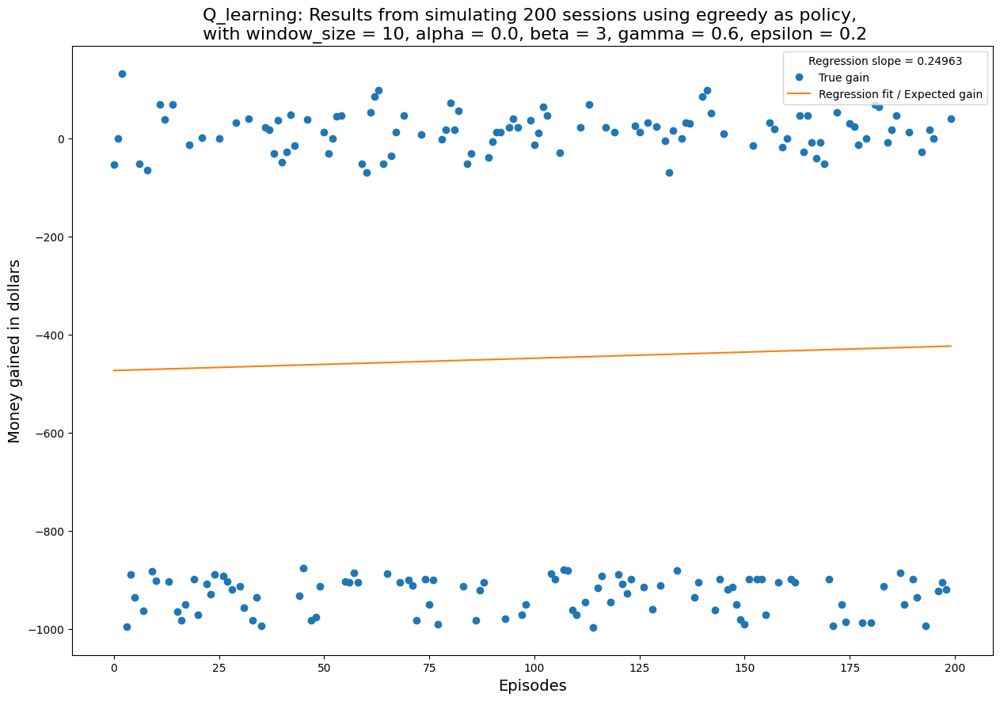

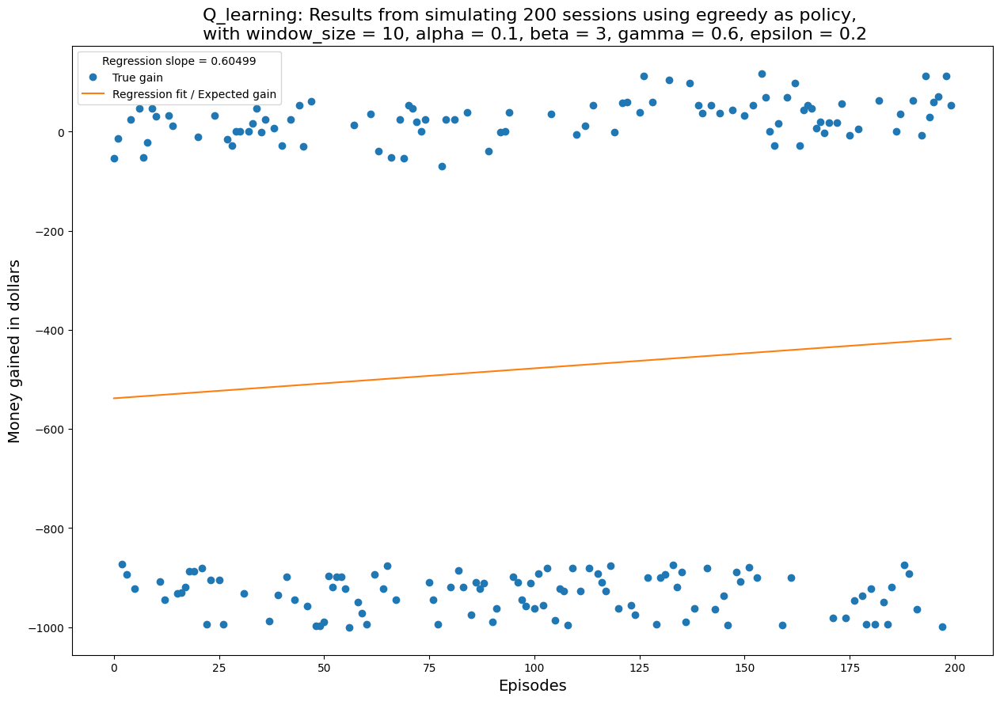

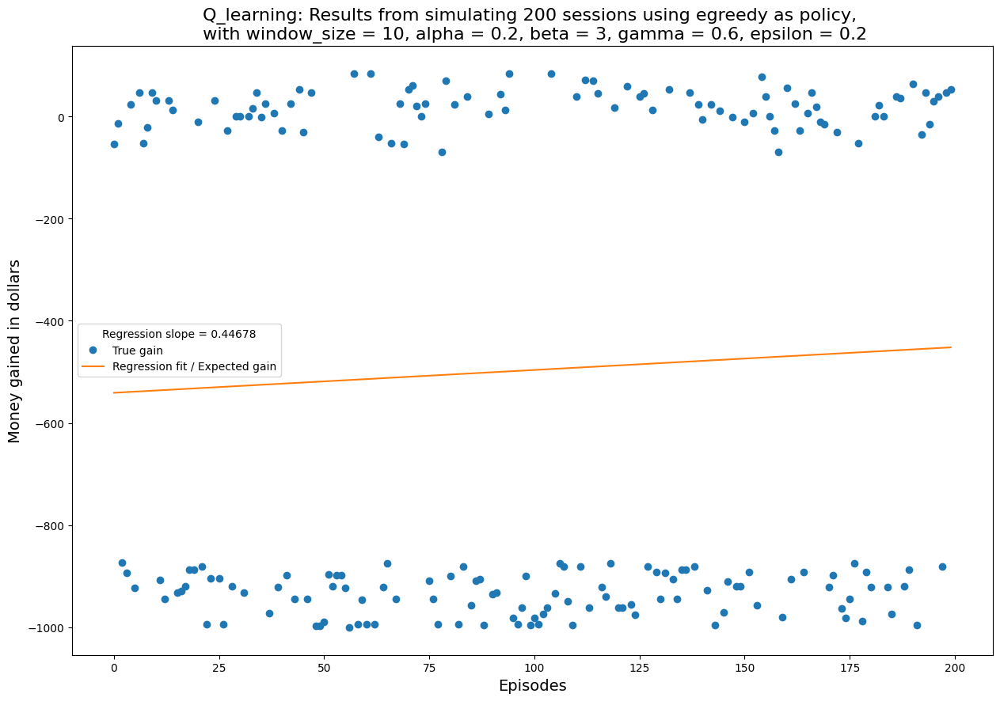

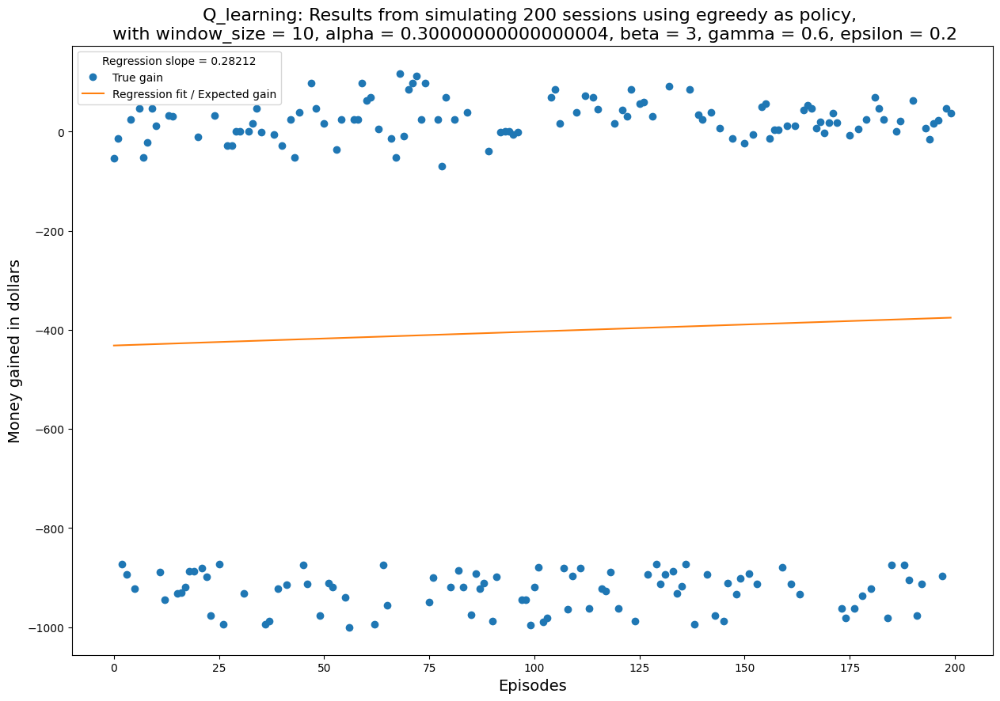

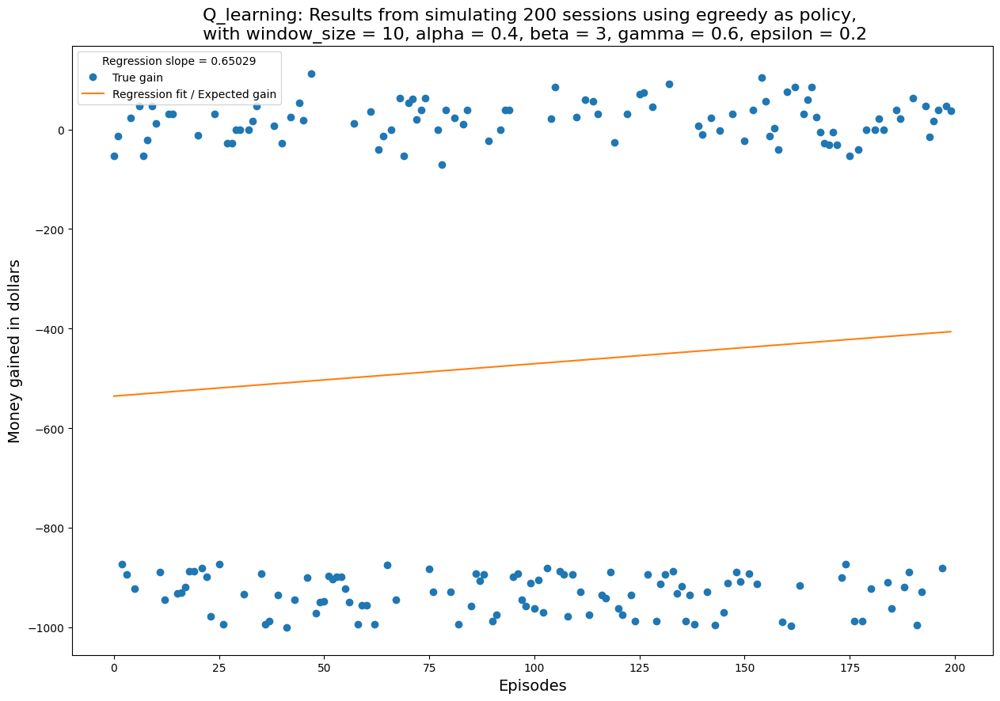

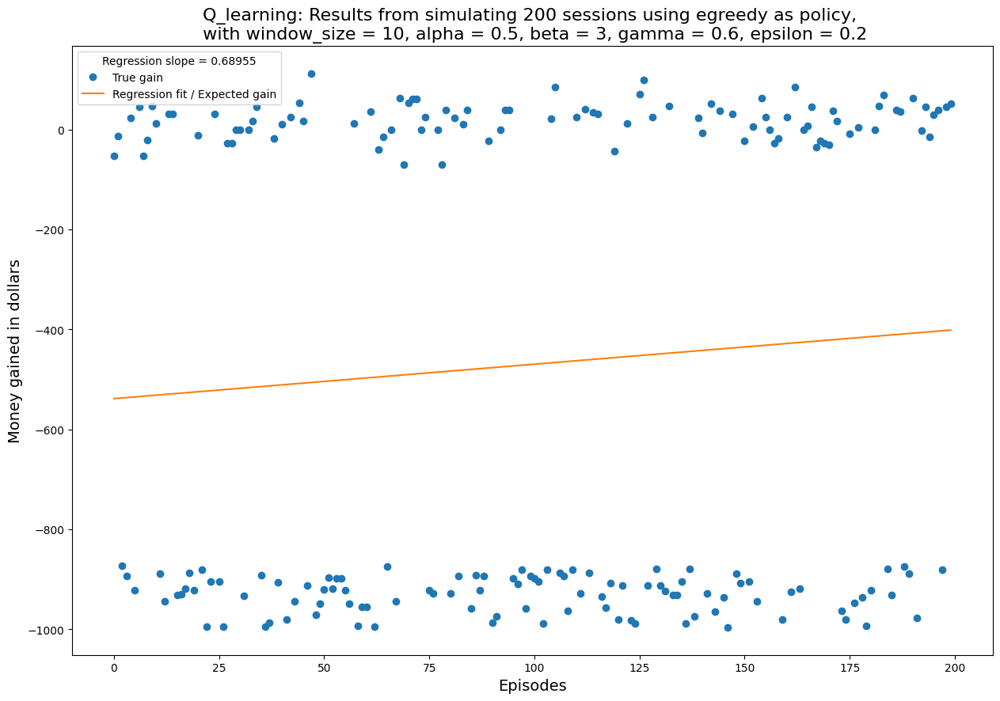

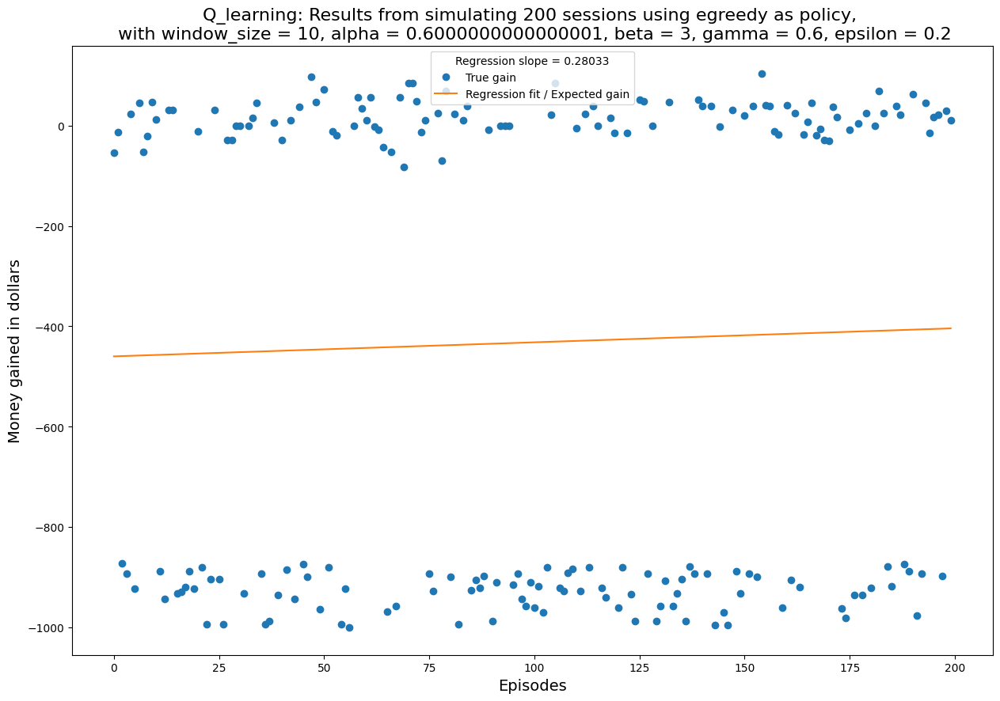

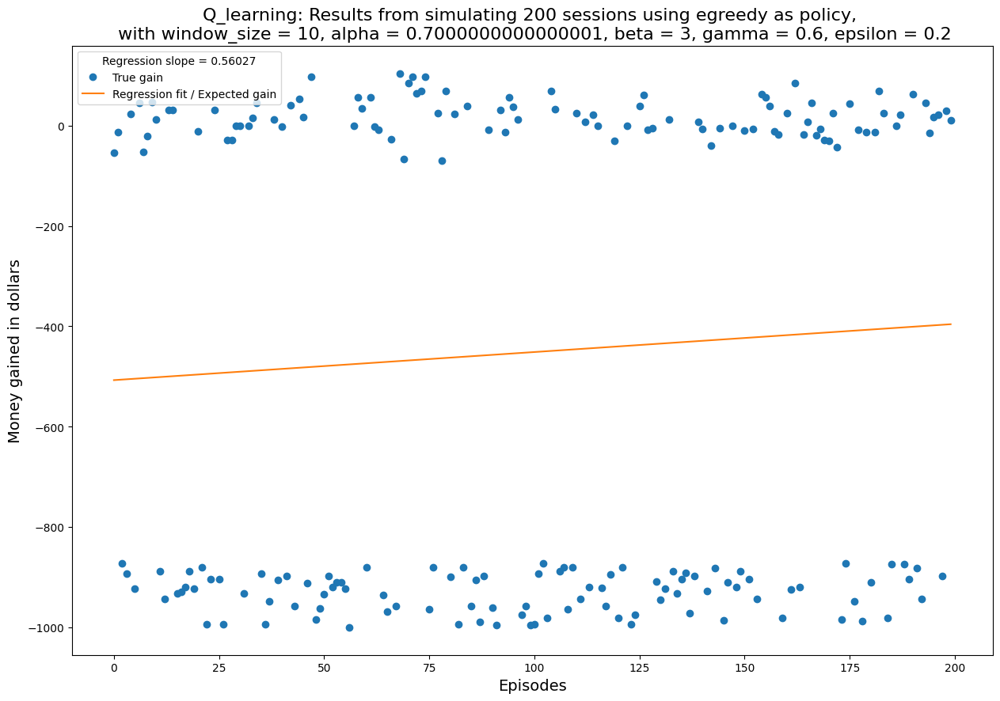

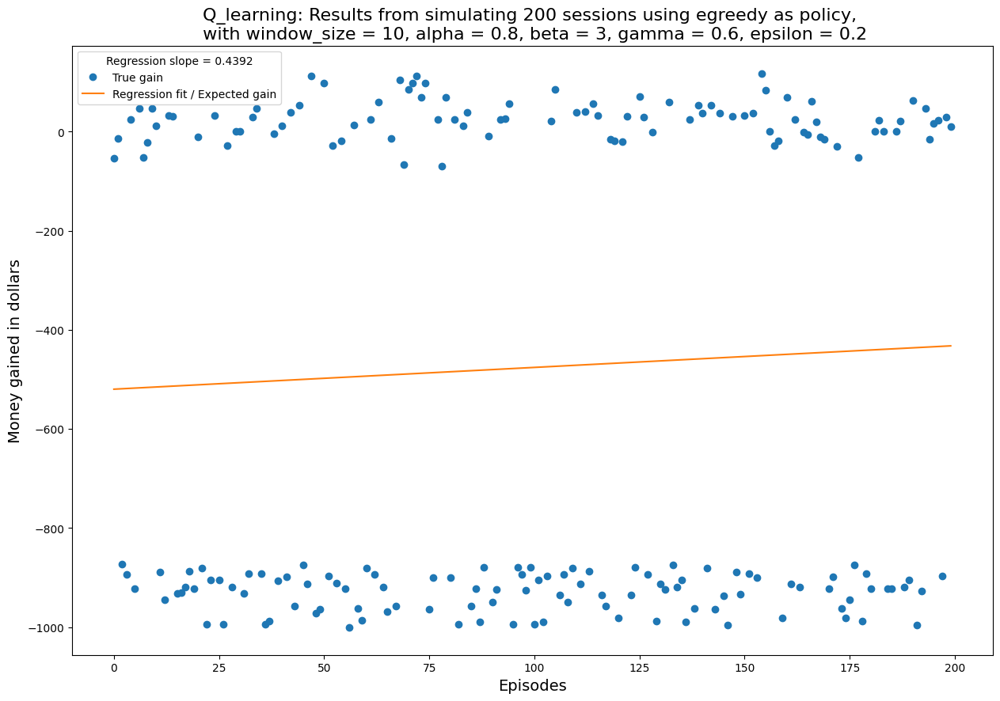

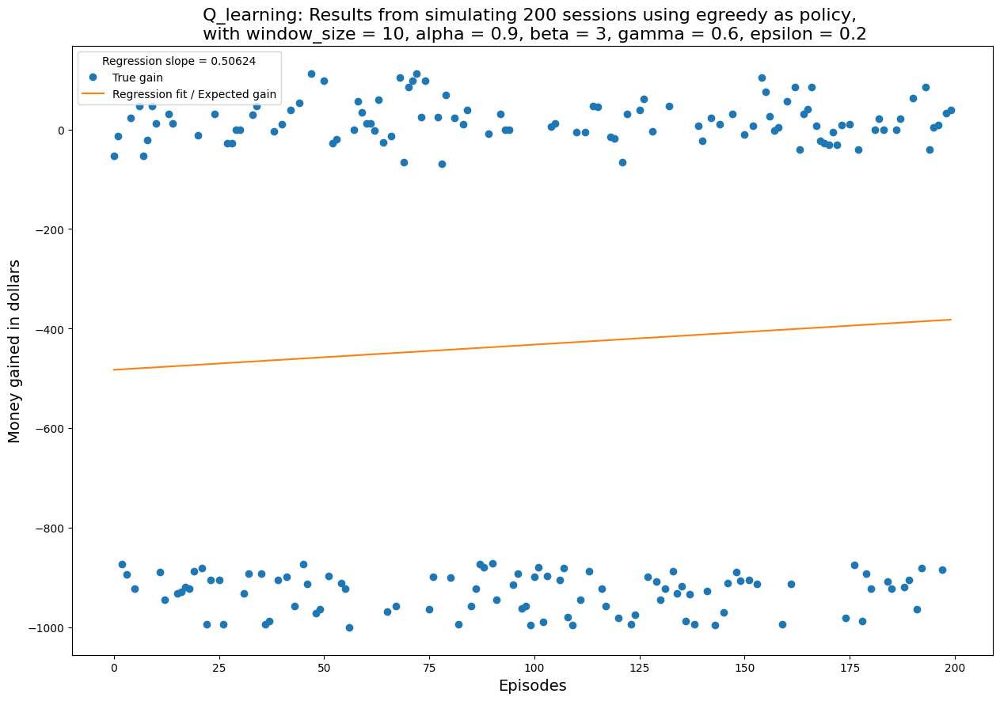

[]

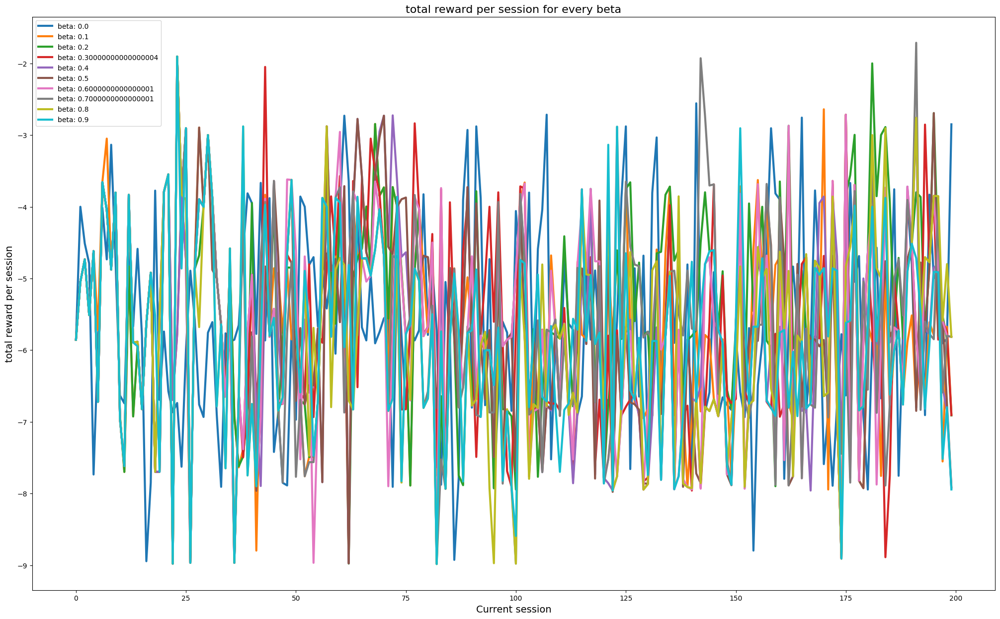

In [12]:
rewards_list = []
alphas = []

for i in range(0, 10):
    alpha = i*0.1
    alphas.append(f"beta: {alpha}")
    rl_agent = RL_Agent(alpha = alpha, gamma = 0.6, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="egreedy", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(alphas)
ax1.plot()

### Gamma parameter
Now let's compare the different discount factors

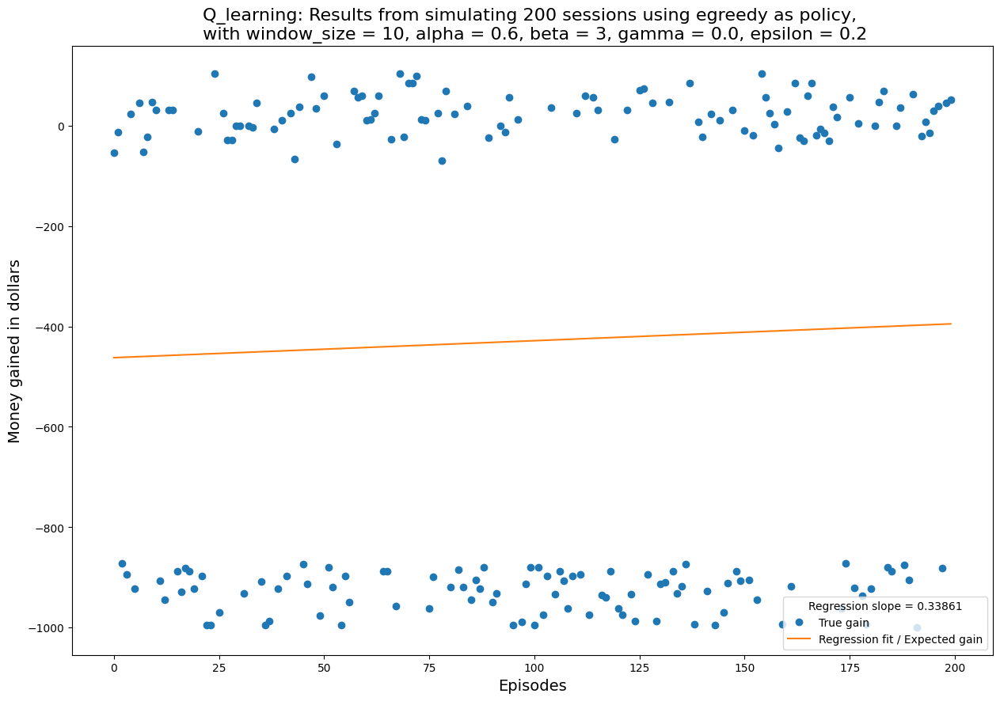

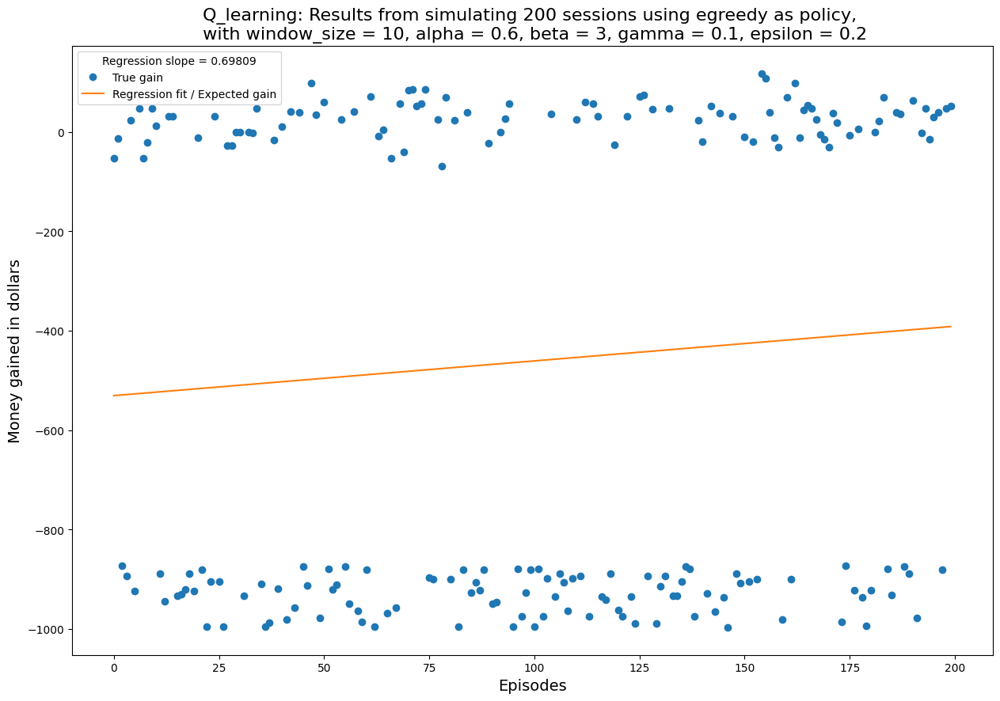

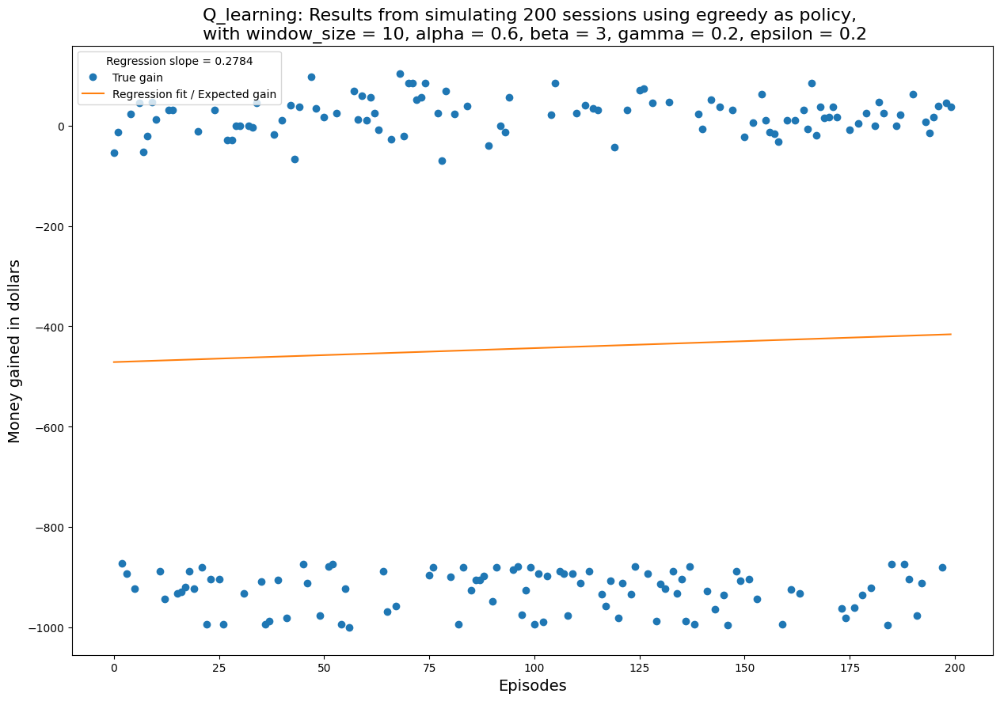

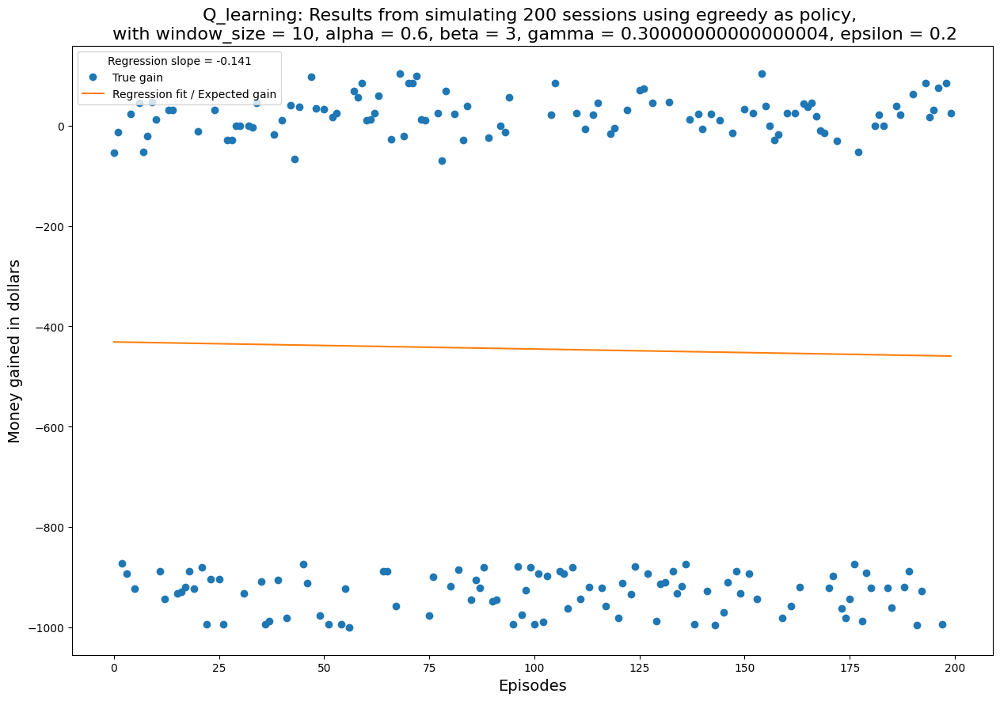

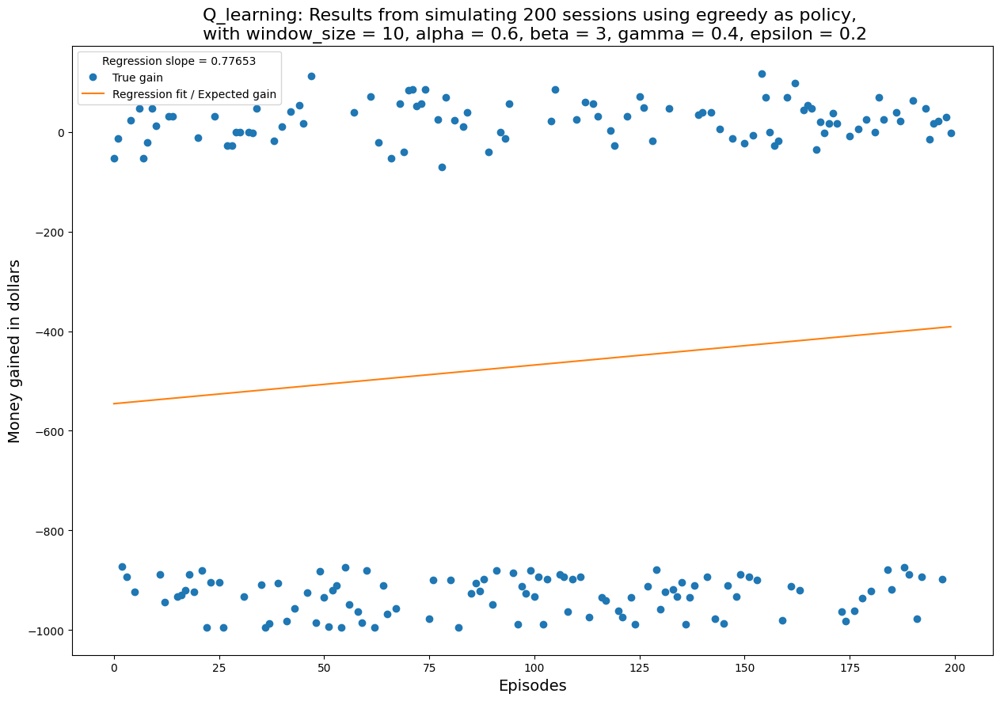

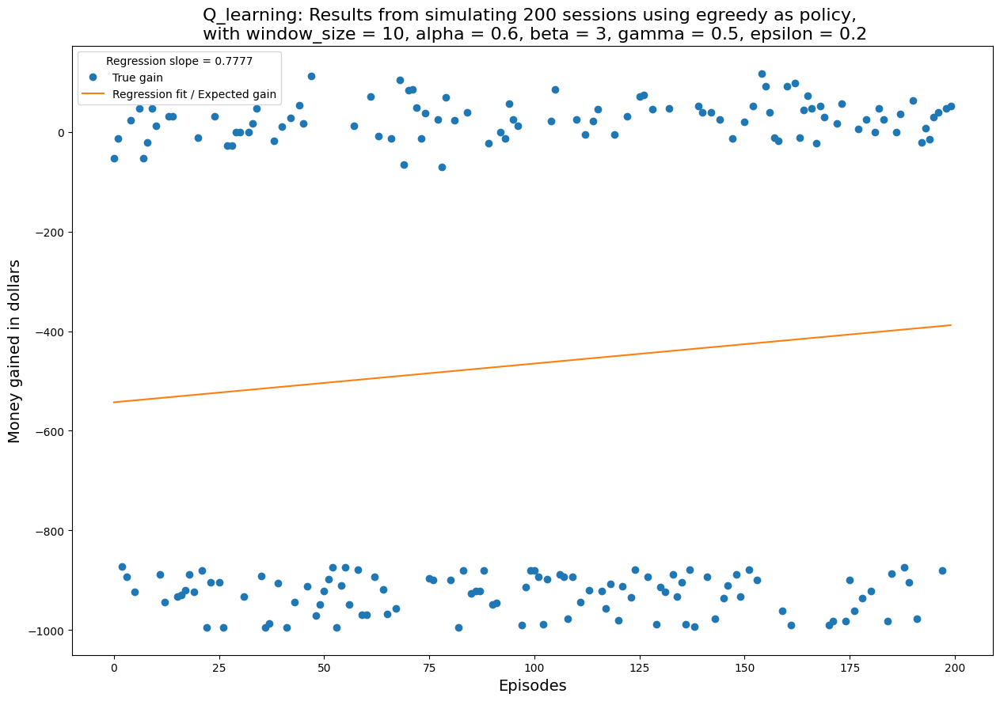

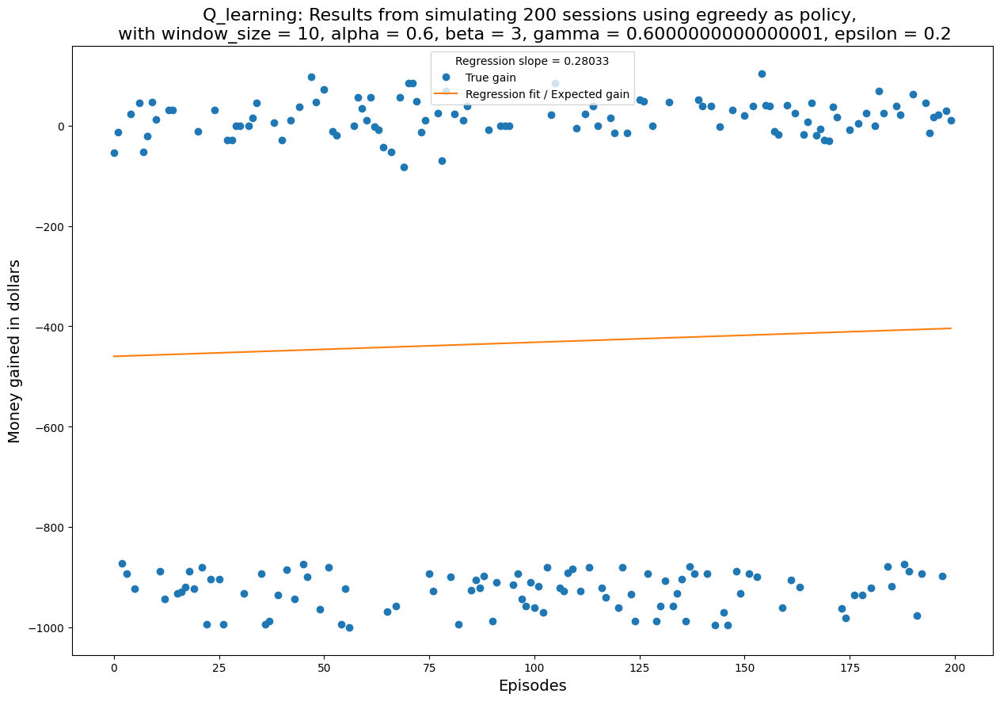

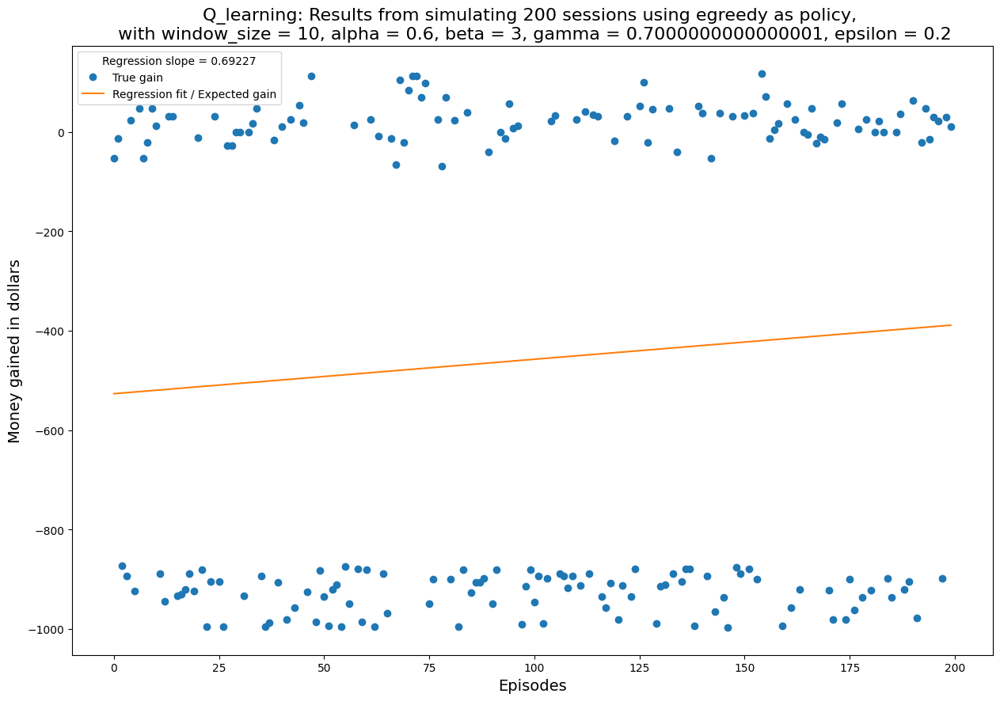

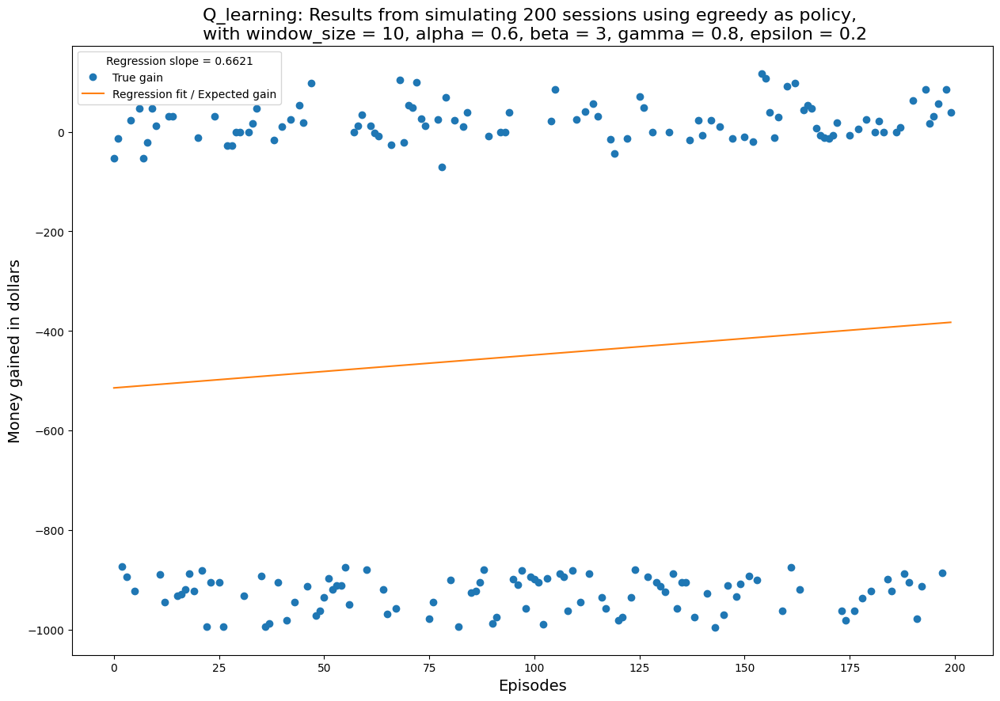

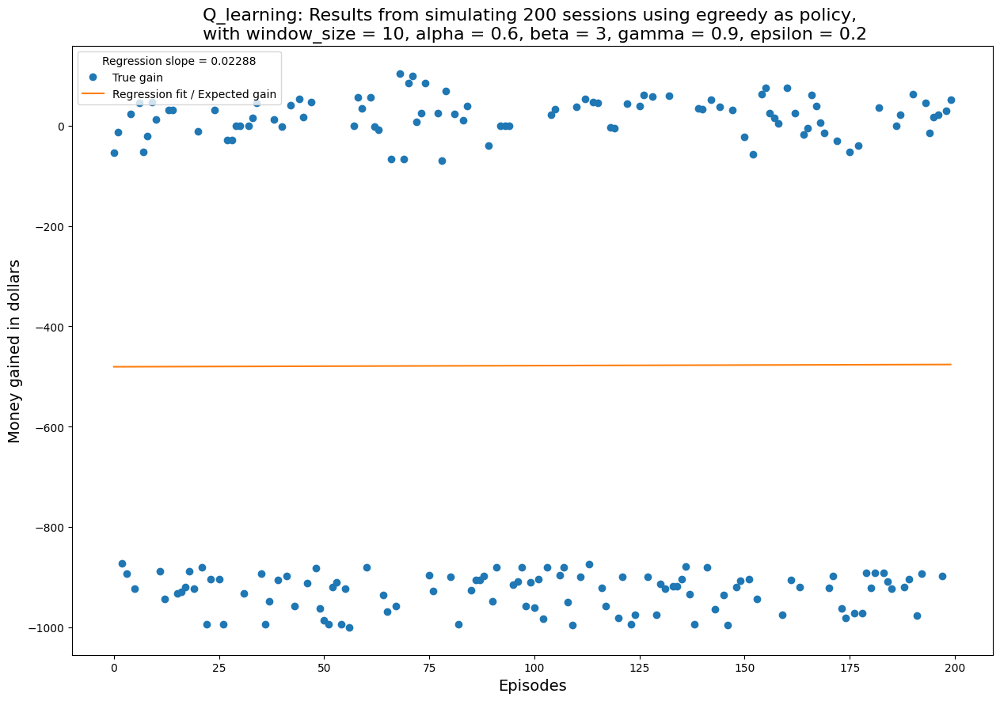

[]

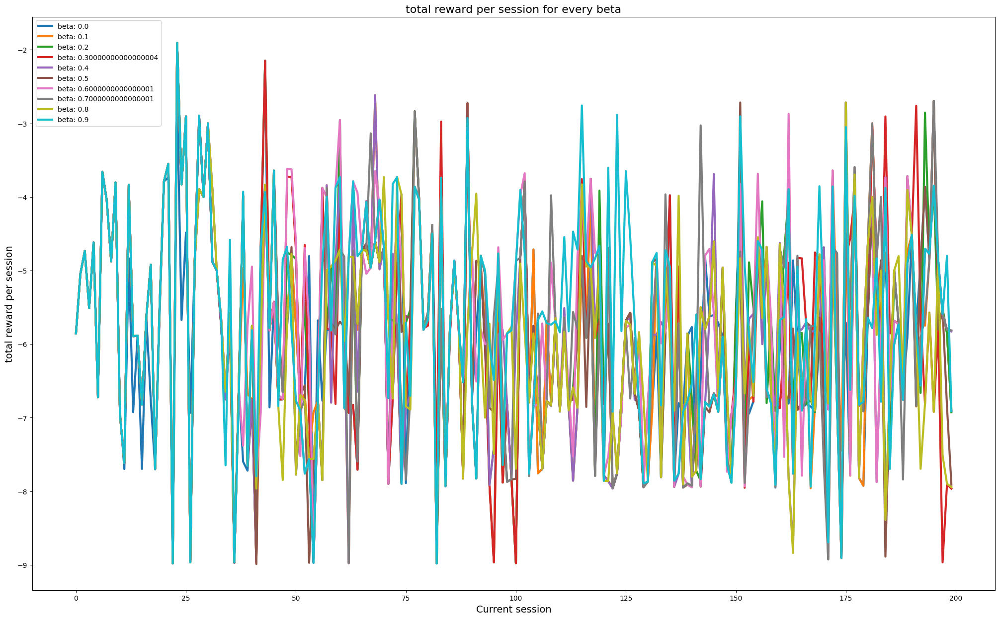

In [13]:
rewards_list = []
gammas = []

for i in range(0, 10):
    gamma = i*0.1
    gammas.append(f"beta: {gamma}")
    rl_agent = RL_Agent(alpha = 0.6, gamma = gamma, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="egreedy", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(gammas)
ax1.plot()

## Evaluation of SARSA

### Softmax policy

#### Beta parameter


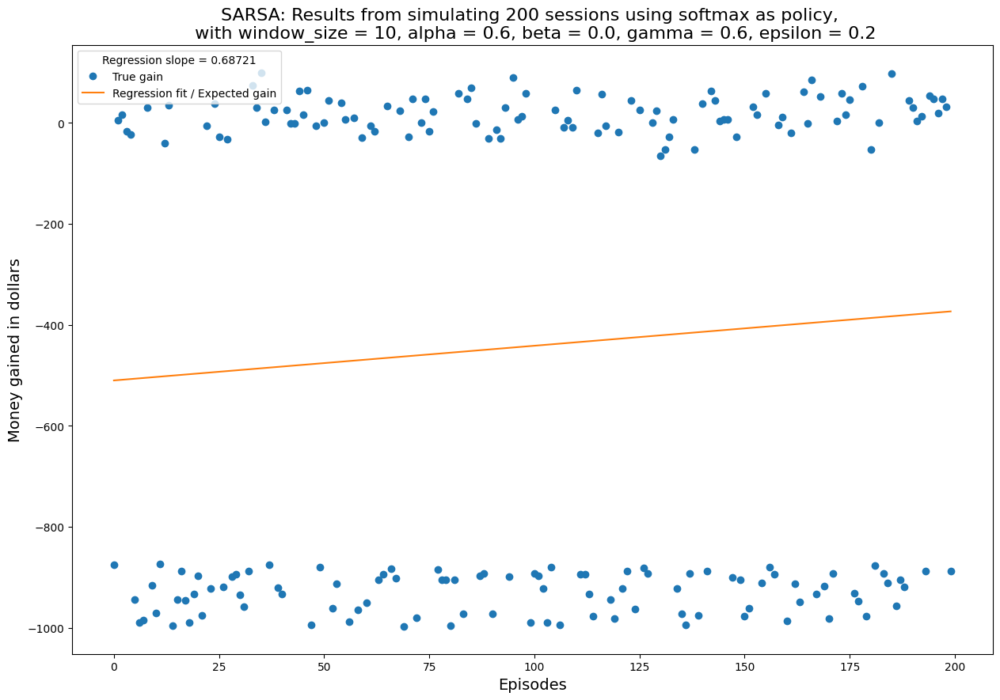

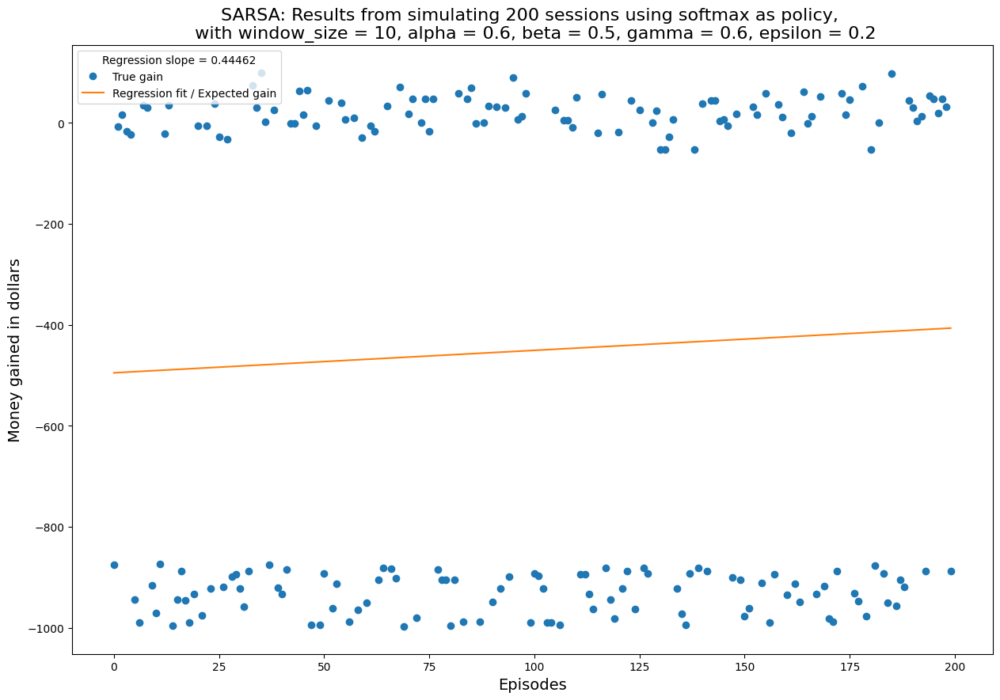

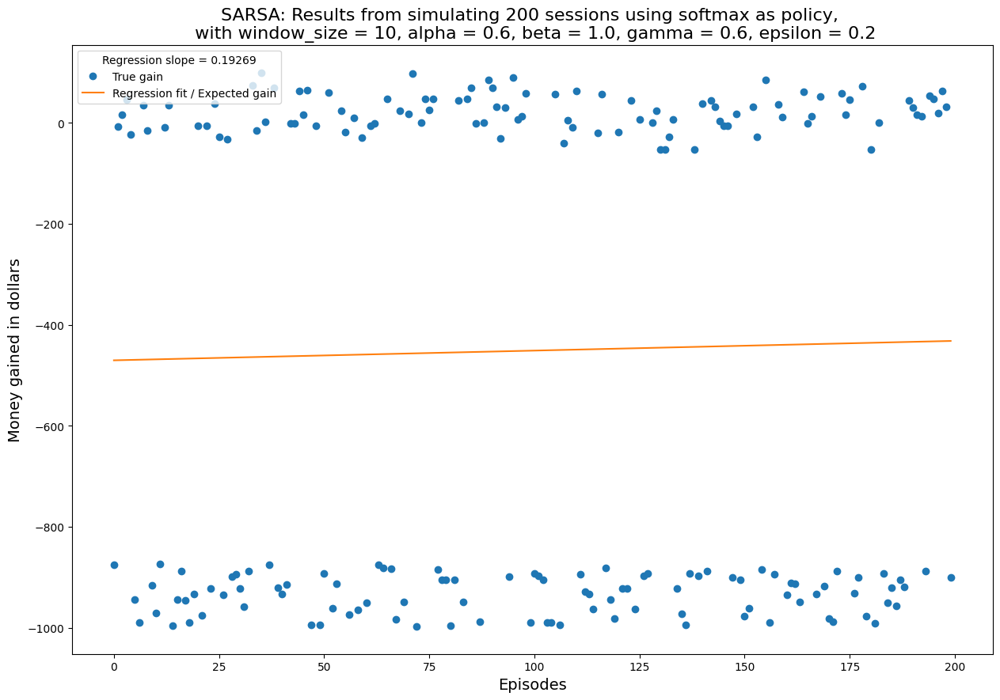

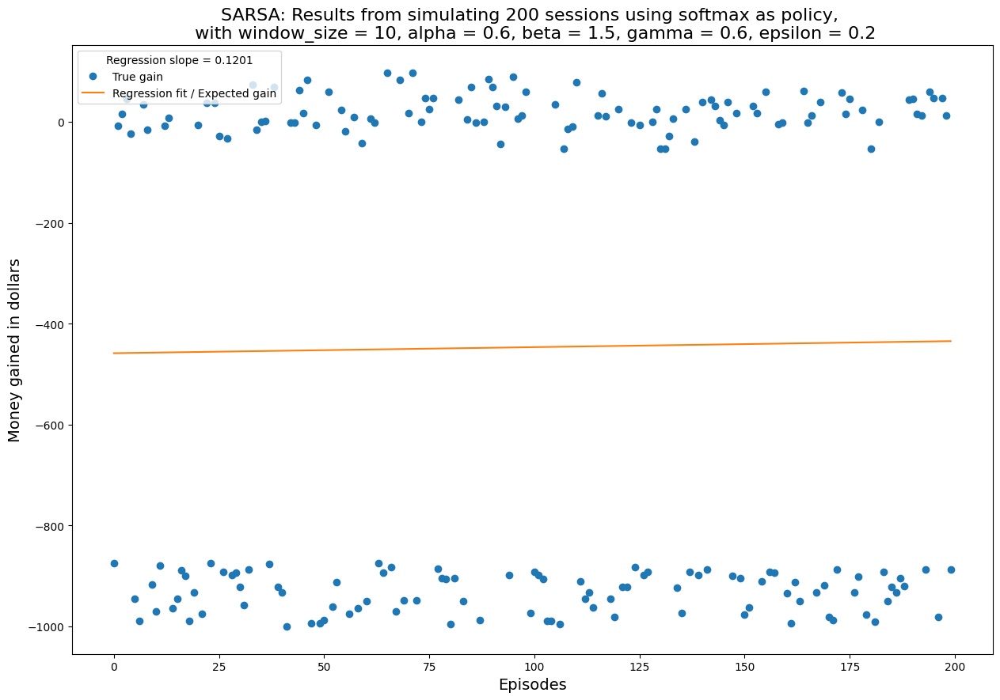

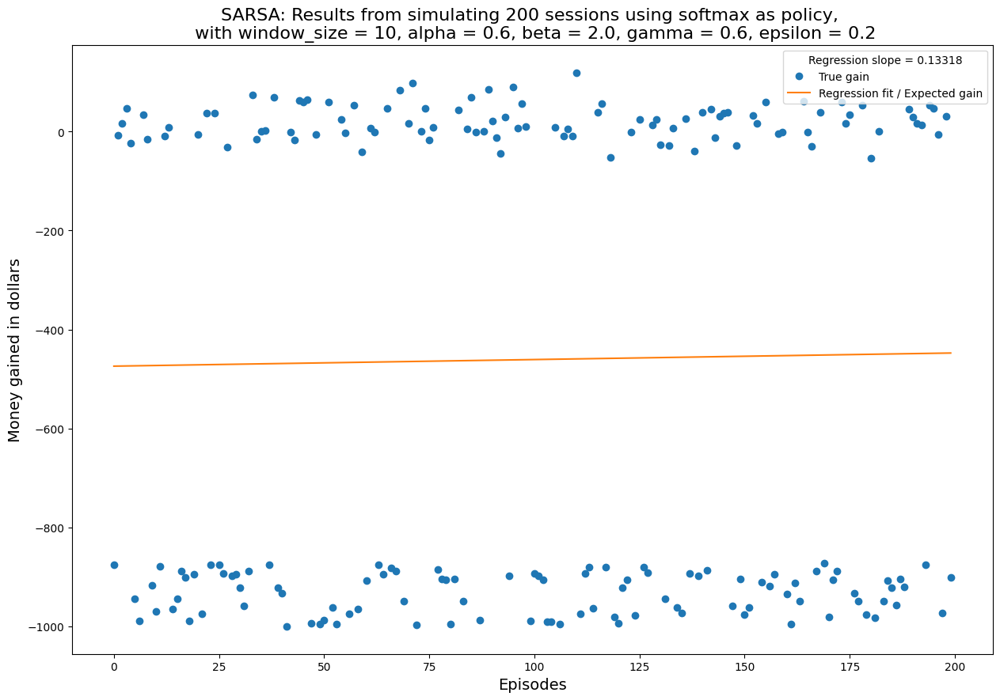

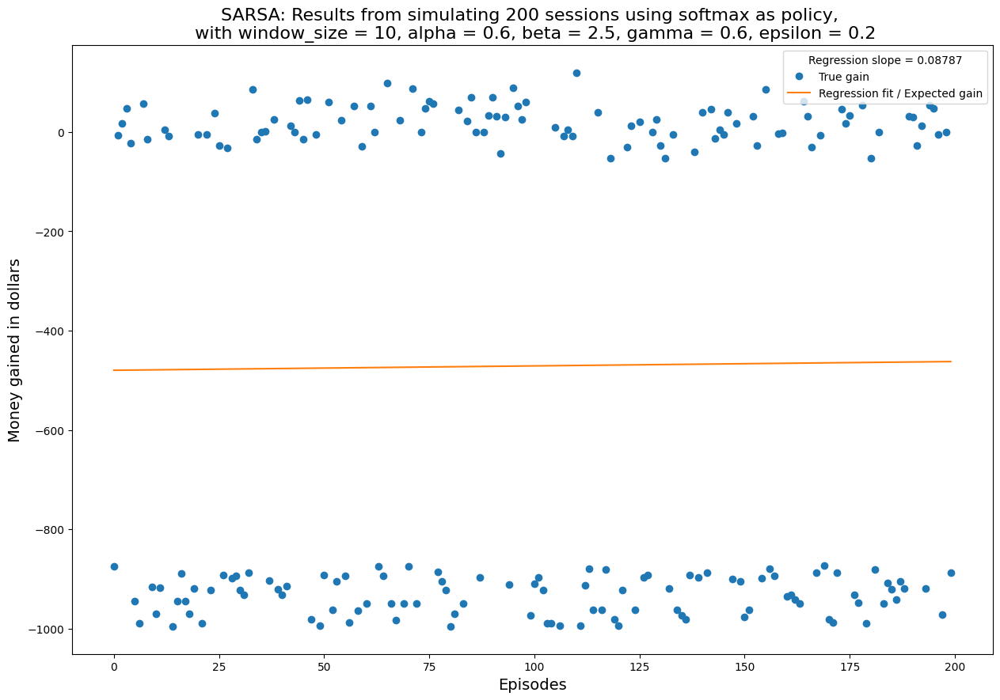

[]

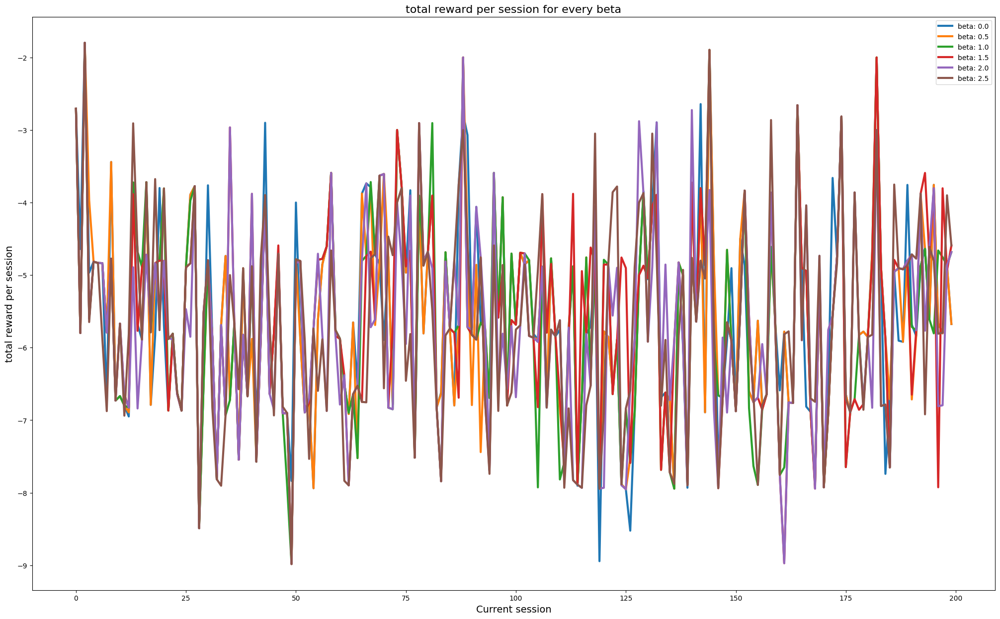

In [14]:
rewards_list = []
betas = []

for i in range(0, 6):
    beta = i*0.5
    betas.append(f"beta: {beta}")
    rl_agent = RL_Agent(alpha = 0.6, gamma = 0.6, sarsa=True, epsilon = 0.2, beta=beta, data=data_window, assets=1000 , policy="softmax", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(betas)
ax1.plot()

#### Alpha parameter
Now let's compare the different learning rates

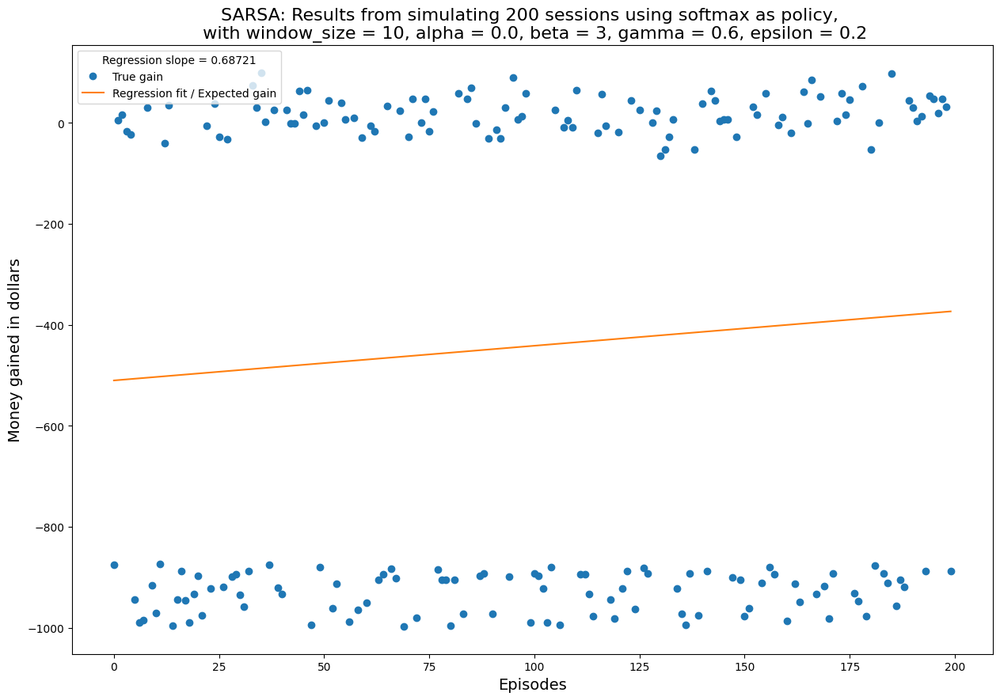

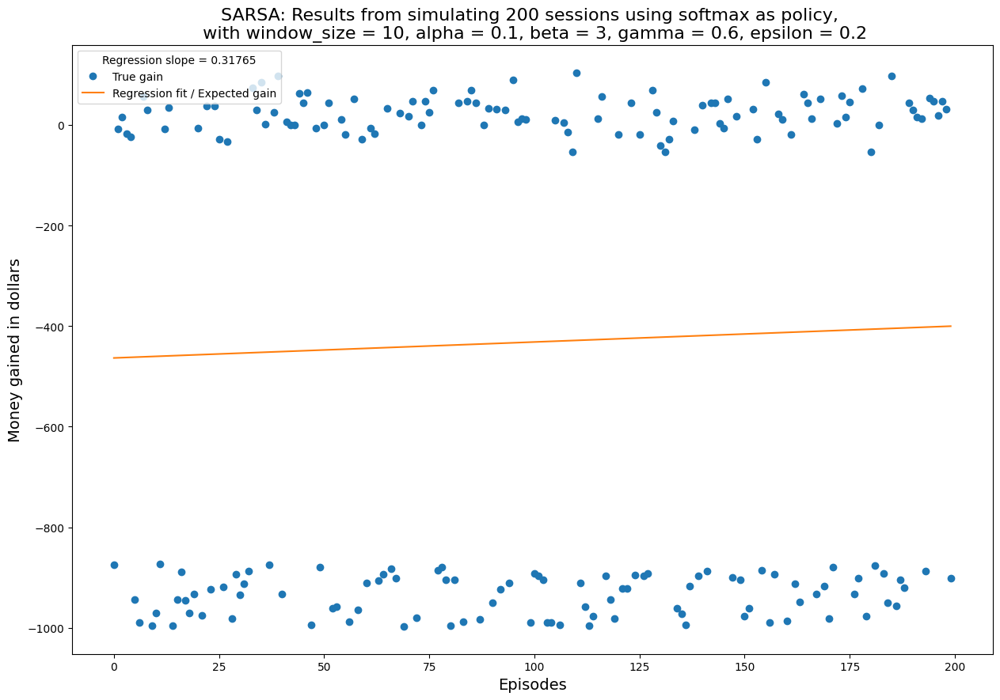

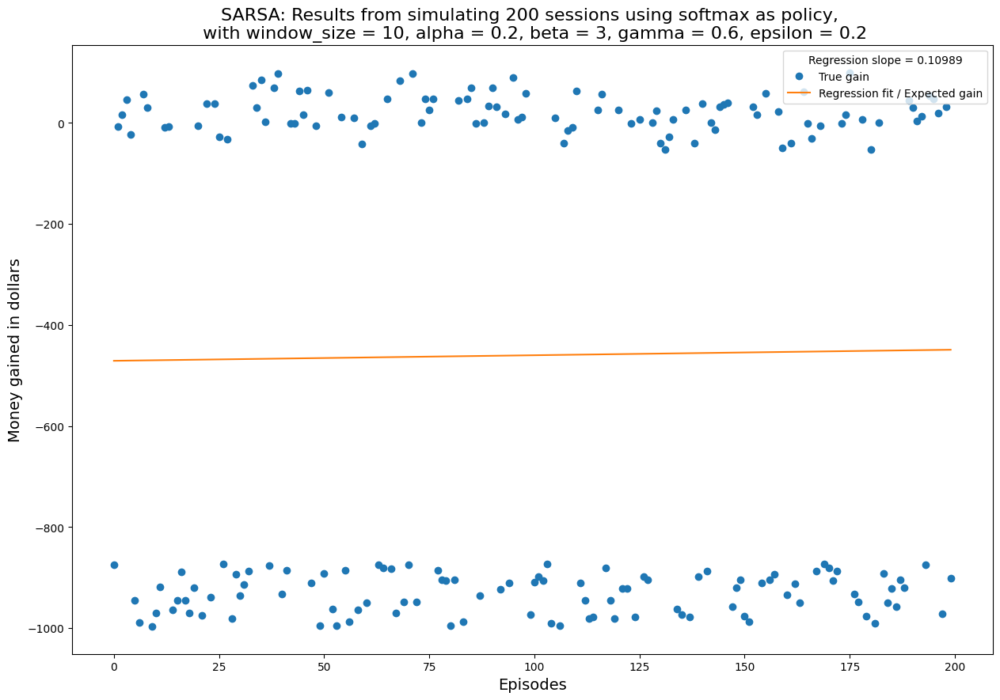

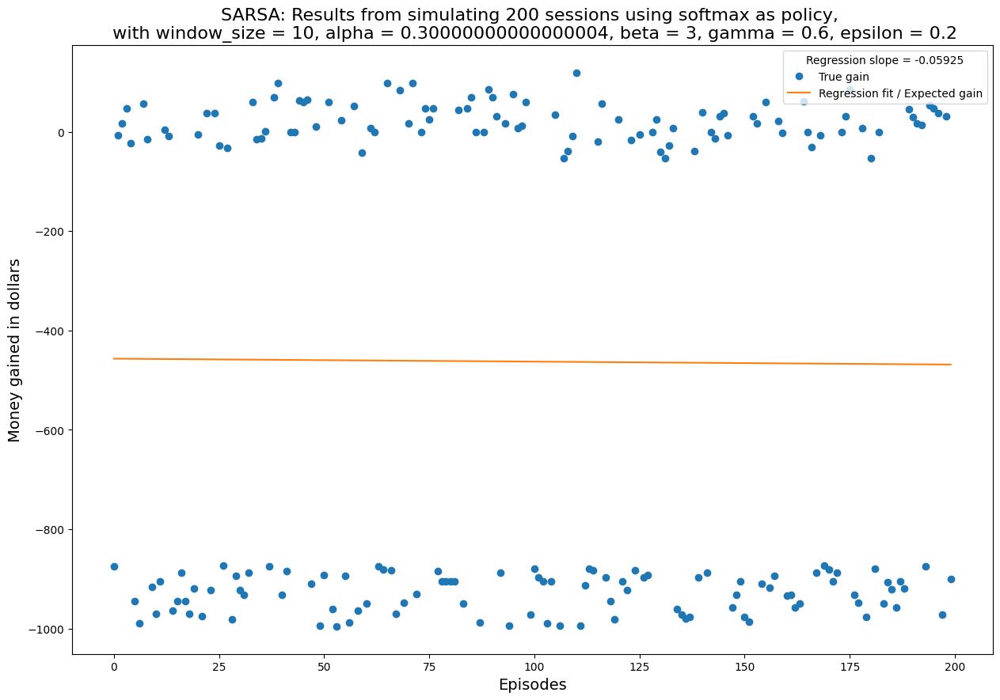

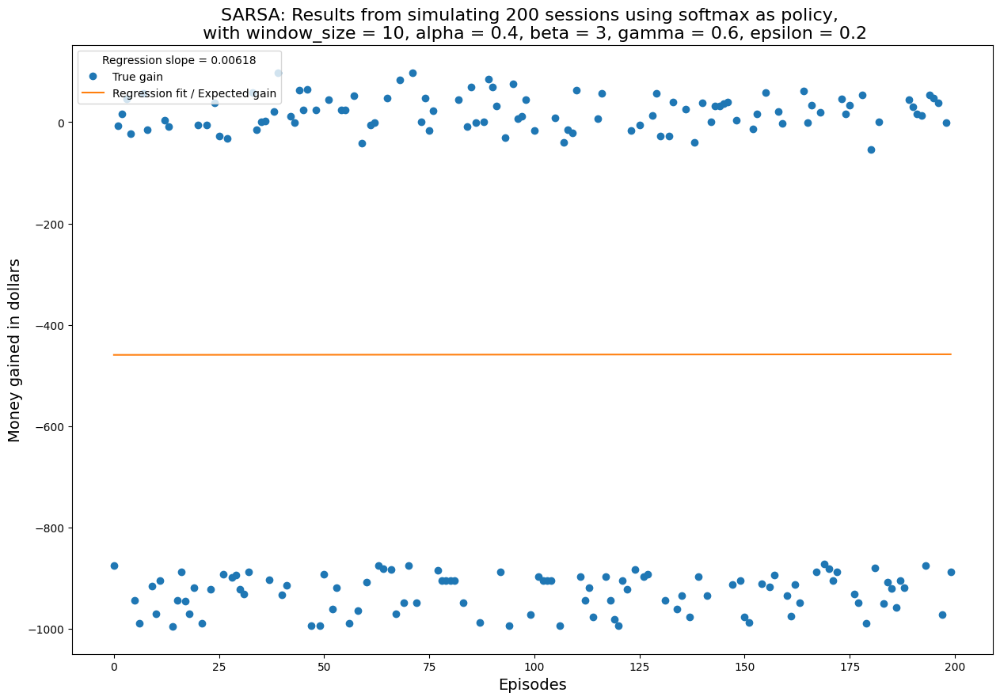

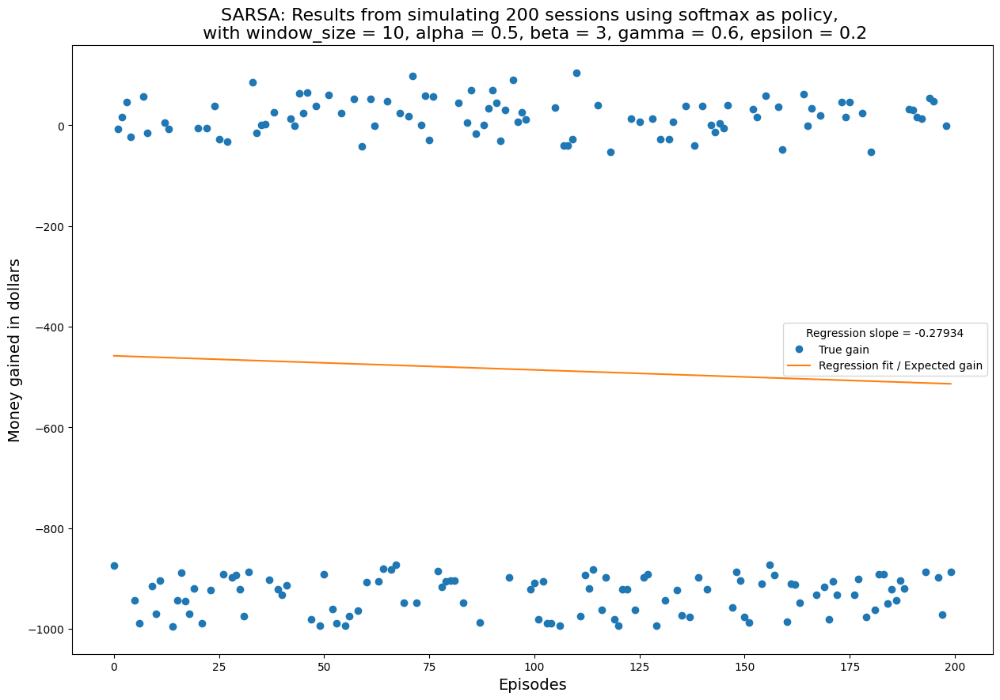

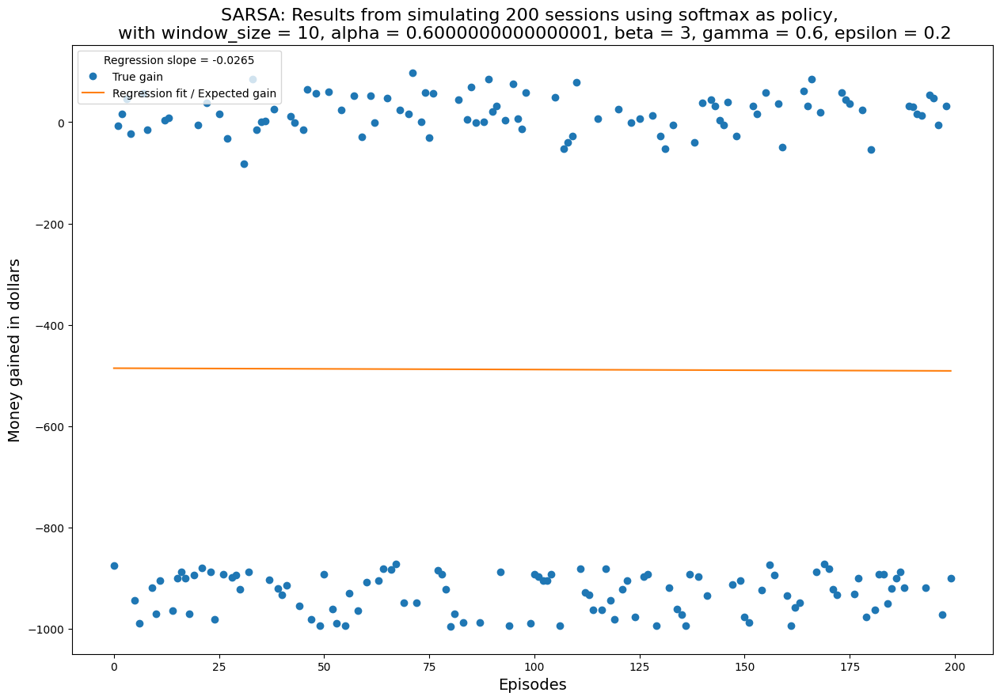

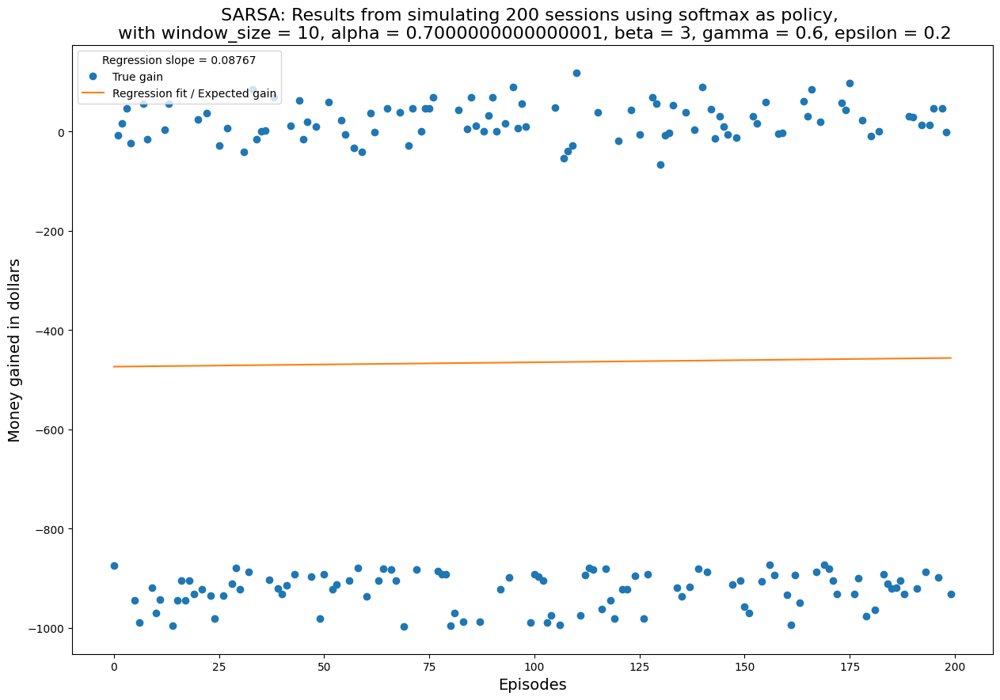

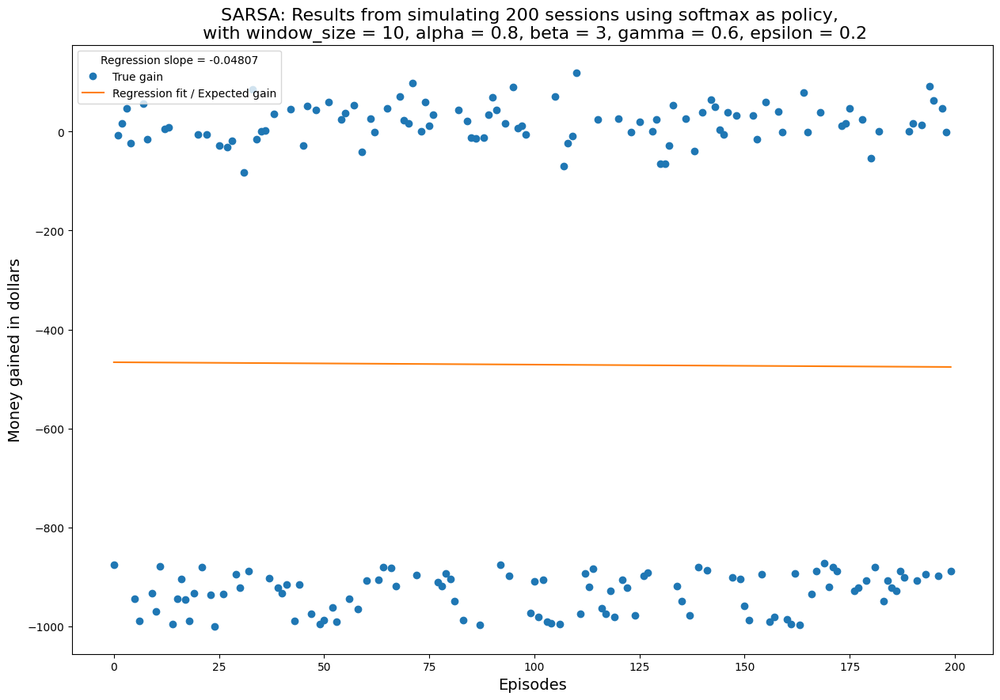

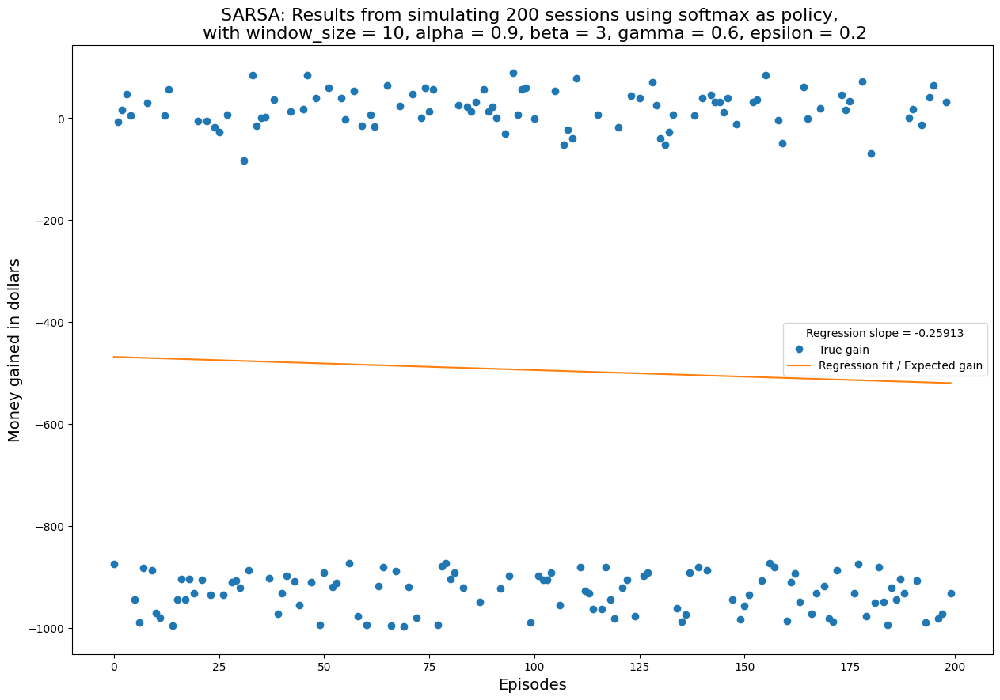

[]

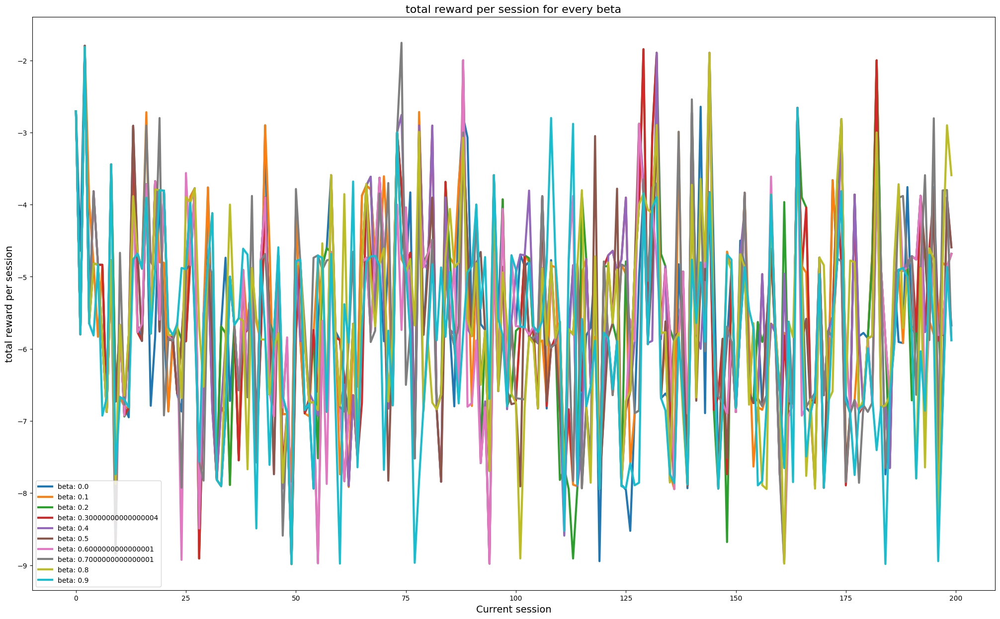

In [15]:
rewards_list = []
alphas = []

for i in range(0, 10):
    alpha = i*0.1
    alphas.append(f"beta: {alpha}")
    rl_agent = RL_Agent(alpha = alpha, gamma = 0.6, sarsa=True, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="softmax", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(alphas)
ax1.plot()

#### Gamma parameter
Now let's compare the different discount factors

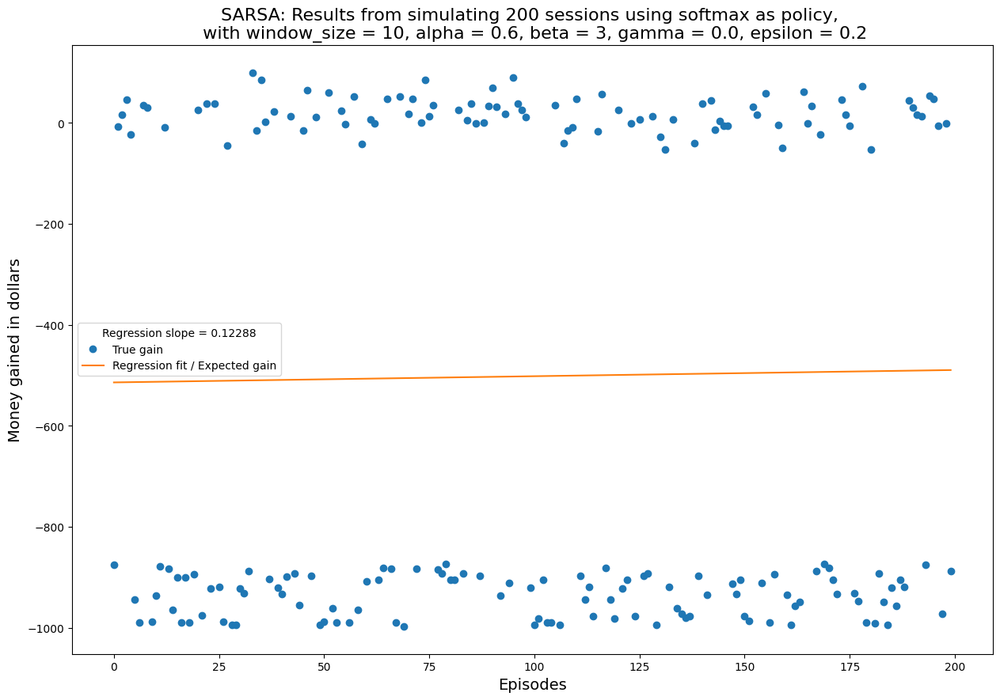

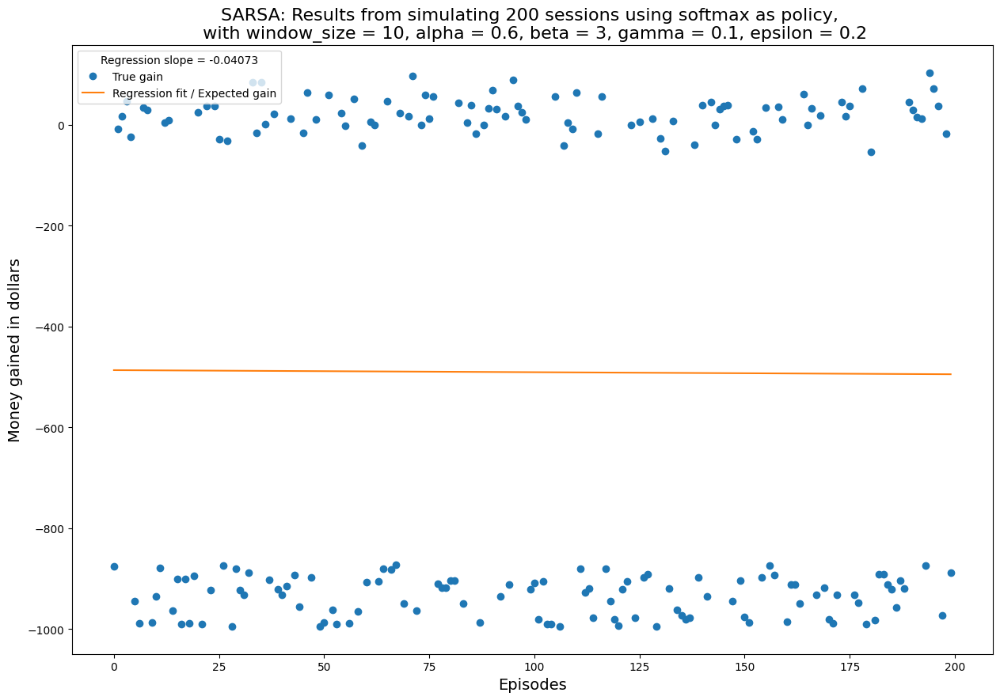

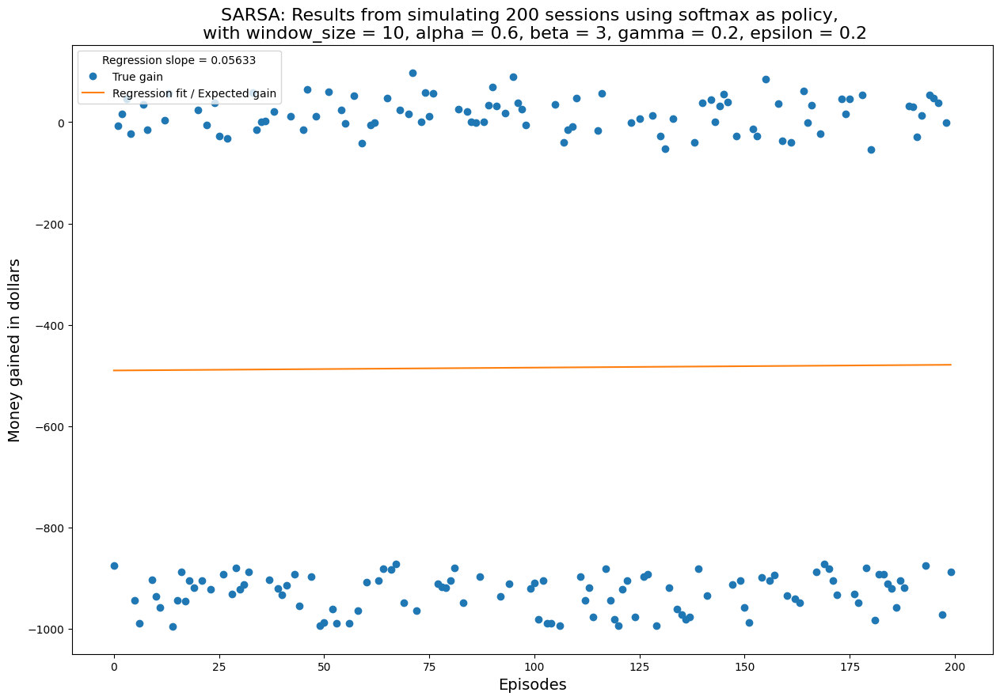

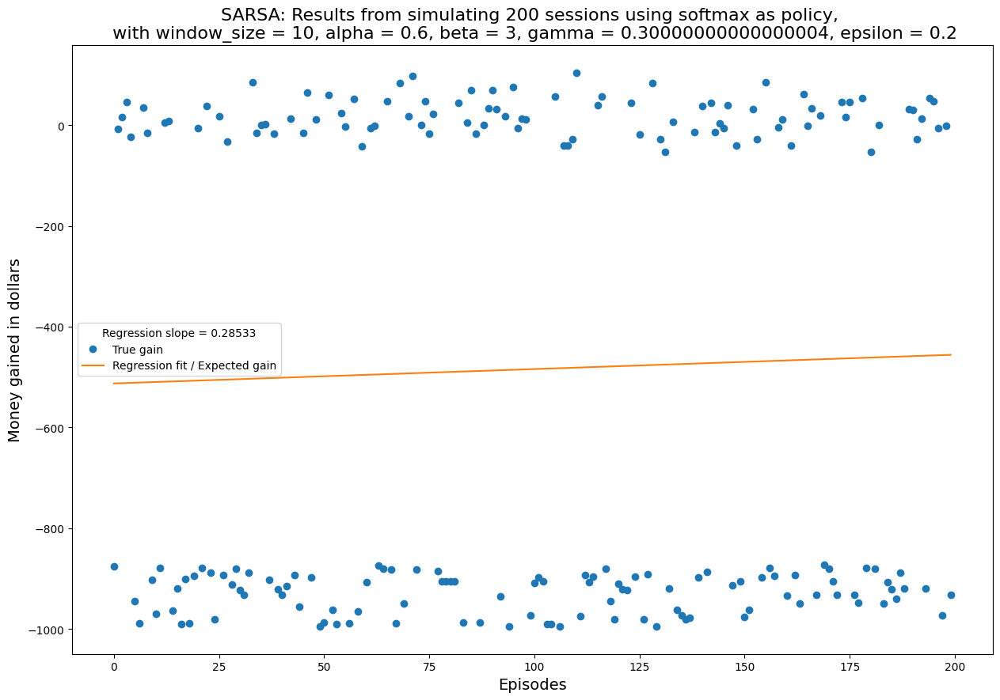

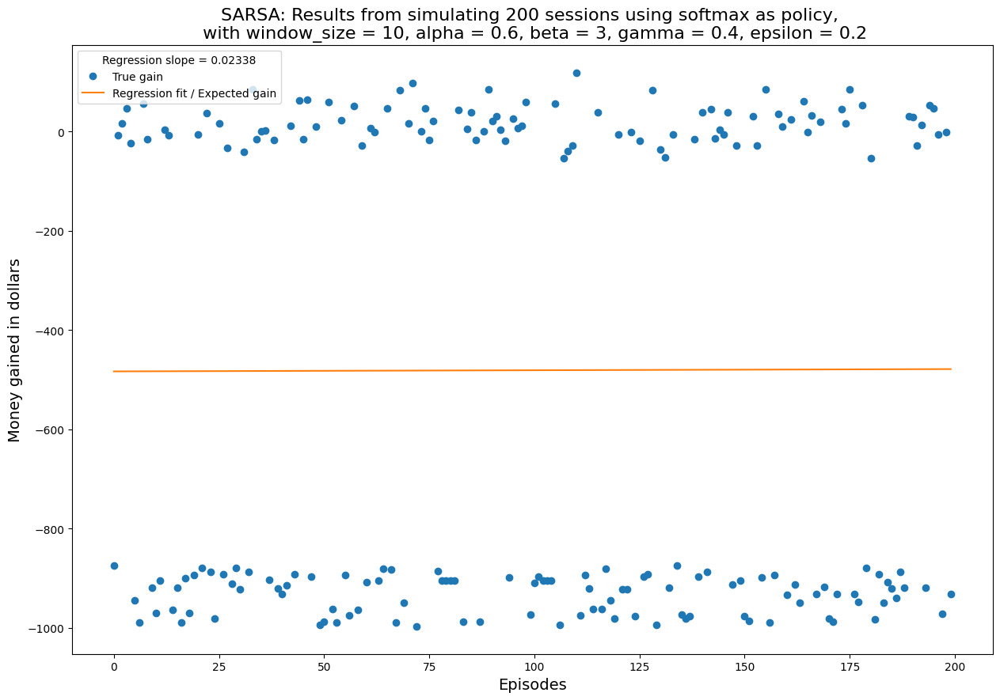

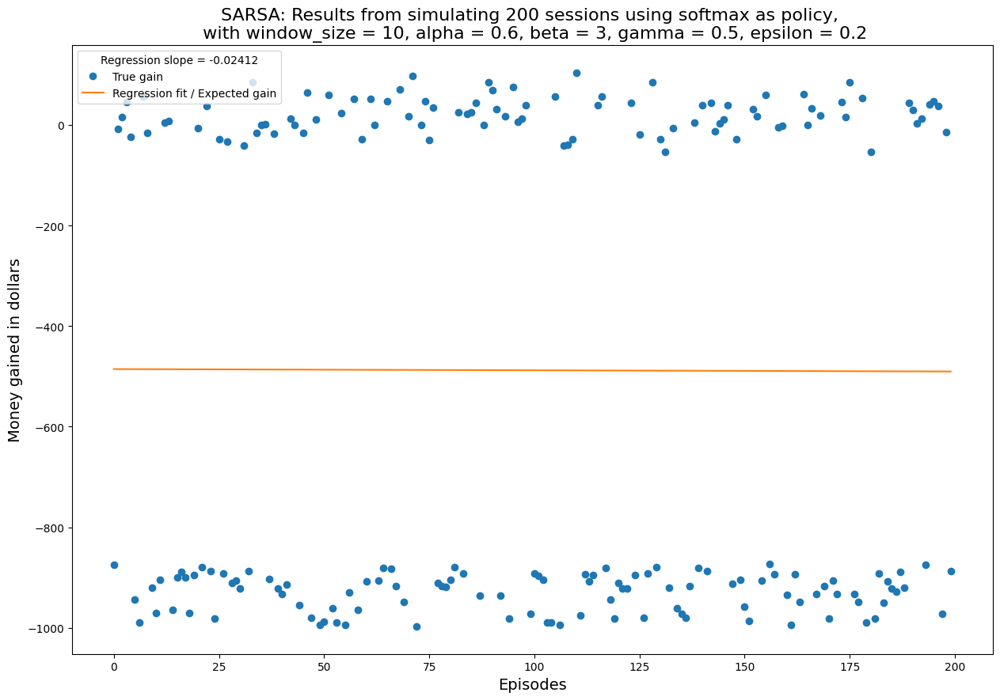

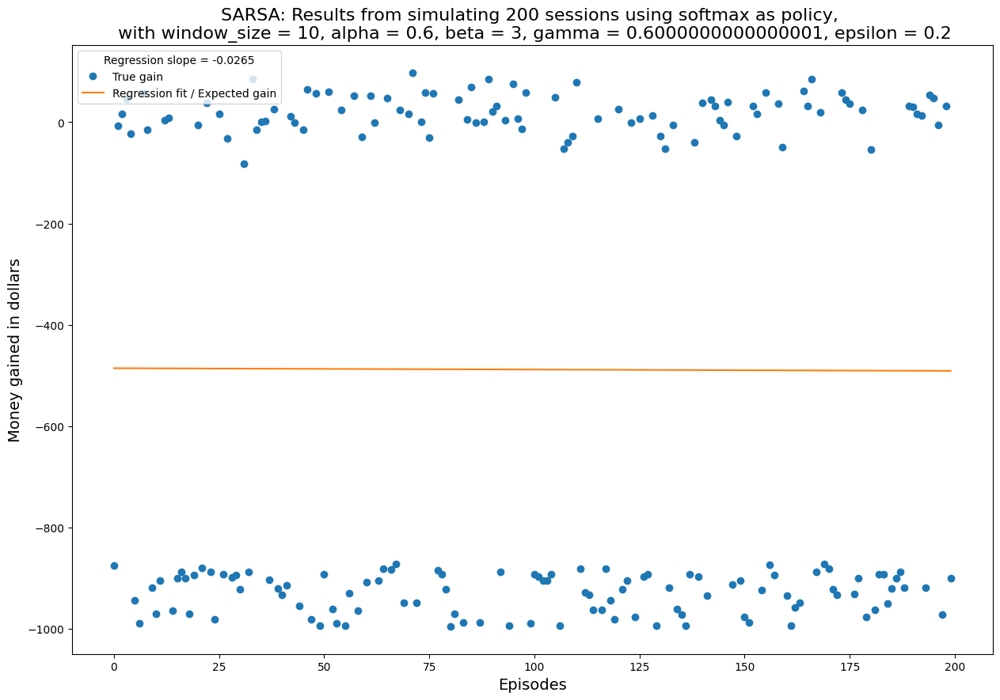

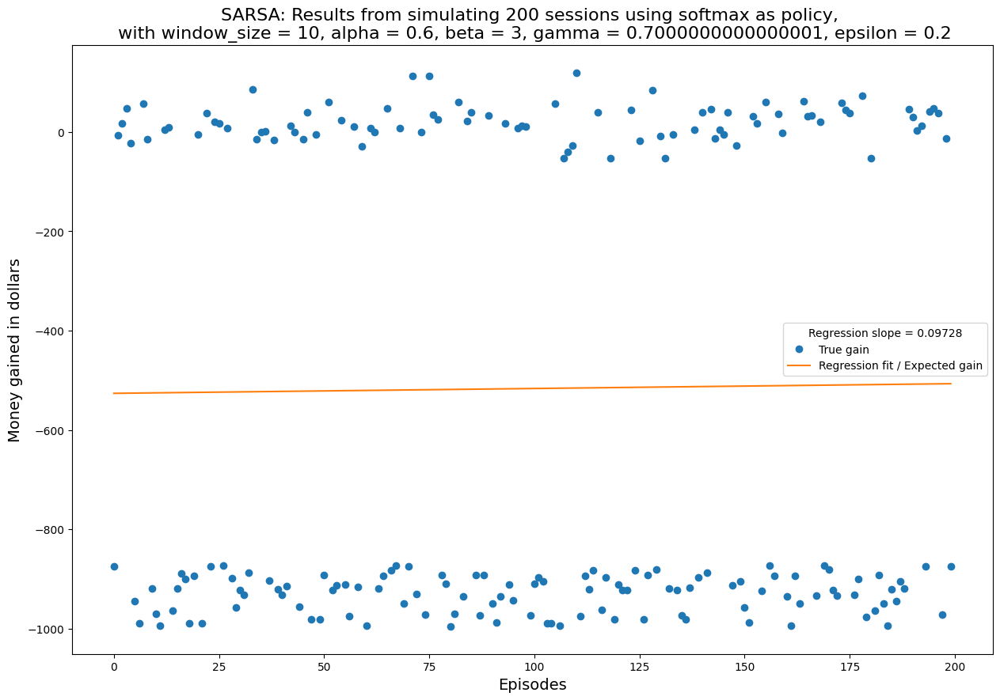

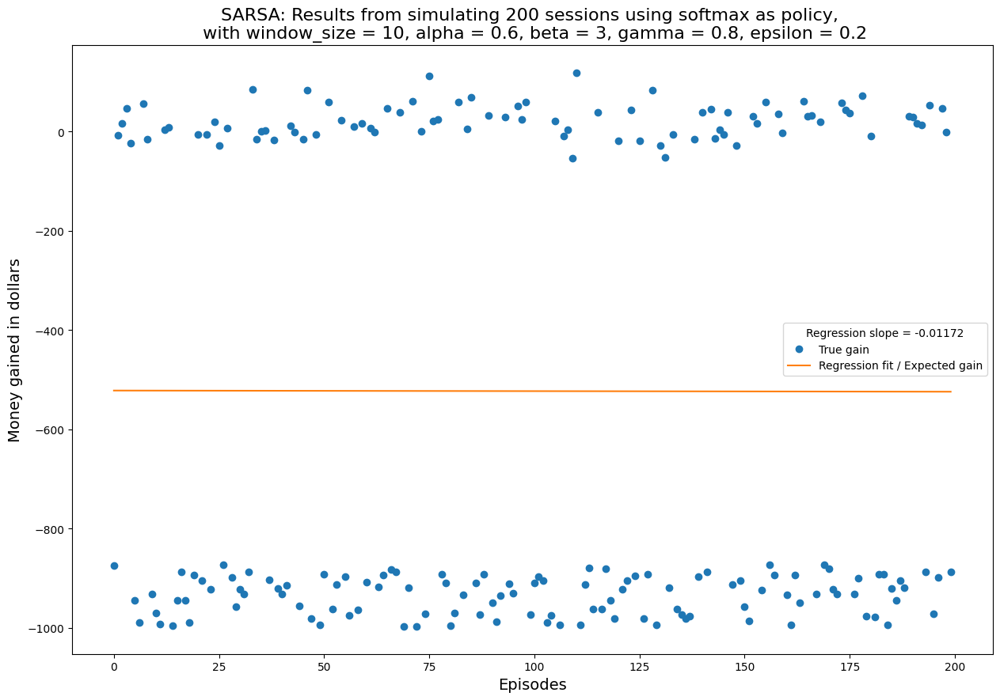

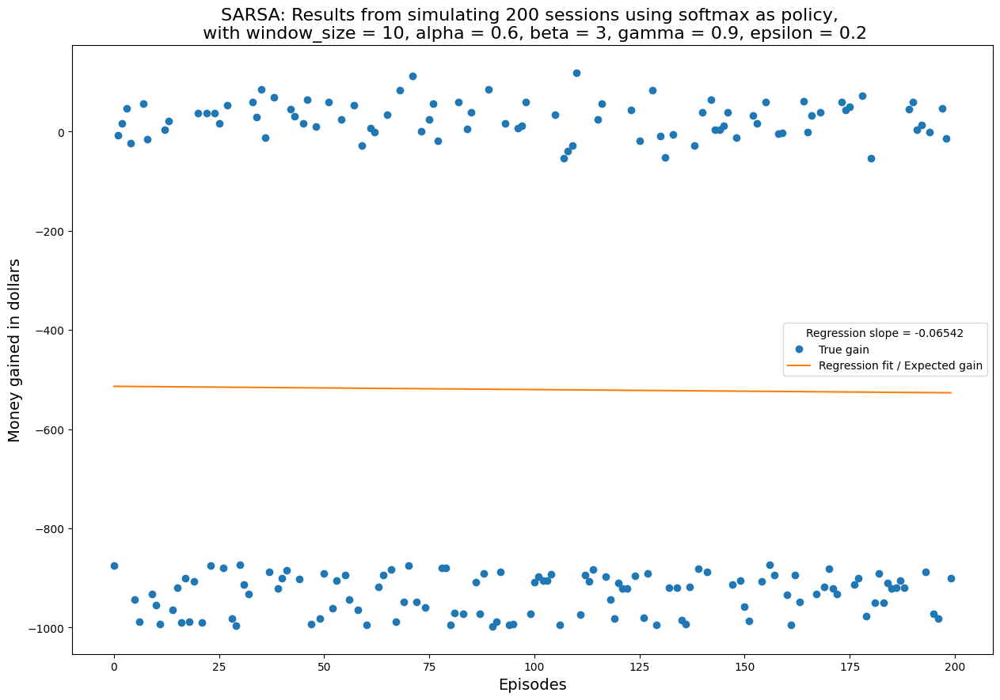

[]

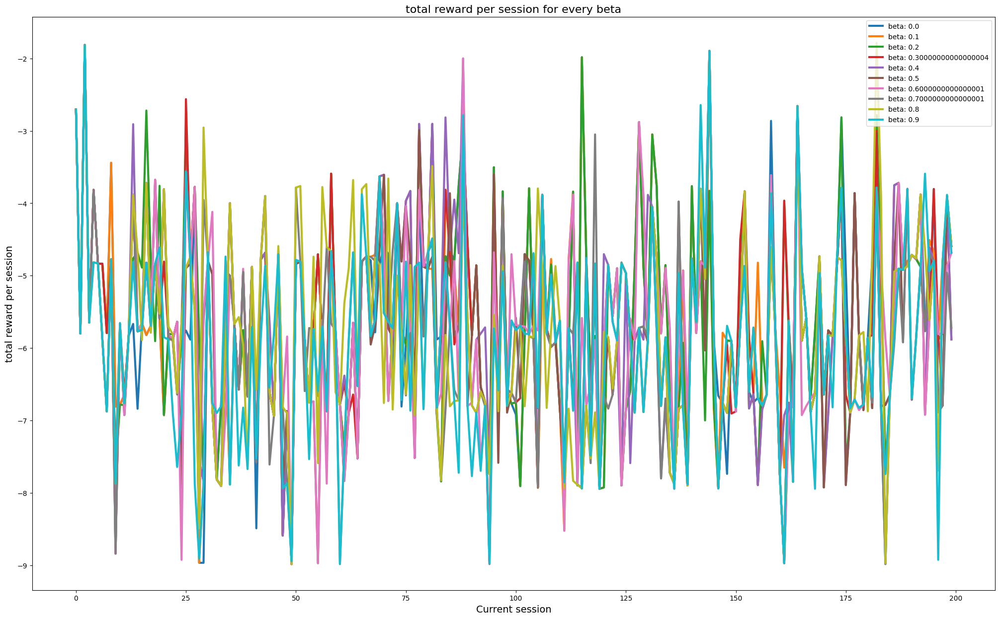

In [16]:
rewards_list = []
gammas = []

for i in range(0, 10):
    gamma = i*0.1
    gammas.append(f"beta: {gamma}")
    rl_agent = RL_Agent(alpha = 0.6, gamma = gamma, sarsa=True, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="softmax", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(gammas)
ax1.plot()

### Epsilon-greedy policy
#### Epsilon parameter
Now let's compare the different epsilons, it should be noted that when $\epsilon$ = 0 the policy is greedy

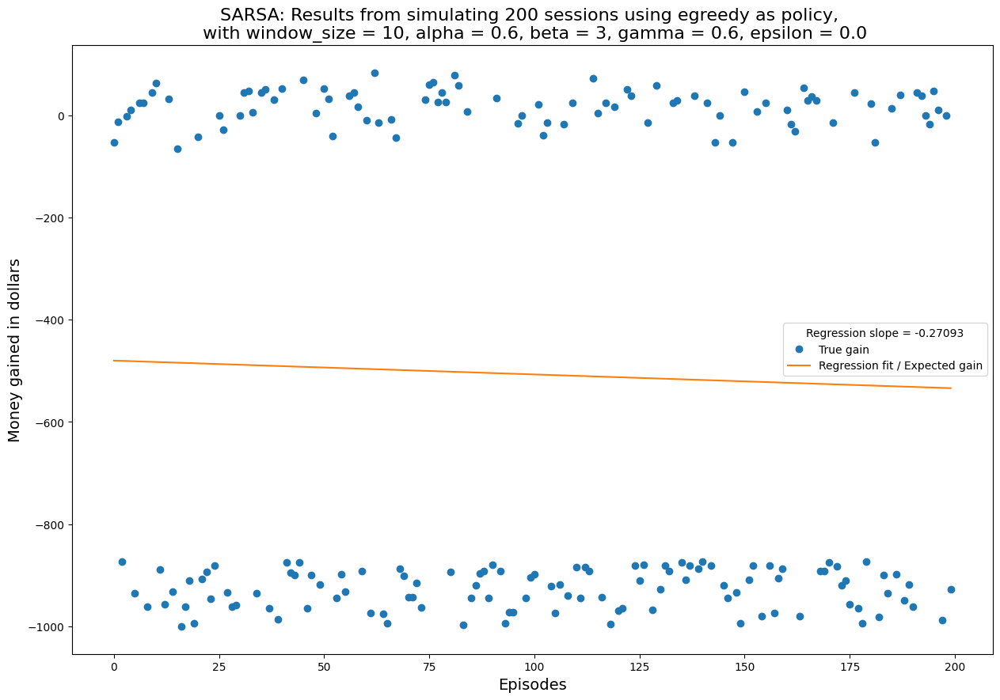

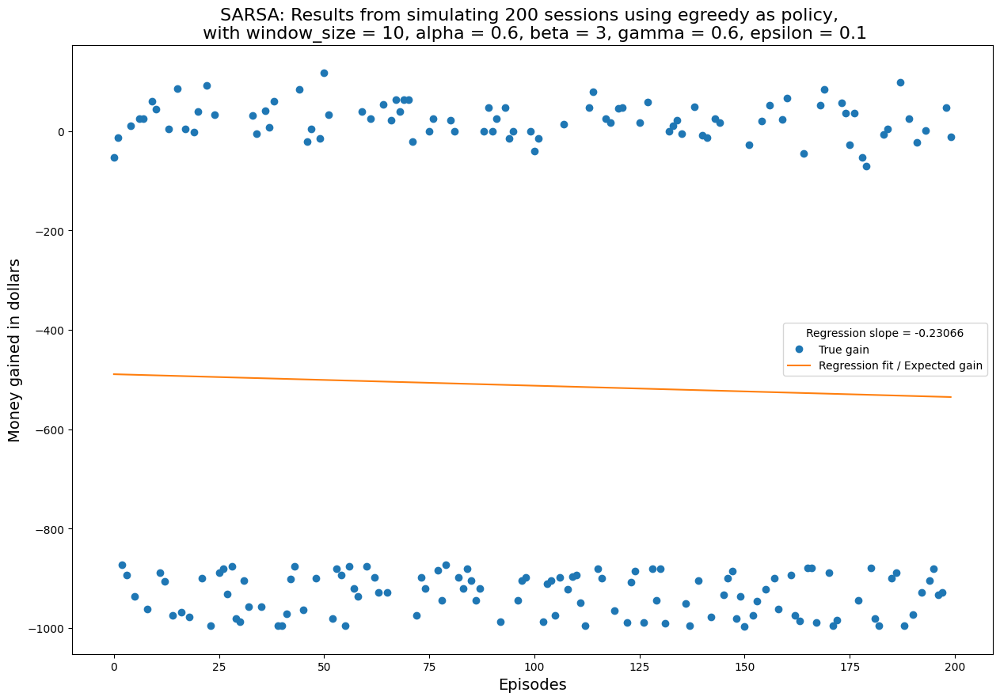

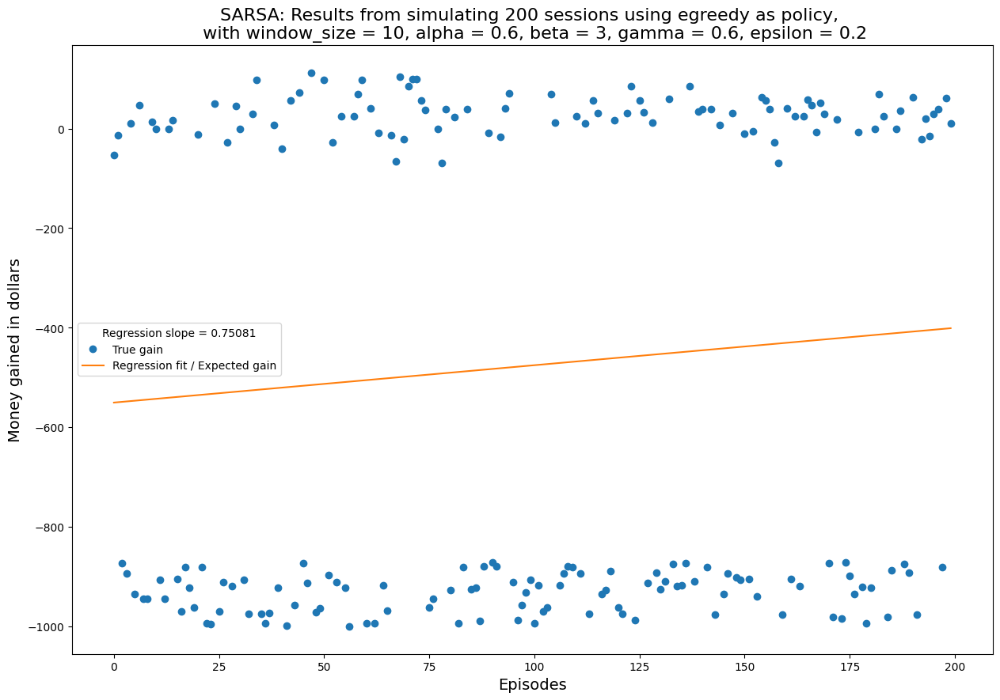

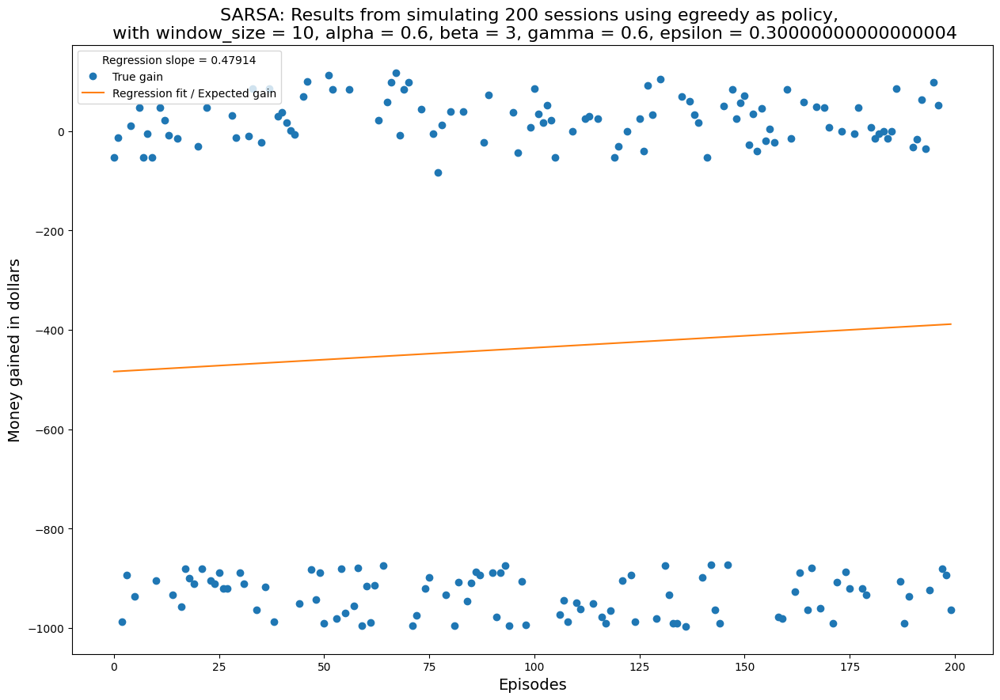

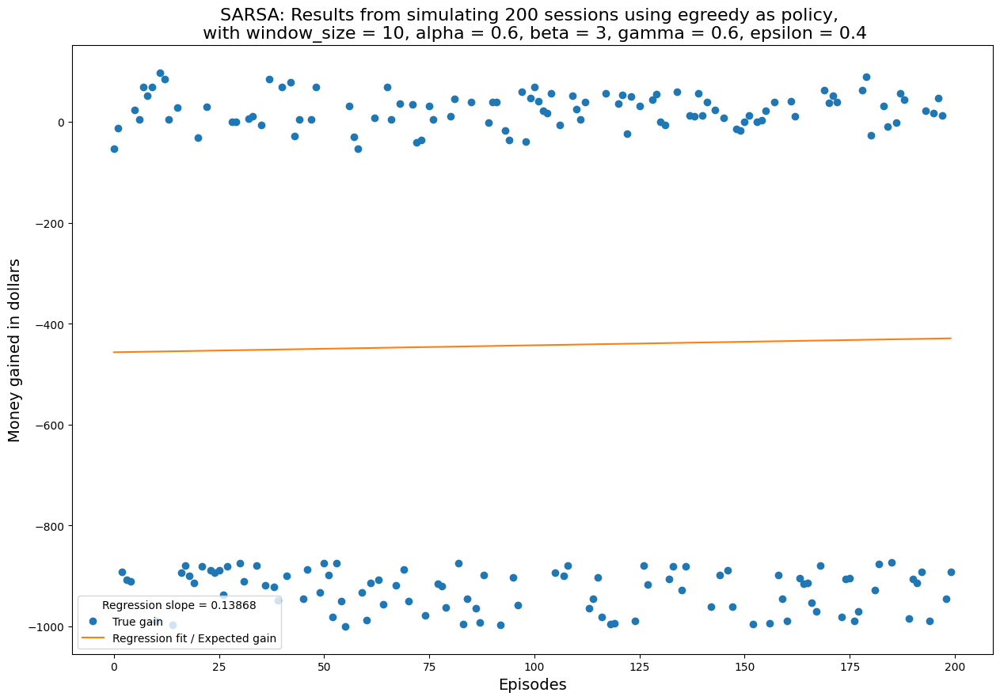

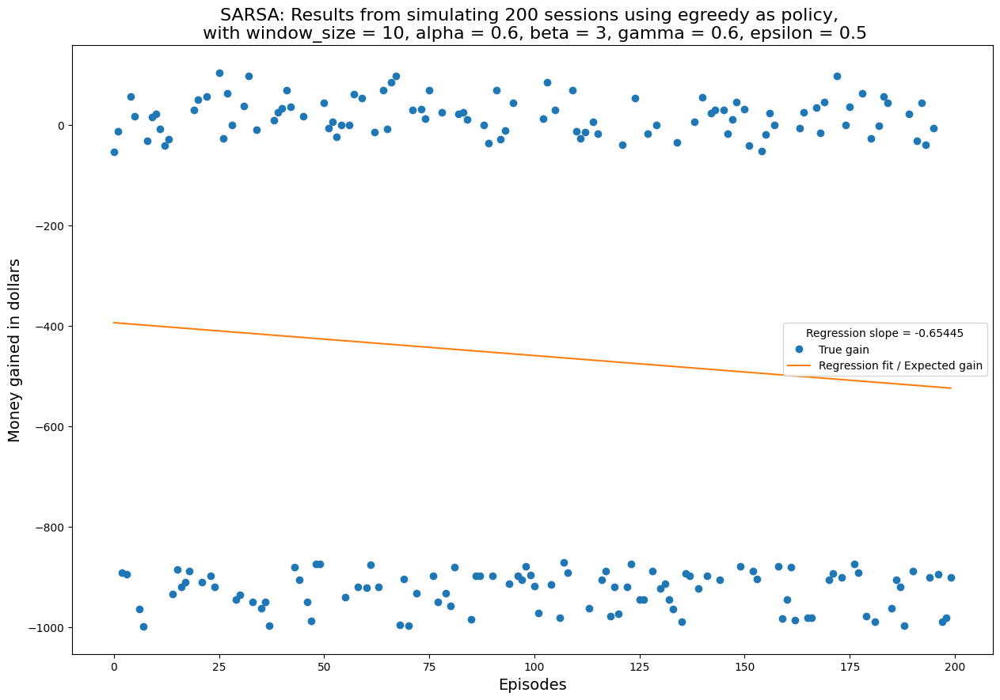

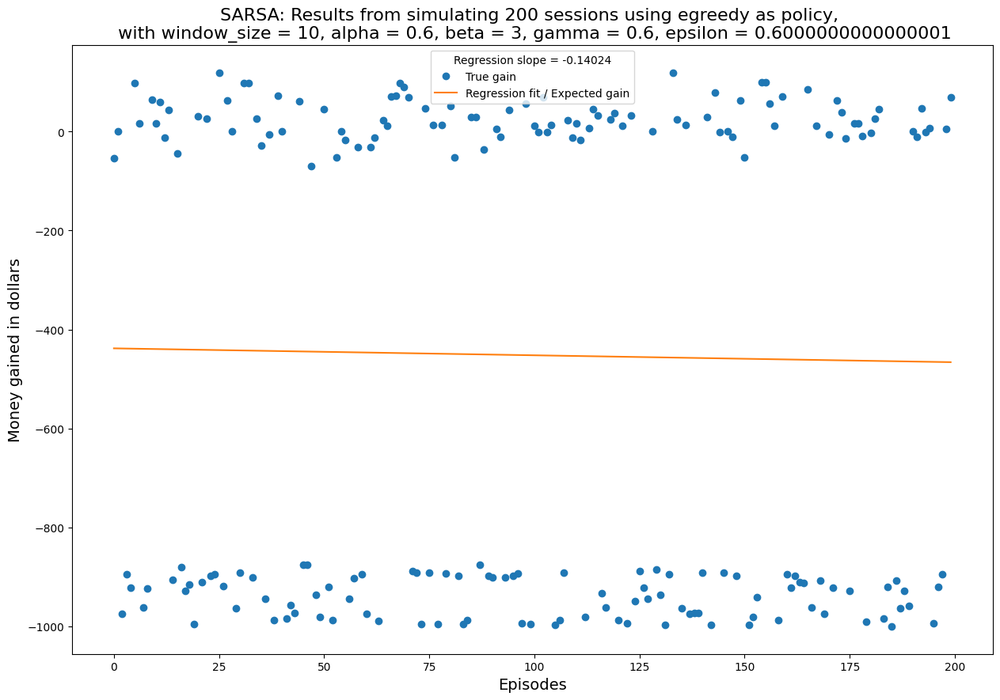

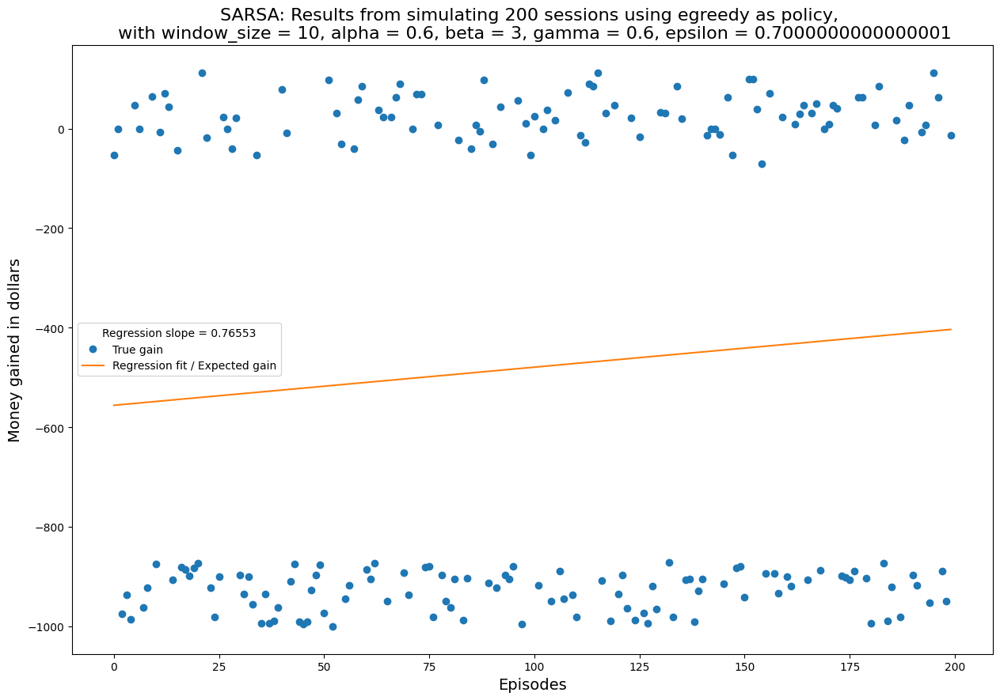

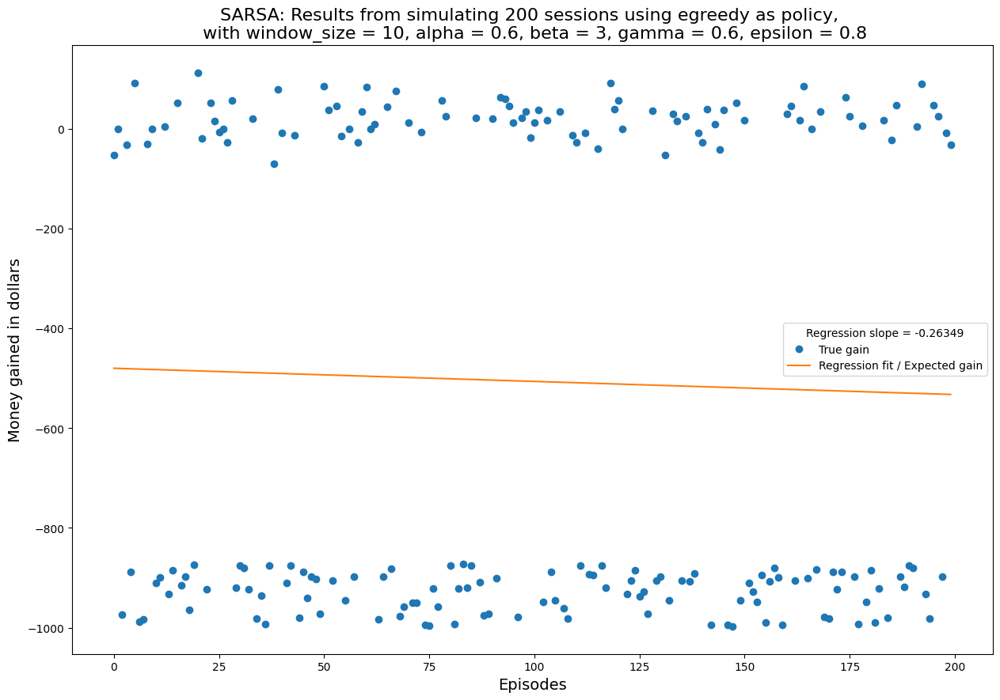

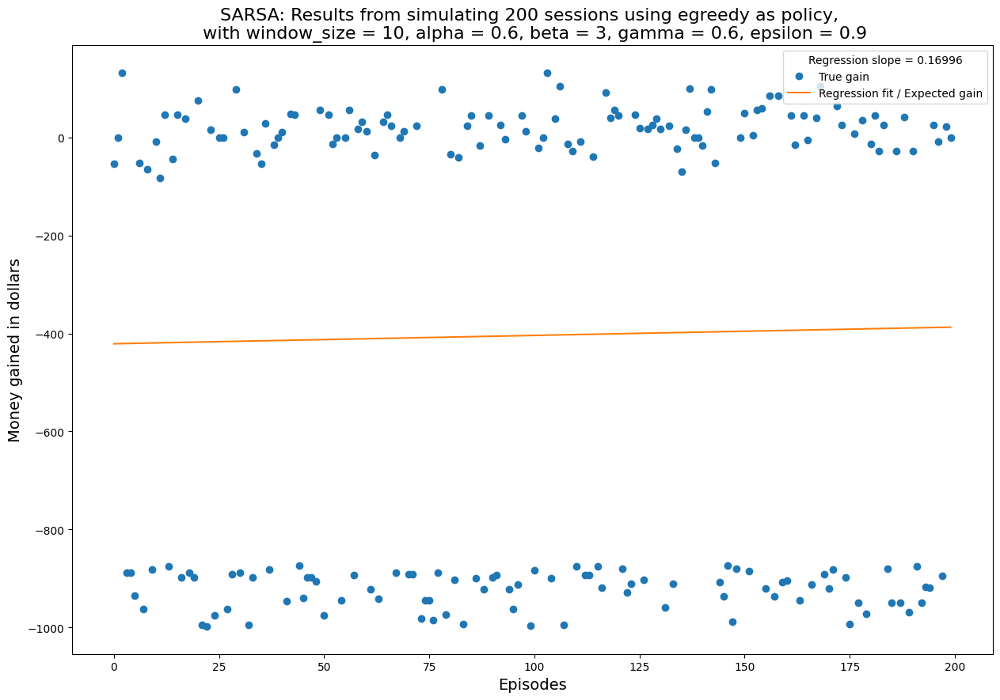

[]

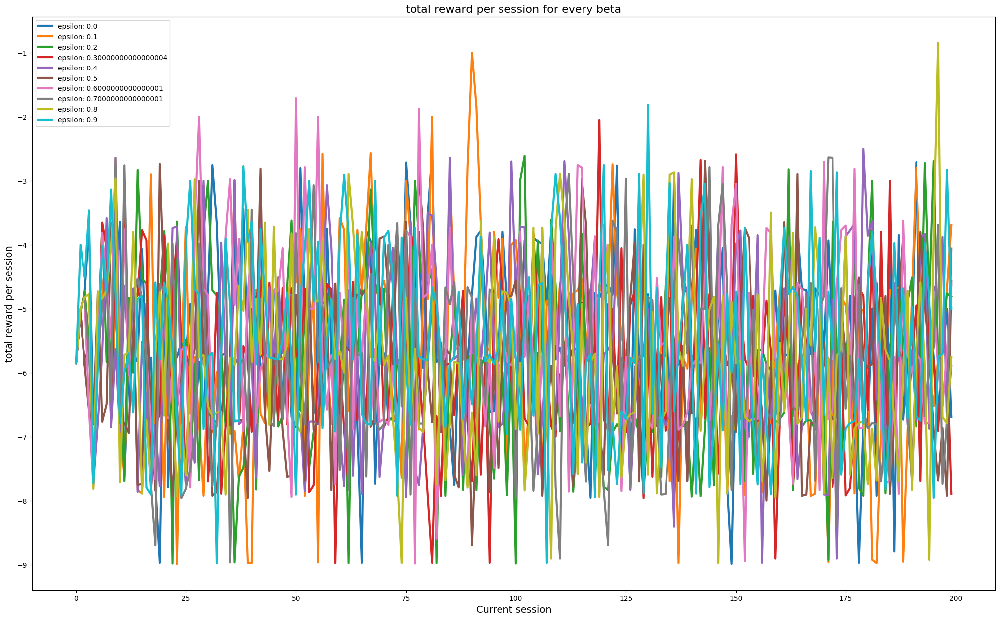

In [17]:
rewards_list = []
epsilons = []

for i in range(0, 10):
    epsilon = i*0.1
    epsilons.append(f"epsilon: {epsilon}")
    rl_agent = RL_Agent(alpha = 0.6, gamma = 0.6, sarsa=True, epsilon = epsilon, beta = 3, data=data_window, assets=1000 , policy="egreedy", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(epsilons)
ax1.plot()

#### Alpha parameter
Now let's compare the different learning rates

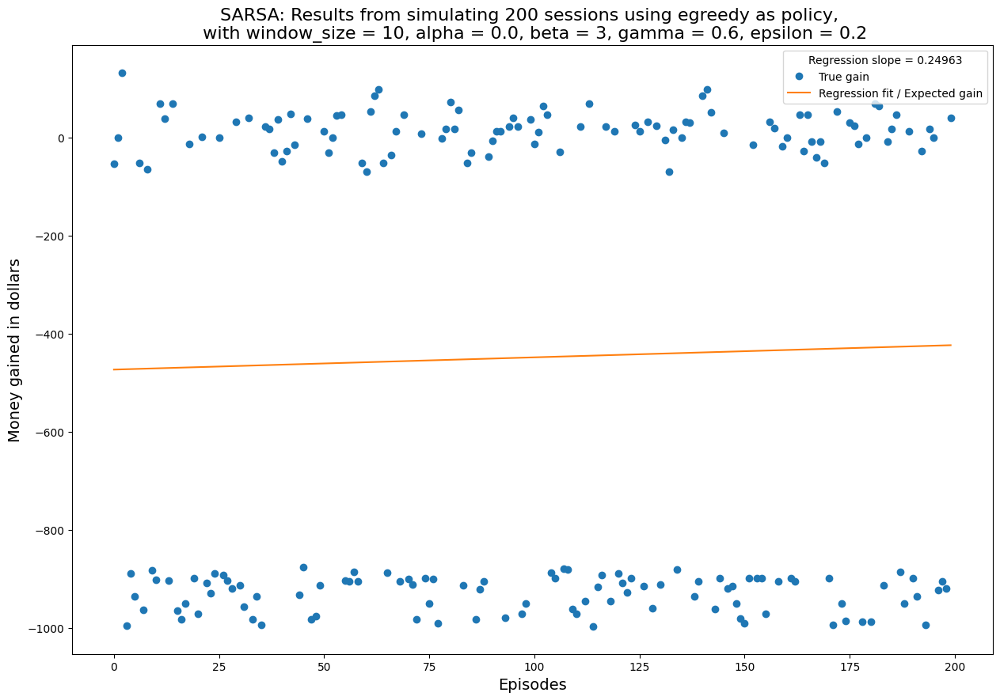

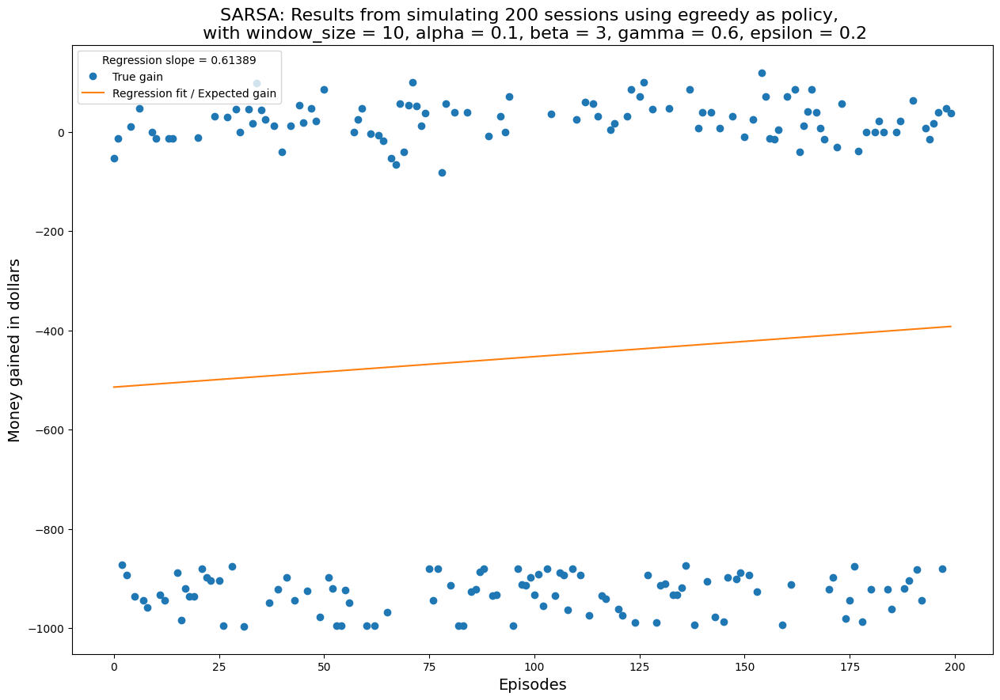

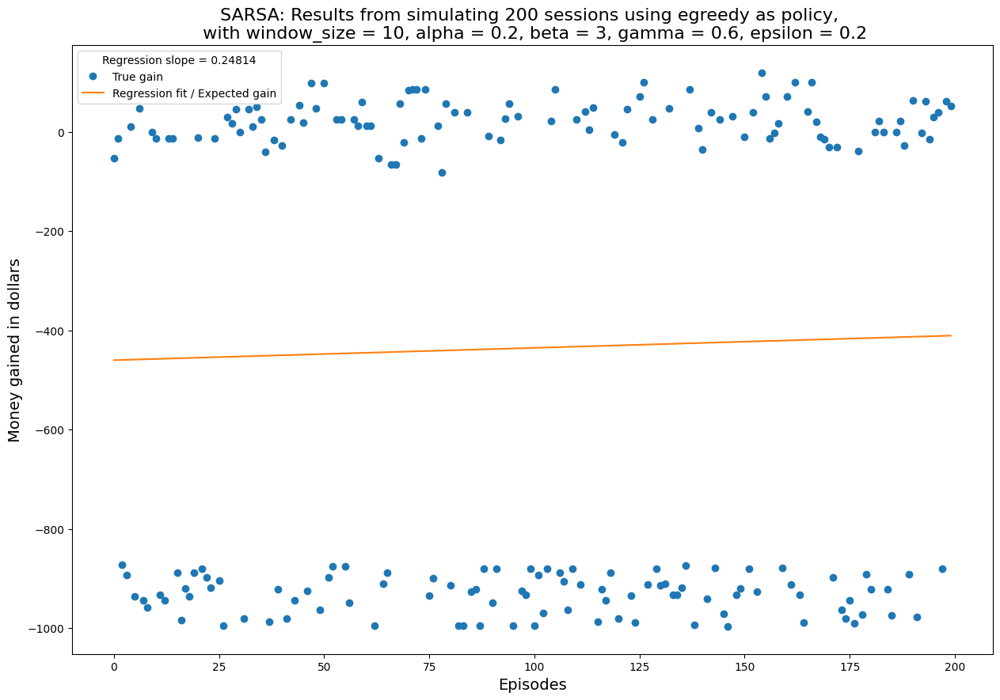

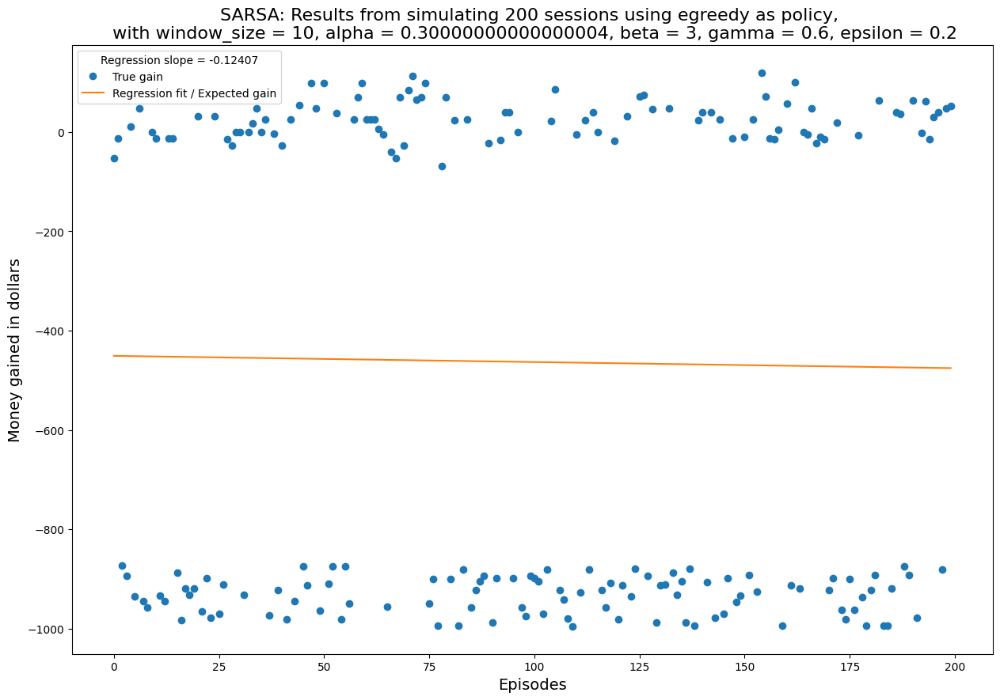

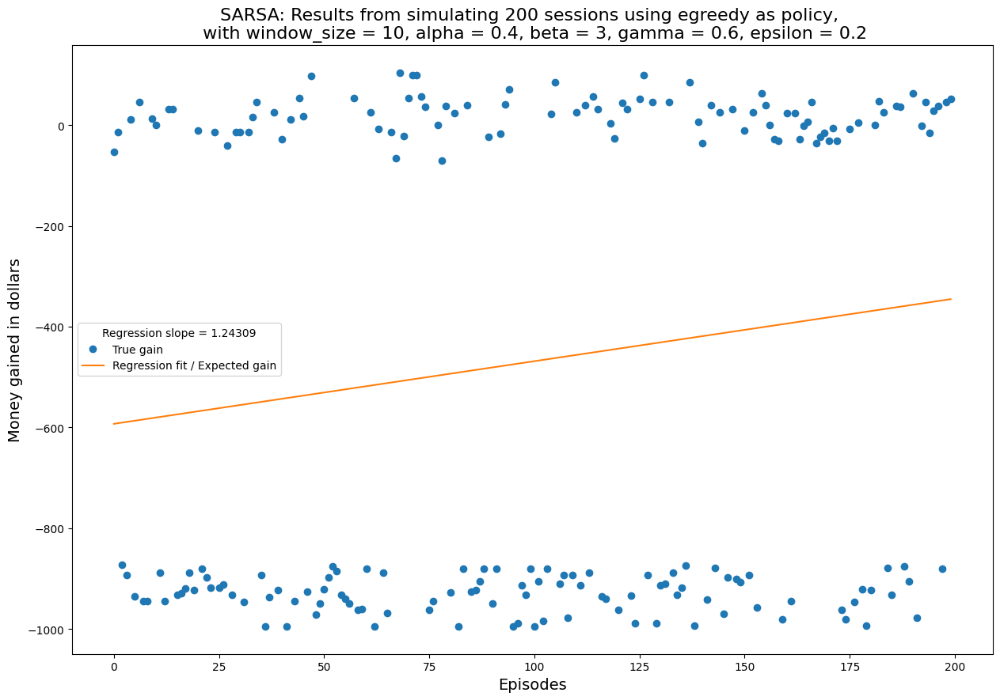

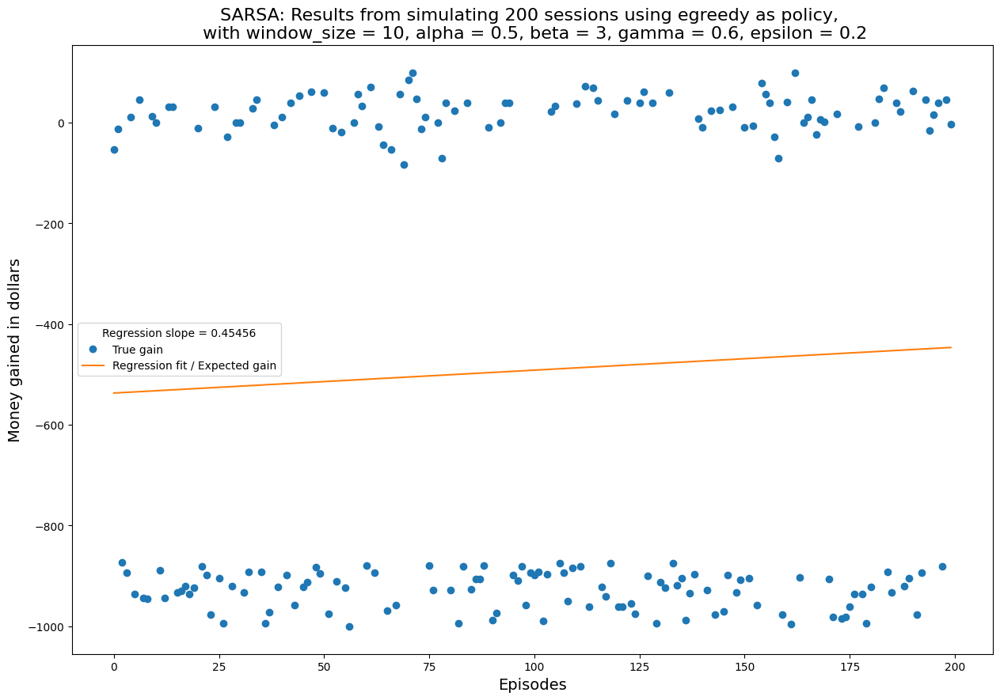

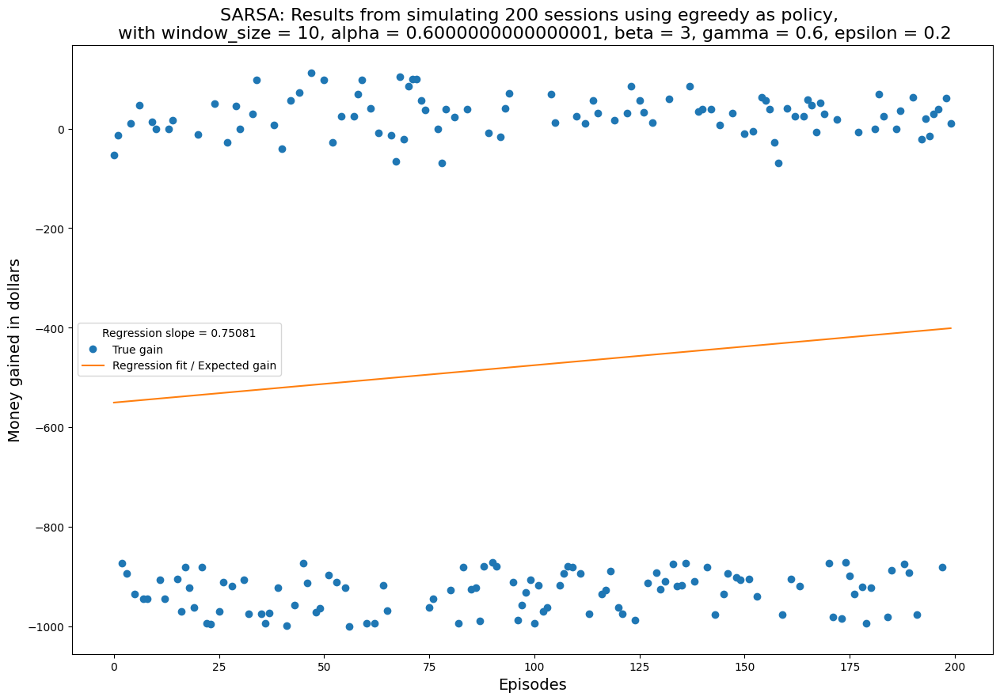

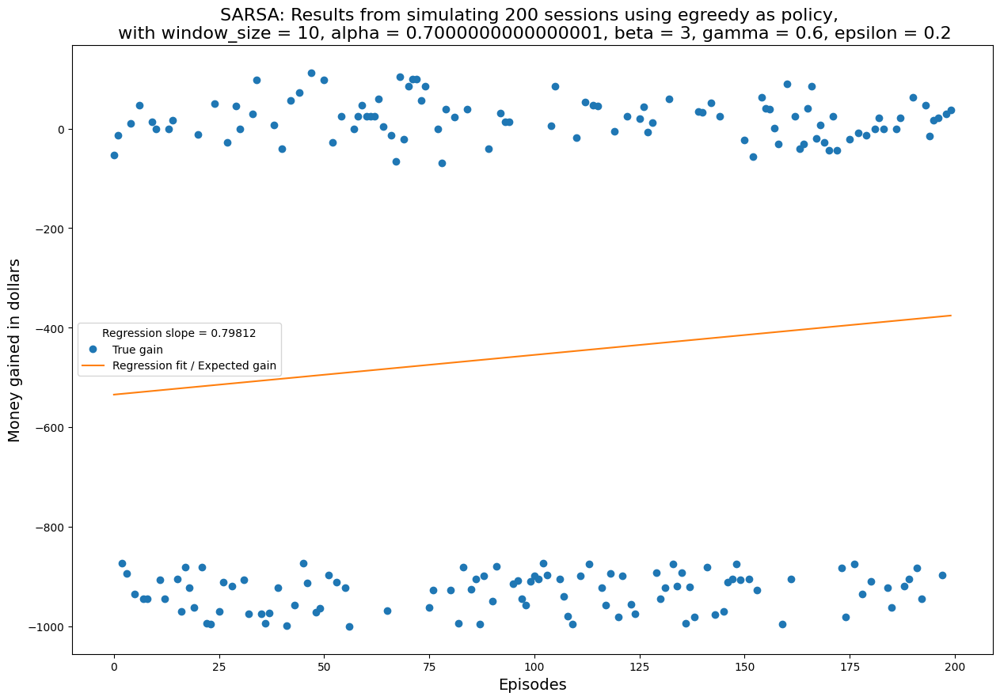

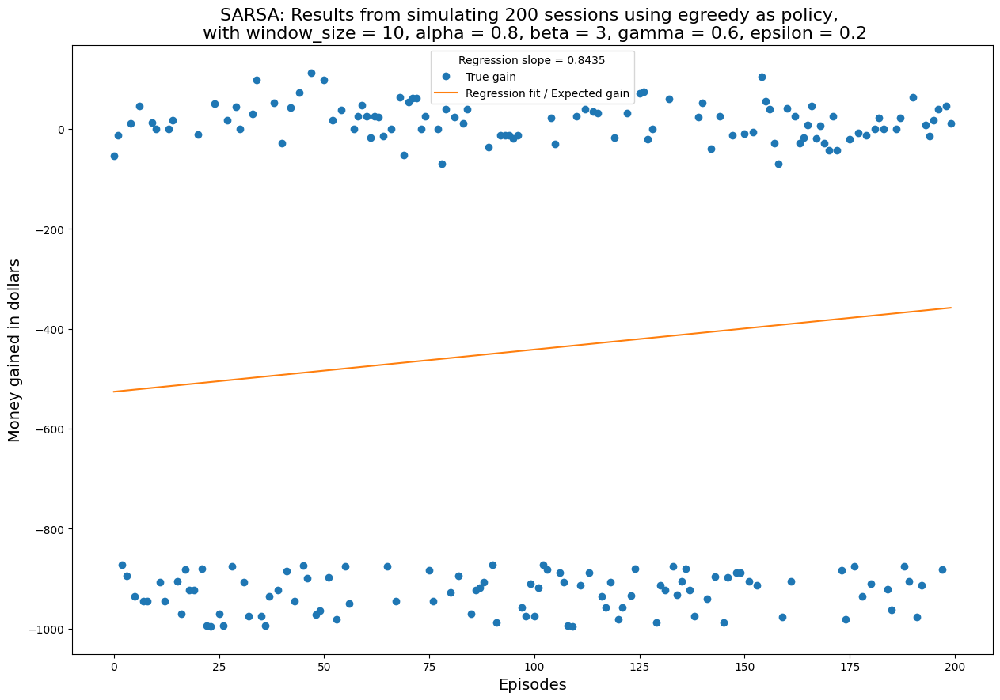

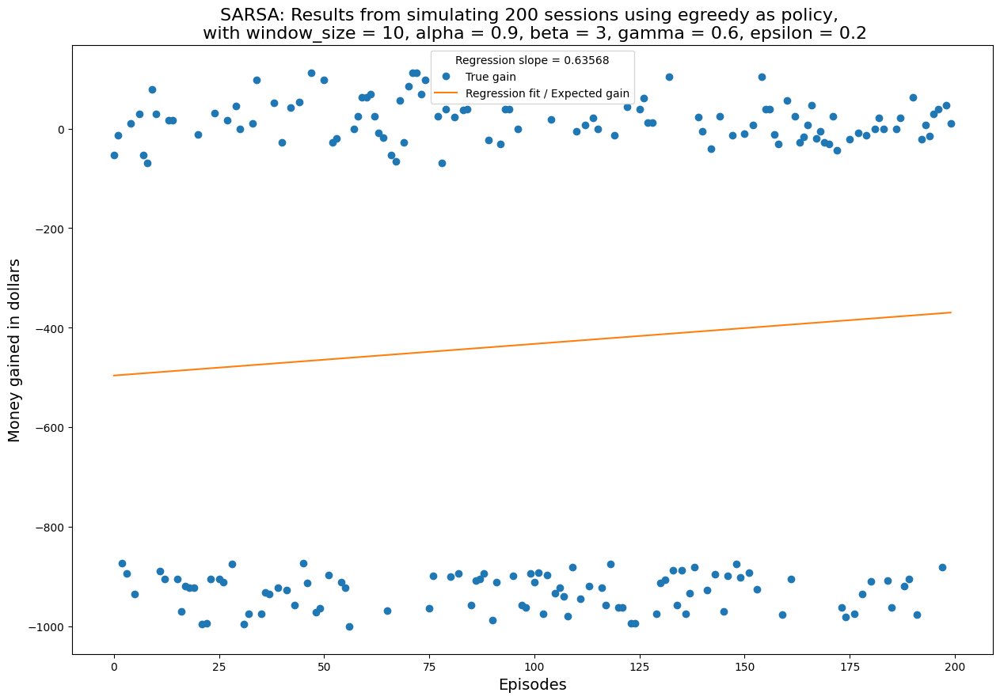

[]

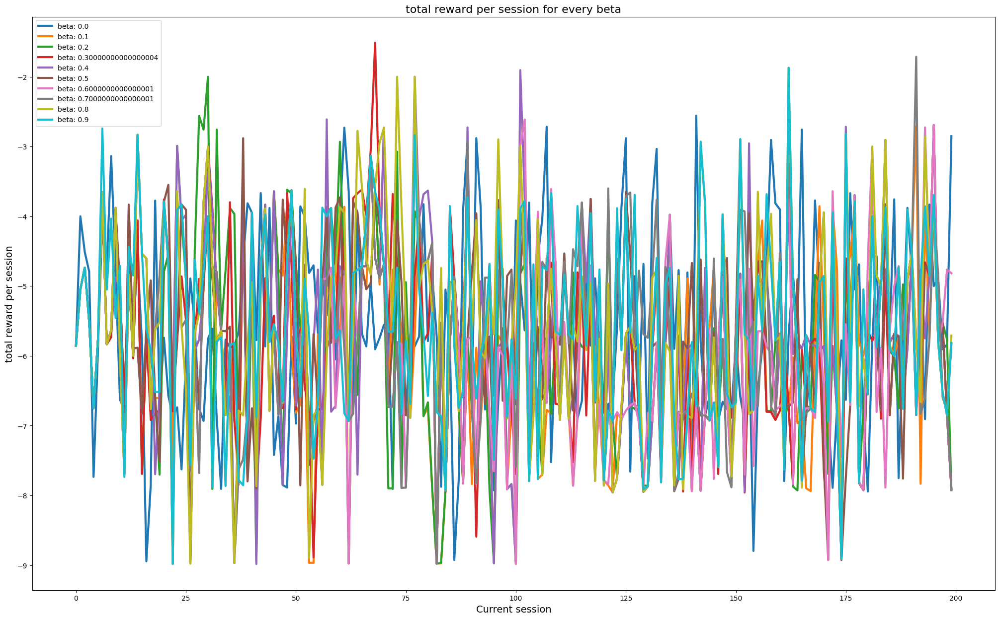

In [18]:
rewards_list = []
alphas = []

for i in range(0, 10):
    alpha = i*0.1
    alphas.append(f"beta: {alpha}")
    rl_agent = RL_Agent(alpha = alpha, gamma = 0.6, sarsa=True, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="egreedy", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(alphas)
ax1.plot()

### Gamma parameter
Now let's compare the different discount factors

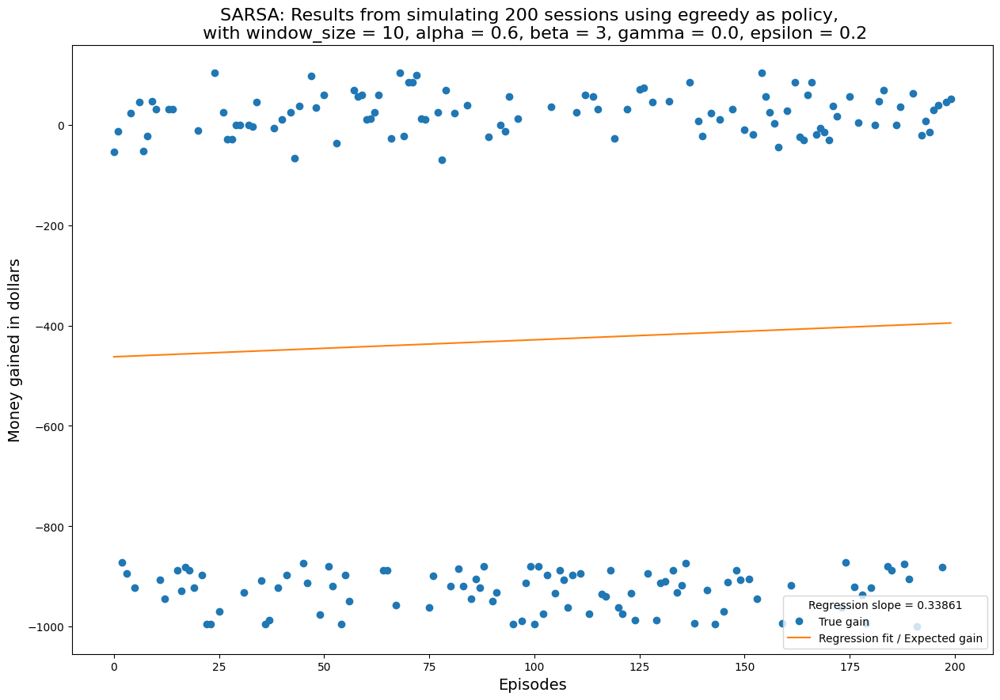

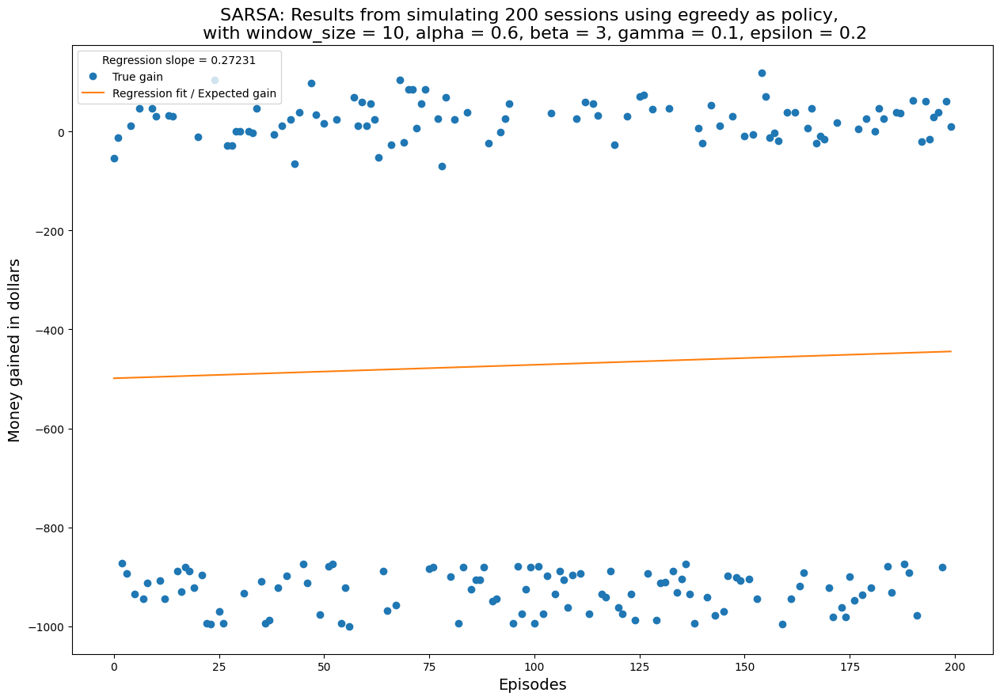

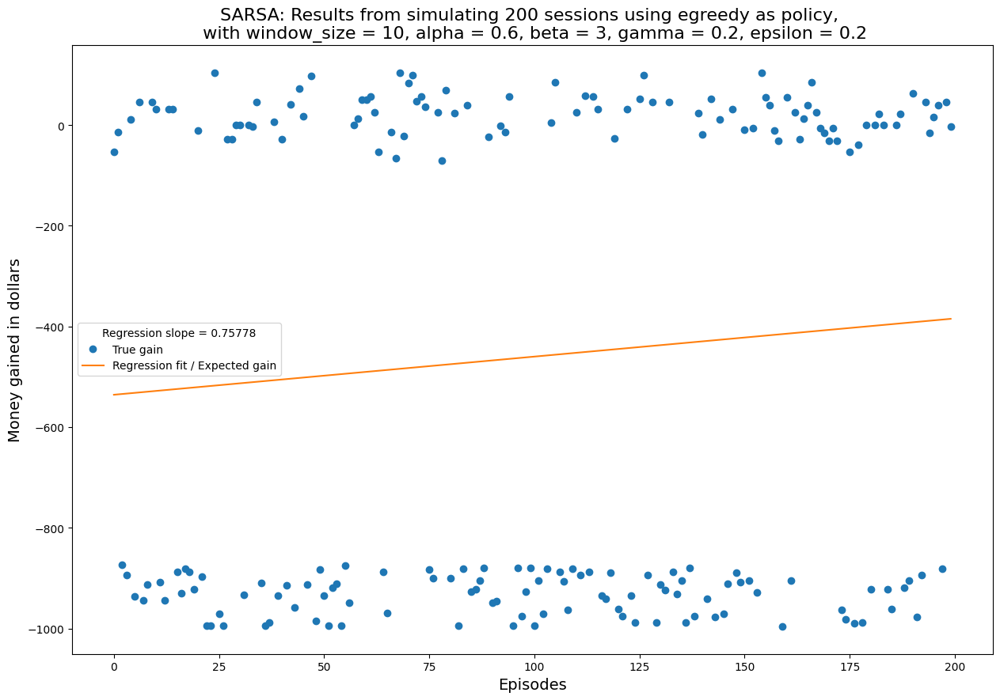

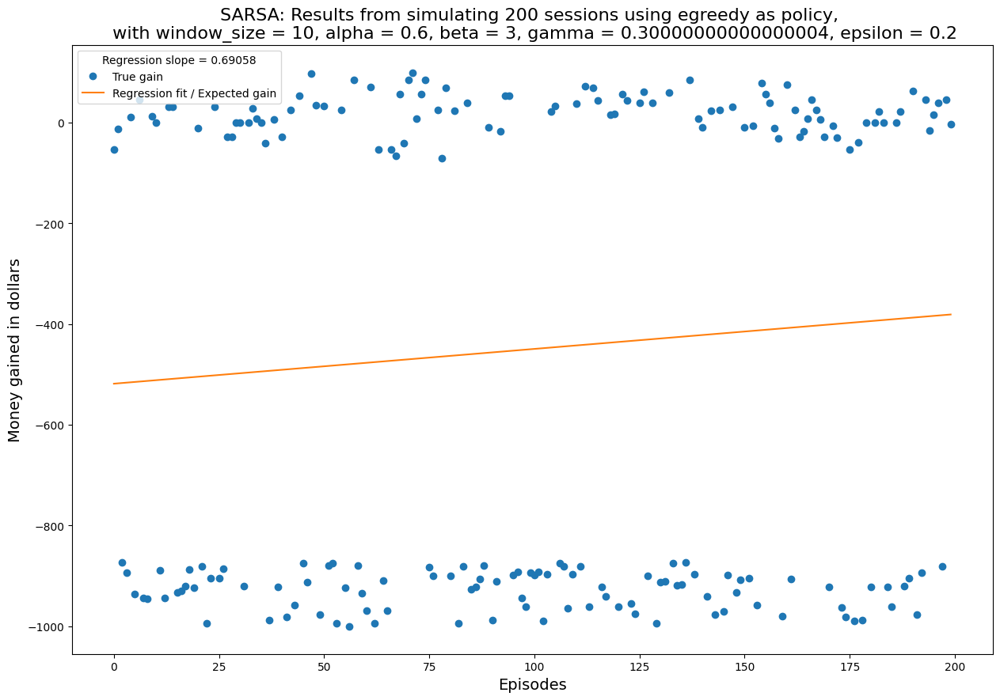

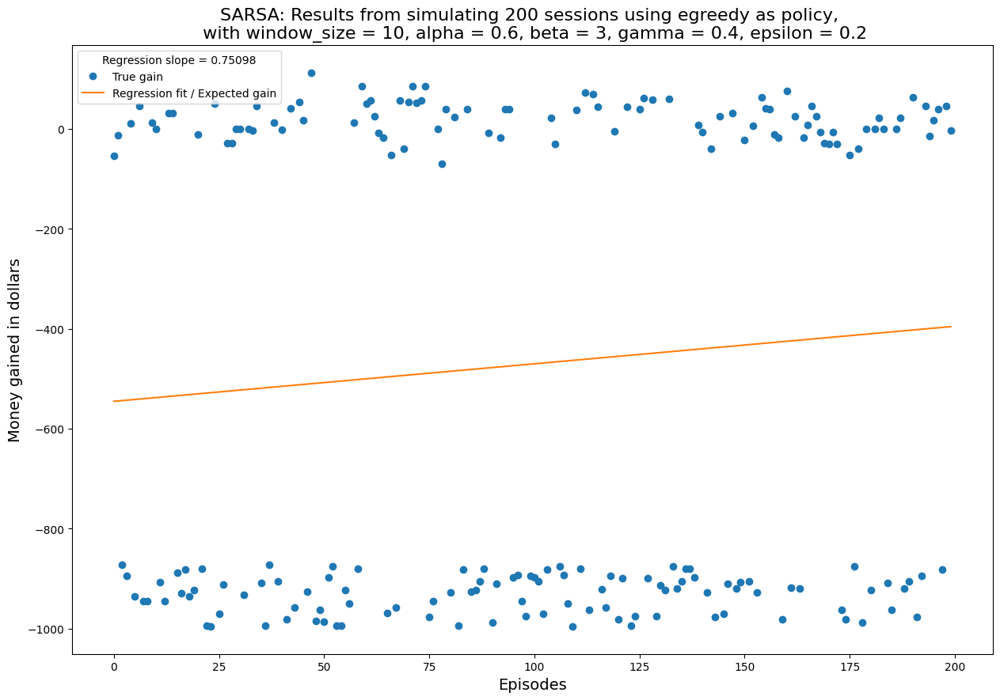

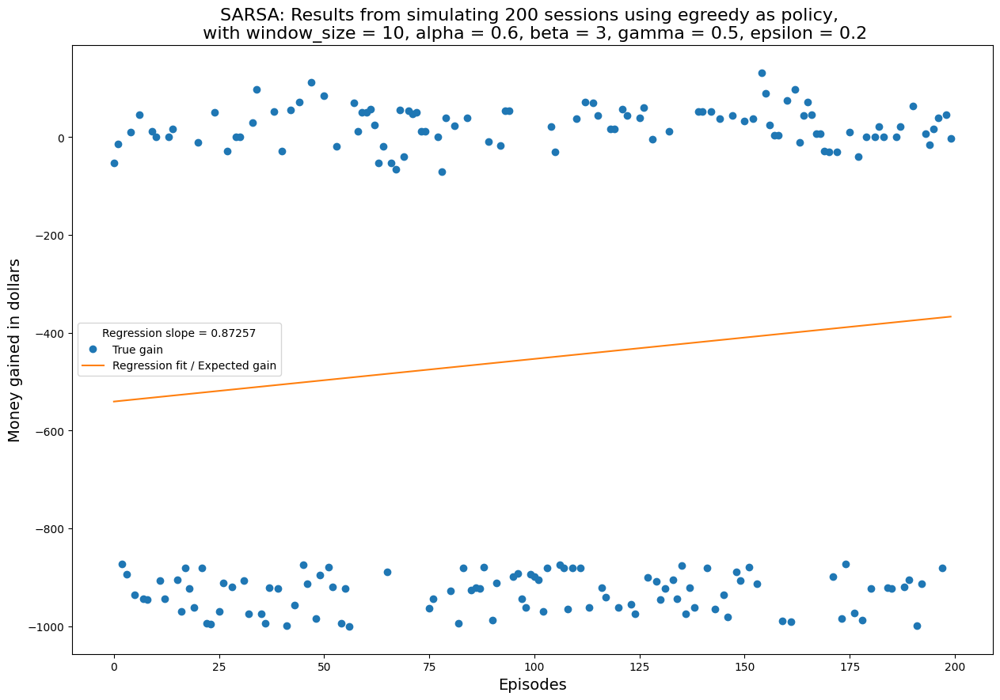

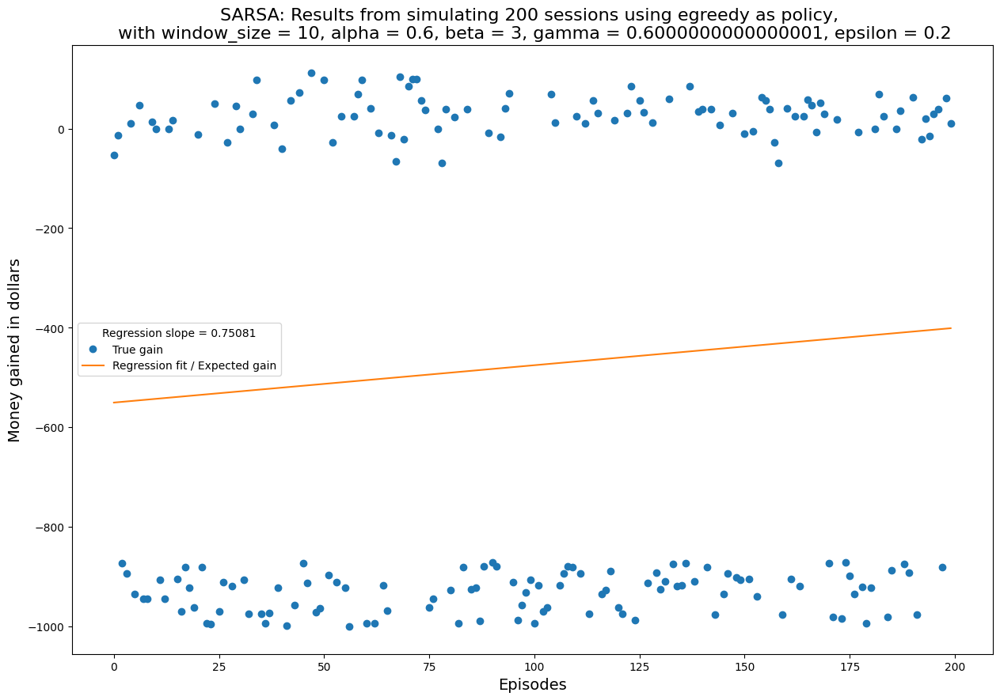

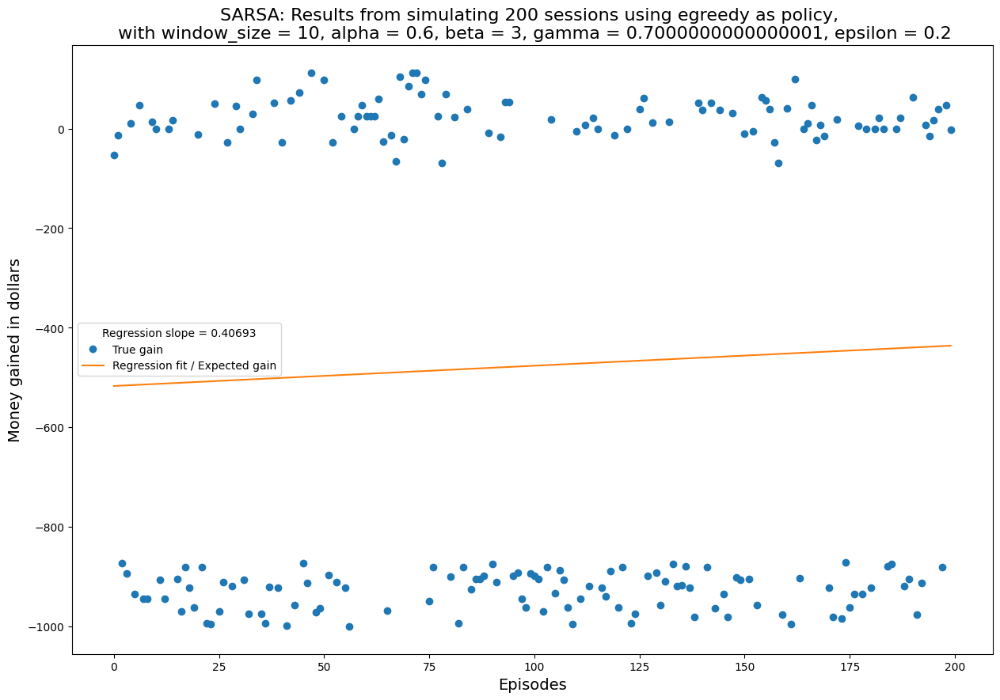

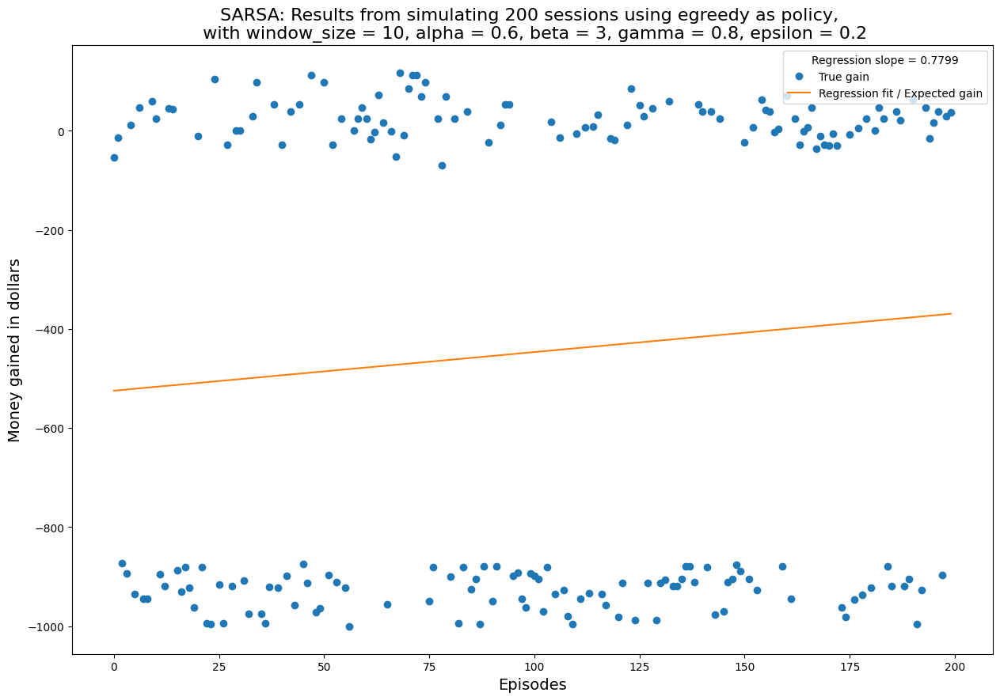

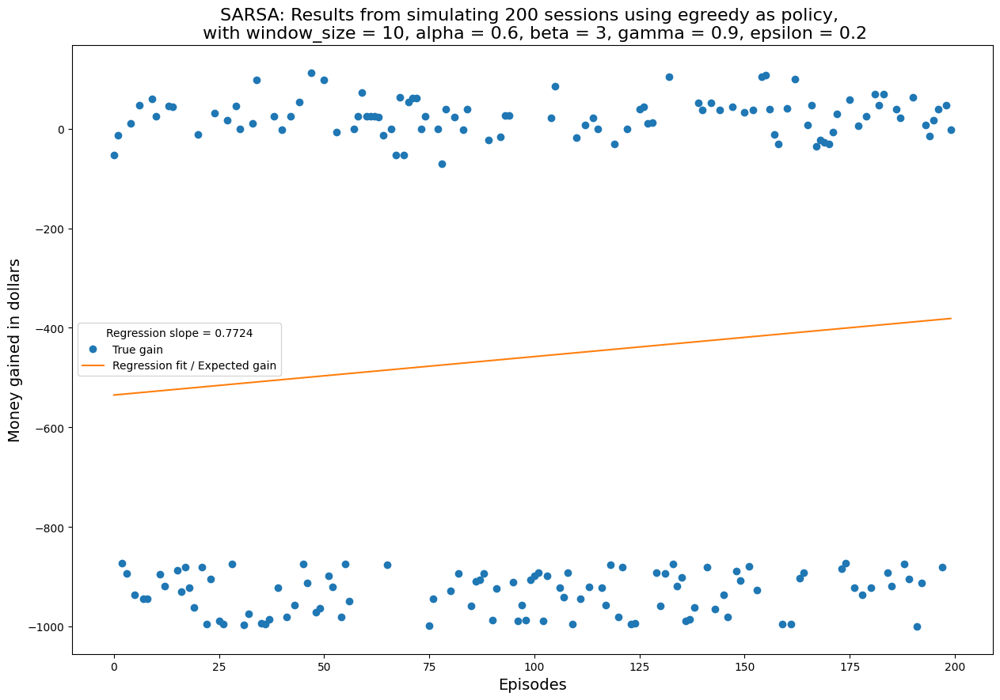

[]

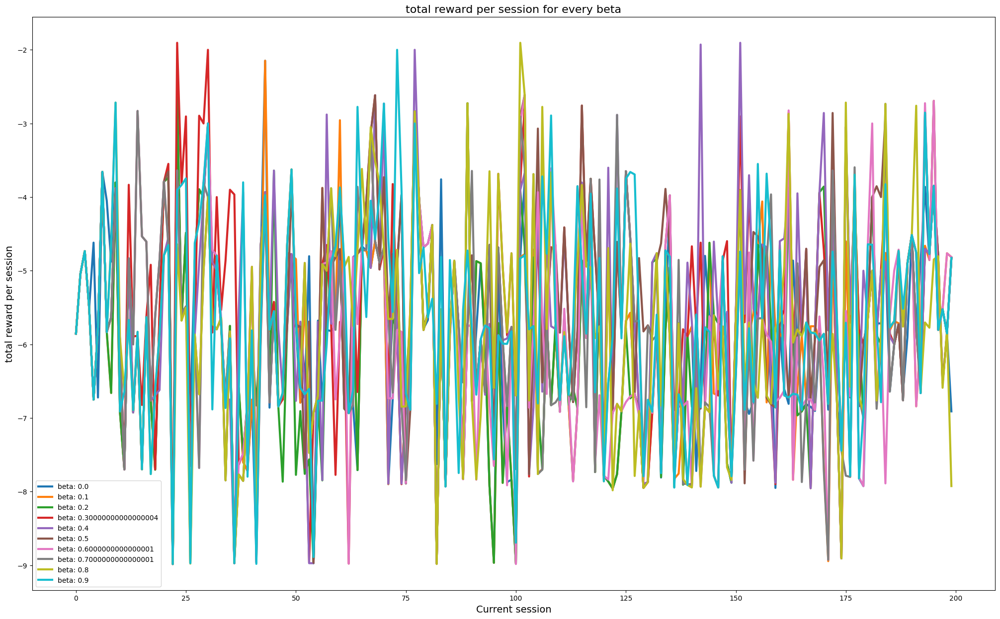

In [19]:
rewards_list = []
gammas = []

for i in range(0, 10):
    gamma = i*0.1
    gammas.append(f"beta: {gamma}")
    rl_agent = RL_Agent(alpha = 0.6, sarsa=True, gamma = gamma, epsilon = 0.2, beta = 3, data=data_window, assets=1000 , policy="egreedy", window_size = 10)
    rewards, gains, m, b = rl_agent.simulate()
    rewards_list.append(rewards)

plt.figure(figsize=(25, 15))
plt.title("total reward per session for every beta", fontsize=16)
plt.xlabel("Current session", fontsize=14)
plt.ylabel("total reward per session", fontsize=14)
ax1 = plt.subplot()

for rewards_n in rewards_list:
    line, = ax1.plot(rewards_n,linewidth=3, alpha=1)
ax1.legend(gammas)
ax1.plot()

In [20]:
# import numpy as np
# import pandas as pd
# import plotly.graph_objects as go
# import matplotlib.pyplot as plt
# import sys
# import os  # Make sure 'os' is imported
# import random
# import time
# from collections import deque
# from keras.models import Sequential
# from keras.layers import Dense
# from keras.optimizers import Adam

# # Define the Agent class
# class Agent:
#     def __init__(self, alpha, gamma, epsilon, beta, data, assets, policy, window_size):
#         self.alpha = alpha
#         self.gamma = gamma
#         self.epsilon = epsilon
#         self.beta = beta
#         self.data = data
#         self.assets = assets
#         self.policy = policy
#         self.window_size = window_size
#         self.state_size = window_size
#         self.action_size = 3  # sit, buy, sell
#         self.memory = deque(maxlen=500)
#         self.inventory = []

#         self.model = self._model()

#     def _model(self):
#         model = Sequential()
#         model.add(Dense(units=64, input_dim=self.state_size, activation="relu"))
#         model.add(Dense(units=32, activation="relu"))
#         model.add(Dense(units=8, activation="relu"))
#         model.add(Dense(self.action_size, activation="linear"))
#         model.compile(loss="mse", optimizer=Adam(learning_rate=0.001))
#         return model

#     def act(self, state):
#         state = np.reshape(state, [1, self.state_size])  # Ensure correct shape
#         if random.random() <= self.epsilon:
#             return random.randrange(self.action_size)
#         options = self.model.predict(state)
#         return np.argmax(options[0])

#     def expReplay(self, batch_size):
#         if len(self.memory) < batch_size:
#             return  # Not enough samples to perform experience replay

#         mini_batch = random.sample(self.memory, batch_size)
#         for state, action, reward, next_state, done in mini_batch:
#             target = reward
#             if not done:
#                 target = reward + self.gamma * np.amax(self.model.predict(np.reshape(next_state, [1, self.state_size]))[0])
#             target_f = self.model.predict(np.reshape(state, [1, self.state_size]))
#             target_f[0][action] = target
#             self.model.fit(np.reshape(state, [1, self.state_size]), target_f, epochs=1, verbose=0)

#         if self.epsilon > 0.01:
#             self.epsilon *= 0.995

#     def simulate(self, max_episodes=100, max_time=60):  # max_time in seconds
#         rewards = []
#         gains = []
#         episodes = min(max_episodes, 10)
#         start_time = time.time()
        
#         for episode in range(episodes):
#             if time.time() - start_time > max_time:
#                 print(f"Simulation terminated early at episode {episode} due to time limit.")
#                 break
            
#             total_reward = 0
#             state = self.data[:self.window_size]
#             for i in range(self.window_size, len(self.data)):
#                 action = self.act(state)
#                 reward = 0  # Placeholder for reward calculation
#                 next_state = self.data[i-self.window_size:i]
#                 self.memory.append((state, action, reward, next_state, False))
#                 self.expReplay(batch_size=32)
#                 state = next_state
#                 total_reward += reward
                
#             rewards.append(total_reward)
#             gains.append(total_reward)
            
#             # Optional: Save results periodically
#             if episode % 10 == 0:
#                 pd.DataFrame(gains).to_csv('simulation_gains.csv', index=False)
        
#         return rewards, gains, None, None

# # Main program
# def main():
#     # global nvda_df  # Use the global variable
        

#     # Create data window
#     data_window = np.array(nvda_df[['Close']].rolling(window=10).mean().dropna())

#     # Run simulations
#     def run_simulations(parameters, policy_type):
#         results = []
#         for param in parameters:
#             if policy_type == "softmax":
#                 beta = param
#                 agent = Agent(alpha=0.6, gamma=0.6, epsilon=0.2, beta=beta, data=data_window, assets=1000, policy="softmax", window_size=10)
#             elif policy_type == "egreedy":
#                 epsilon = param
#                 agent = Agent(alpha=0.6, gamma=0.6, epsilon=epsilon, beta=4, data=data_window, assets=1000, policy="egreedy", window_size=10)
#             else:
#                 raise ValueError("Policy type not recognized")

#             # Simulate
#             rewards, gains, m, b = agent.simulate(max_episodes=50, max_time=300)  # Limit to 50 episodes and 300 seconds
#             results.append((param, gains))
        
#         return results

#     # Define parameters
#     beta_params = [0.5 * i for i in range(6)]
#     epsilon_params = [0.1 * i for i in range(10)]

#     # Run simulations
#     softmax_results = run_simulations(beta_params, "softmax")
#     egreedy_results = run_simulations(epsilon_params, "egreedy")

#     # Plot results
#     def plot_results(results, parameter_name, title):
#         fig = go.Figure()
        
#         for param, gains in results:
#             fig.add_trace(go.Scatter(
#                 x=list(range(len(gains))),
#                 y=gains,
#                 mode='lines',
#                 name=f'{parameter_name} = {param}'
#             ))
        
#         fig.update_layout(
#             title=title,
#             xaxis_title='Episodes',
#             yaxis_title='Money Gained',
#             legend_title='Parameters'
#         )
        
#         fig.show()

#     # Visualize results
#     plot_results(softmax_results, 'Beta', 'Total Gain per Session for Different Beta Values (Softmax Policy)')
#     plot_results(egreedy_results, 'Epsilon', 'Total Gain per Session for Different Epsilon Values (E-Greedy Policy)')

# if __name__ == "__main__":
#     main()

In [21]:
# import numpy as np
# import pandas as pd
# import plotly.graph_objects as go
# import matplotlib.pyplot as plt
# import sys
# import os
# import random
# import time
# from collections import deque
# from keras.models import Sequential
# from keras.layers import Dense
# from keras.optimizers import Adam

# # Define the Agent class
# class Agent:
#     def __init__(self, alpha, gamma, epsilon, beta, data, assets, policy, window_size):
#         self.alpha = alpha
#         self.gamma = gamma
#         self.epsilon = epsilon
#         self.beta = beta
#         self.data = data
#         self.assets = assets
#         self.policy = policy
#         self.window_size = window_size
#         self.state_size = window_size
#         self.action_size = 3  # sit, buy, sell
#         self.memory = deque(maxlen=500)
#         self.inventory = []

#         self.model = self._build_model()

#     def _build_model(self):
#         model = Sequential()
#         model.add(Dense(units=64, input_dim=self.state_size, activation="relu"))
#         model.add(Dense(units=32, activation="relu"))
#         model.add(Dense(units=8, activation="relu"))
#         model.add(Dense(self.action_size, activation="linear"))
#         model.compile(loss="mse", optimizer=Adam(learning_rate=0.001))
#         return model

#     def act(self, state):
#         state = np.reshape(state, [1, self.state_size])
#         if random.random() <= self.epsilon:
#             return random.randrange(self.action_size)
#         options = self.model.predict(state)
#         return np.argmax(options[0])

#     def expReplay(self, batch_size):
#         if len(self.memory) < batch_size:
#             return

#         mini_batch = random.sample(self.memory, batch_size)
#         for state, action, reward, next_state, done in mini_batch:
#             target = reward
#             if not done:
#                 target = reward + self.gamma * np.amax(self.model.predict(np.reshape(next_state, [1, self.state_size]))[0])
#             target_f = self.model.predict(np.reshape(state, [1, self.state_size]))
#             target_f[0][action] = target
#             self.model.fit(np.reshape(state, [1, self.state_size]), target_f, epochs=1, verbose=0)

#         if self.epsilon > 0.01:
#             self.epsilon *= 0.995

#     def simulate(self, max_episodes=100, max_time=60):
#         rewards = []
#         gains = []
#         episodes = min(max_episodes, 10)
#         start_time = time.time()
        
#         for episode in range(episodes):
#             if time.time() - start_time > max_time:
#                 print(f"Simulation terminated early at episode {episode} due to time limit.")
#                 break
            
#             total_reward = 0
#             state = self.data[:self.window_size]
#             for i in range(self.window_size, len(self.data)):
#                 action = self.act(state)
#                 reward = 0
#                 next_state = self.data[i-self.window_size:i]
#                 self.memory.append((state, action, reward, next_state, False))
#                 self.expReplay(batch_size=32)
#                 state = next_state
#                 total_reward += reward
                
#             rewards.append(total_reward)
#             gains.append(total_reward)
            
#             if episode % 10 == 0:
#                 pd.DataFrame(gains).to_csv('simulation_gains.csv', index=False)
        
#         return rewards, gains, None, None

# # Main program
# def main():
#     file_path = r'C:\Users\Admin\Documents\MLAI\CSCN8020\NVDA_data.csv'

#     if not os.path.exists(file_path):
#         raise FileNotFoundError(f"{file_path} not found.")

#     nvda_df = pd.read_csv(file_path)
    
#     nvda_df.columns = nvda_df.columns.str.strip()
    
#     if 'Date' not in nvda_df.columns:
#         raise KeyError(f"Expected 'Date' column not found. Available columns: {nvda_df.columns}")

#     nvda_df['Date'] = pd.to_datetime(nvda_df['Date'])
#     nvda_df = nvda_df.set_index('Date')

#     data_window = np.array(nvda_df[['Close']].rolling(window=10).mean().dropna())

#     def run_simulations(parameters, policy_type):
#         results = []
#         for param in parameters:
#             if policy_type == "softmax":
#                 beta = param
#                 agent = Agent(alpha=0.6, gamma=0.6, epsilon=0.2, beta=beta, data=data_window, assets=1000, policy="softmax", window_size=10)
#             elif policy_type == "egreedy":
#                 epsilon = param
#                 agent = Agent(alpha=0.6, gamma=0.6, epsilon=epsilon, beta=4, data=data_window, assets=1000, policy="egreedy", window_size=10)
#             else:
#                 raise ValueError("Policy type not recognized")

#             rewards, gains, m, b = agent.simulate(max_episodes=50, max_time=300)
#             results.append((param, gains))
        
#         return results

#     beta_params = [0.5 * i for i in range(6)]
#     epsilon_params = [0.1 * i for i in range(10)]

#     softmax_results = run_simulations(beta_params, "softmax")
#     egreedy_results = run_simulations(epsilon_params, "egreedy")

#     def plot_results(results, parameter_name, title):
#         fig = go.Figure()
        
#         for param, gains in results:
#             fig.add_trace(go.Scatter(
#                 x=list(range(len(gains))),
#                 y=gains,
#                 mode='lines',
#                 name=f'{parameter_name} = {param}'
#             ))
        
#         fig.update_layout(
#             title=title,
#             xaxis_title='Episodes',
#             yaxis_title='Money Gained',
#             legend_title='Parameters'
#         )
        
#         fig.show()

#     plot_results(softmax_results, 'Beta', 'Total Gain per Session for Different Beta Values (Softmax Policy)')
#     plot_results(egreedy_results, 'Epsilon', 'Total Gain per Session for Different Epsilon Values (E-Greedy Policy)')

# if __name__ == "__main__":
#     main()

In [23]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import random
import time
from collections import deque
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam

# Define the Agent class
class Agent:
    def __init__(self, alpha, gamma, epsilon, beta, data, assets, policy, window_size):
        self.alpha = alpha
        self.gamma = gamma
        self.epsilon = epsilon
        self.beta = beta
        self.data = data
        self.assets = assets
        self.policy = policy
        self.window_size = window_size
        self.state_size = window_size
        self.action_size = 3  # sit, buy, sell
        self.memory = deque(maxlen=500)
        self.inventory = []

        self.model = self._model()

    def _model(self):
        model = Sequential()
        model.add(Dense(units=64, input_dim=self.state_size, activation="relu"))
        model.add(Dense(units=32, activation="relu"))
        model.add(Dense(units=8, activation="relu"))
        model.add(Dense(self.action_size, activation="linear"))
        model.compile(loss="mse", optimizer=Adam(learning_rate=0.001))
        return model

    def act(self, state):
        state = np.reshape(state, [1, self.state_size])  # Ensure correct shape
        if random.random() <= self.epsilon:
            return random.randrange(self.action_size)
        options = self.model.predict(state)
        return np.argmax(options[0])

    def expReplay(self, batch_size):
        if len(self.memory) < batch_size:
            return  # Not enough samples to perform experience replay

        mini_batch = random.sample(self.memory, batch_size)
        for state, action, reward, next_state, done in mini_batch:
            target = reward
            if not done:
                target = reward + self.gamma * np.amax(self.model.predict(np.reshape(next_state, [1, self.state_size]))[0])
            target_f = self.model.predict(np.reshape(state, [1, self.state_size]))
            target_f[0][action] = target
            self.model.fit(np.reshape(state, [1, self.state_size]), target_f, epochs=1, verbose=0)  # Suppress output

        if self.epsilon > 0.01:
            self.epsilon *= 0.995

    def simulate(self, max_episodes=20, max_time=120):
        rewards = []
        gains = []
        episodes = min(max_episodes, 10)
        start_time = time.time()
        
        for episode in range(episodes):
            if time.time() - start_time > max_time:
                print(f"Simulation terminated early at episode {episode} due to time limit.")
                break
            
            total_reward = 0
            state = self.data[:self.window_size]
            for i in range(self.window_size, len(self.data)):
                action = self.act(state)
                reward = 0  # Placeholder for reward calculation
                next_state = self.data[i-self.window_size:i]
                self.memory.append((state, action, reward, next_state, False))
                self.expReplay(batch_size=32)
                state = next_state
                total_reward += reward
                
            rewards.append(total_reward)
            gains.append(total_reward)
            
            # Optional: Save results periodically
            if episode % 5 == 0:  # Less frequent saving
                pd.DataFrame(gains).to_csv('simulation_gains.csv', index=False)
        
        return rewards, gains, None, None
def main():
    # Define smaller data window
    data_window = np.array(nvda_df[['Close']].rolling(window=5).mean().dropna())  # Reduced window size

    # Run simulations
    def run_simulations(parameters, policy_type):
        results = []
        for param in parameters:
            if policy_type == "softmax":
                beta = param
                agent = Agent(alpha=0.6, gamma=0.6, epsilon=0.2, beta=beta, data=data_window, assets=1000, policy="softmax", window_size=5)  # Reduced window size
            elif policy_type == "egreedy":
                epsilon = param
                agent = Agent(alpha=0.6, gamma=0.6, epsilon=epsilon, beta=4, data=data_window, assets=1000, policy="egreedy", window_size=5)  # Reduced window size
            else:
                raise ValueError("Policy type not recognized")

            # Simulate with reduced episodes and time
            rewards, gains, m, b = agent.simulate(max_episodes=20, max_time=120)  # Reduced episodes and time
            results.append((param, gains))
        
        return results

    # Define smaller parameter ranges
    beta_params = [0.5 * i for i in range(3)]  # Fewer beta parameters
    epsilon_params = [0.1 * i for i in range(5)]  # Fewer epsilon parameters

    # Run simulations
    softmax_results = run_simulations(beta_params, "softmax")
    egreedy_results = run_simulations(epsilon_params, "egreedy")

    # Plot results
    def plot_results(results, parameter_name, title):
        fig = go.Figure()
        
        for param, gains in results:
            fig.add_trace(go.Scatter(
                x=list(range(len(gains))),
                y=gains,
                mode='lines',
                name=f'{parameter_name} = {param}'
            ))
        
        fig.update_layout(
            title=title,
            xaxis_title='Episodes',
            yaxis_title='Money Gained',
            legend_title='Parameters'
        )
        
        fig.show()

    # Visualize results with a limited number of points
    plot_results(softmax_results, 'Beta', 'Total Gain per Session for Different Beta Values (Softmax Policy)')
    plot_results(egreedy_results, 'Epsilon', 'Total Gain per Session for Different Epsilon Values (E-Greedy Policy)')

    # Evaluate the agent in the context of RL
    def evaluate_agent(agent):
        # Example of evaluating the agent's actions
        state = data_window[:5]
        action = agent.act(state)
        print(f"Action taken: {action} (0: sit, 1: buy, 2: sell)")

        reward = 0  # Replace with actual reward logic
        print(f"Reward: {reward}")

        if reward > 0:
            print("Positive reward indicates a successful action in the given state.")
        else:
            print("Negative or zero reward indicates the action was not beneficial in the given state.")

    # Example usage of evaluate_agent with the last agent created (for demonstration purposes)
    if softmax_results:
        last_agent = Agent(alpha=0.6, gamma=0.6, epsilon=0.2, beta=beta_params[-1], data=data_window, assets=1000, policy="softmax", window_size=5)  # Last agent for example
        evaluate_agent(last_agent)
    if egreedy_results:
        last_agent = Agent(alpha=0.6, gamma=0.6, epsilon=epsilon_params[-1], beta=4, data=data_window, assets=1000, policy="egreedy", window_size=5)  # Last agent for example
        evaluate_agent(last_agent)

if __name__ == "__main__":
    main()

c:\Users\Admin\Documents\MLAI\venv\venv\tensorflow_cpu\Lib\site-packages\keras\src\layers\core\dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step
1/1 ━━━━━━━━━━━━━━━

Action taken: 0 (0: sit, 1: buy, 2: sell)
Reward: 0
Negative or zero reward indicates the action was not beneficial in the given state.
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
Action taken: 0 (0: sit, 1: buy, 2: sell)
Reward: 0
Negative or zero reward indicates the action was not beneficial in the given state.
